In [20]:
import pandas as pd
import numpy as np

# For plots
import matplotlib.pyplot as plt
import seaborn as sns

# For time series
from datetime import datetime
import matplotlib.dates as mdates
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.seasonal import STL

In [21]:
ai = pd.read_csv('../data/processed/ai.csv')
meme = pd.read_csv('../data/processed/meme.csv')
rwa = pd.read_csv('../data/processed/rwa.csv')
gaming = pd.read_csv('../data/processed/gaming.csv')

In [22]:
gaming.head()

,timestamp,open,high,low,close,volume,name,symbol,id,category,marketcap,image
0,1639526400,4.744375,5.317031,2.173027,3.078208,1.480910e+06,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,5443743,https://s2.coinmarketcap.com/static/img/coins/...
1,1639612800,3.090095,3.299374,2.405868,2.605501,6.657927e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,5443743,https://s2.coinmarketcap.com/static/img/coins/...
2,1639699200,2.625207,3.096436,2.283871,2.741340,5.401045e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,5443743,https://s2.coinmarketcap.com/static/img/coins/...
3,1639785600,2.771380,3.038297,2.604262,2.720898,2.294669e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,5443743,https://s2.coinmarketcap.com/static/img/coins/...
4,1639872000,2.726673,2.815944,2.498097,2.724654,1.654344e+05,SENATE,SENATE,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,gaming,5443743,https://s2.coinmarketcap.com/static/img/coins/...


In [23]:
ai['date'] = pd.to_datetime(ai['timestamp'], unit='s')
meme['date'] = pd.to_datetime(meme['timestamp'], unit='s')
rwa['date'] = pd.to_datetime(rwa['timestamp'], unit='s')
gaming['date'] = pd.to_datetime(gaming['timestamp'], unit='s')

ai['date'].min(), meme['date'].min(), rwa['date'].min(), gaming['date'].min()

(Timestamp('2016-07-05 00:00:00'),
 Timestamp('2014-08-26 00:00:00'),
 Timestamp('2016-05-24 00:00:00'),
 Timestamp('2015-08-25 00:00:00'))

In [24]:
ai['timestamp'] = pd.to_datetime(ai['timestamp'], unit='s')
meme['timestamp'] = pd.to_datetime(meme['timestamp'], unit='s')
rwa['timestamp'] = pd.to_datetime(rwa['timestamp'], unit='s')
gaming['timestamp'] = pd.to_datetime(gaming['timestamp'], unit='s')

In [25]:
gaming.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128218 entries, 0 to 128217
Data columns (total 13 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   timestamp  128218 non-null  datetime64[ns]
 1   open       128218 non-null  float64       
 2   high       128218 non-null  float64       
 3   low        128218 non-null  float64       
 4   close      128218 non-null  float64       
 5   volume     128218 non-null  float64       
 6   name       128218 non-null  object        
 7   symbol     128218 non-null  object        
 8   id         128218 non-null  object        
 9   category   128218 non-null  object        
 10  marketcap  128218 non-null  int64         
 11  image      128218 non-null  object        
 12  date       128218 non-null  datetime64[ns]
dtypes: datetime64[ns](2), float64(5), int64(1), object(5)
memory usage: 12.7+ MB


In [26]:
def delete_negative_marketcup(df):
    negative_marketcap_coins = df.groupby('name')['marketcap'].apply(lambda x: (x <= 0).any()).sum()
    positive_marketcap_coins = df['name'].nunique() - negative_marketcap_coins
    print(f"Number of coins without: {negative_marketcap_coins}")
    print(f"Number of coins with marketcap: {positive_marketcap_coins}")


In [27]:
delete_negative_marketcup(ai)
delete_negative_marketcup(meme)
delete_negative_marketcup(rwa)
delete_negative_marketcup(gaming)

Number of coins without: 2
Number of coins with marketcap: 78
Number of coins without: 1
Number of coins with marketcap: 33
Number of coins without: 0
Number of coins with marketcap: 38
Number of coins without: 0
Number of coins with marketcap: 117


In [28]:
filtered_data_ai = ai[ai['marketcap'] > 0].copy()
filtered_data_meme = meme[meme['marketcap'] > 0].copy()
filtered_data_rwa = rwa[rwa['marketcap'] > 0].copy()
filtered_data_gaming = gaming[gaming['marketcap'] > 0].copy()

In [29]:
filtered_data_gaming.index.min(), filtered_data_ai.index.min(), filtered_data_meme.index.min(), filtered_data_rwa.index.min()

(0, 0, 0, 0)

In [30]:
def top_bottom_coins(df, n):
    top_coins = df.groupby('name').agg({'marketcap': 'max'}).nlargest(5, 'marketcap').index
    bottom_coins = df.groupby('name').agg({'marketcap': 'max'}).nsmallest(5, 'marketcap').index
    return top_coins, bottom_coins

In [31]:
def create_top_bottom(df,n):
    top, bottom = top_bottom_coins(df, n)
    return {
        'top': top,
        'bottom': bottom
    }

In [32]:
coin_ai = create_top_bottom(filtered_data_ai, 5)
coin_meme = create_top_bottom(filtered_data_meme, 5)
coin_rwa = create_top_bottom(filtered_data_rwa, 5)
coin_gaming = create_top_bottom(filtered_data_gaming, 5)

In [33]:
average_marketcap_ai = filtered_data_ai.groupby('name')['marketcap'].mean()
average_marketcap_meme = filtered_data_meme.groupby('name')['marketcap'].mean()
average_marketcap_rwa = filtered_data_rwa.groupby('name')['marketcap'].mean()
avarage_marketcap_gaming = filtered_data_gaming.groupby('name')['marketcap'].mean()

In [34]:
average_marketcap_ai

name
AIOZ Network     674519825.0
AXIS Token        41831939.0
Akash Network    666093476.0
Aleph.im          35037910.0
Arcblock         148063875.0
                    ...     
aiRight            3011867.0
dKargo            96053252.0
iExec RLC        133771526.0
inSure DeFi       98985983.0
io.net           328565570.0
Name: marketcap, Length: 78, dtype: float64

Market cap compare

In [35]:
# Paleta de colores
palette = sns.color_palette("husl", 10)

In [36]:
# Función de formato para añadir 'M' para millones y 'K' para miles
def format_value(value):
    if value >= 1_000_000:
        return f'{value / 1_000_000:.2f}M'
    elif value >= 1_000:
        return f'{value / 1_000:.2f}K'
    else:
        return f'{value:.2f}'

In [37]:
def plot_marketcap(df, state, amount, category_name, palette=palette):
    # Determinar si se buscan los valores más bajos o más altos
    if state == 0:
        top_marketcap = df.nsmallest(amount)
        title = f"Top {amount} monedas con menor Market Cap ({category_name})"
    elif state == 1:
        top_marketcap = df.nlargest(amount)
        title = f"Top {amount} monedas con mayor Market Cap ({category_name})"
    
    # Ordenar los datos para visualización en orden ascendente
    top_marketcap = top_marketcap.sort_values(ascending=False)

    # Crear el gráfico de barras
    plt.figure(figsize=(20, 8))
    bars = plt.bar(top_marketcap.index, top_marketcap.values, color=palette, edgecolor='black')

    # Añadir el título y etiquetas de ejes
    plt.title(title, fontsize=16, fontweight='bold')
    plt.xlabel('Token', fontsize=14)
    plt.ylabel('Average Market Cap', fontsize=14)
    plt.xticks(rotation=45, ha='right', fontsize=10)

    # Añadir anotaciones en cada barra con formato personalizado
    for bar in bars:
        yval = bar.get_height()
        # Usar la función format_value para formatear el texto
        plt.text(bar.get_x() + bar.get_width()/2, yval + yval * 0.02, format_value(yval), 
                ha='center', va='bottom', fontsize=10, color='black', fontweight='bold')

    # Añadir un borde al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

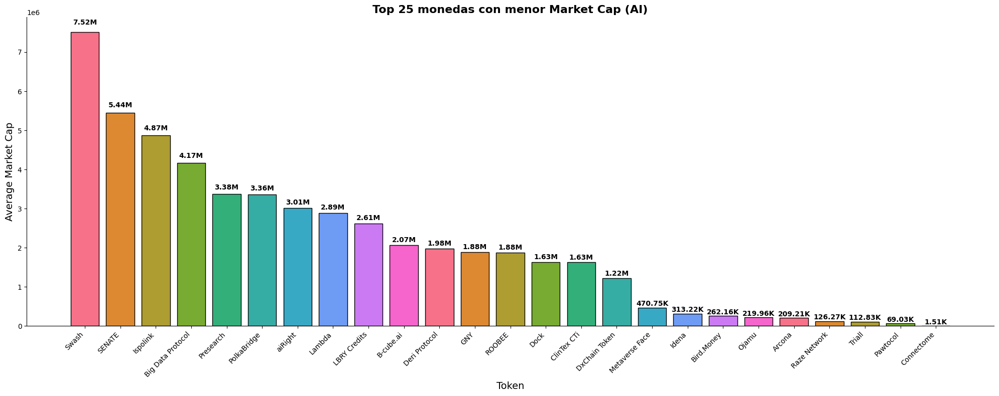

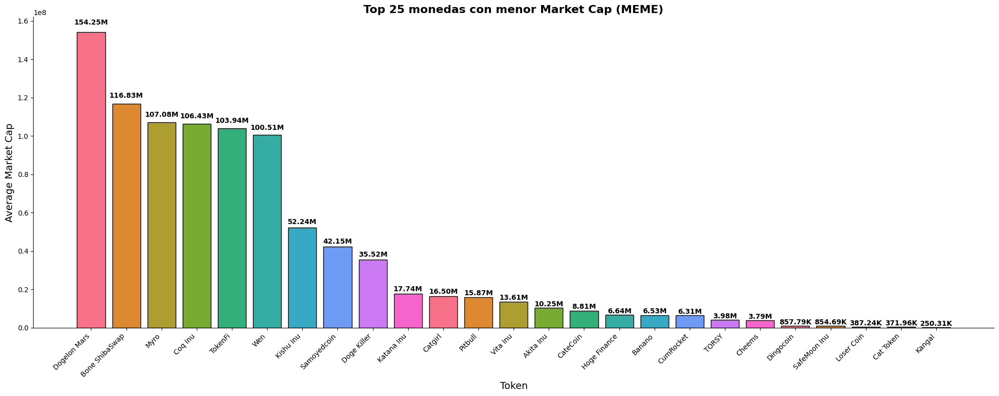

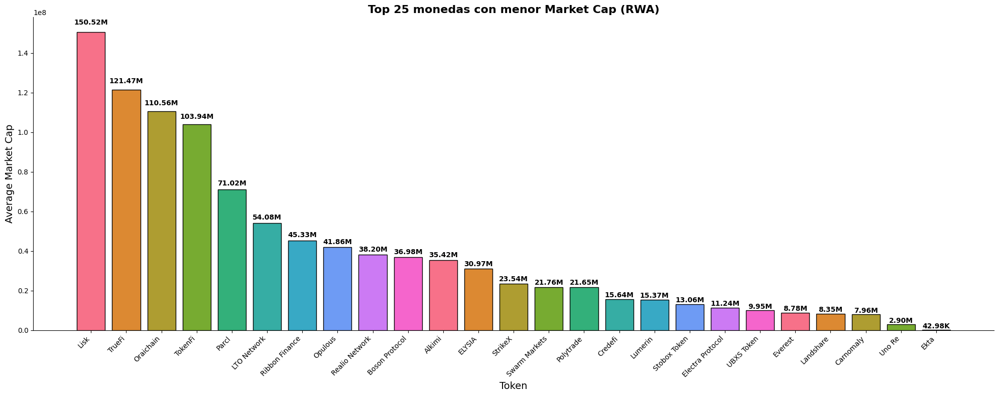

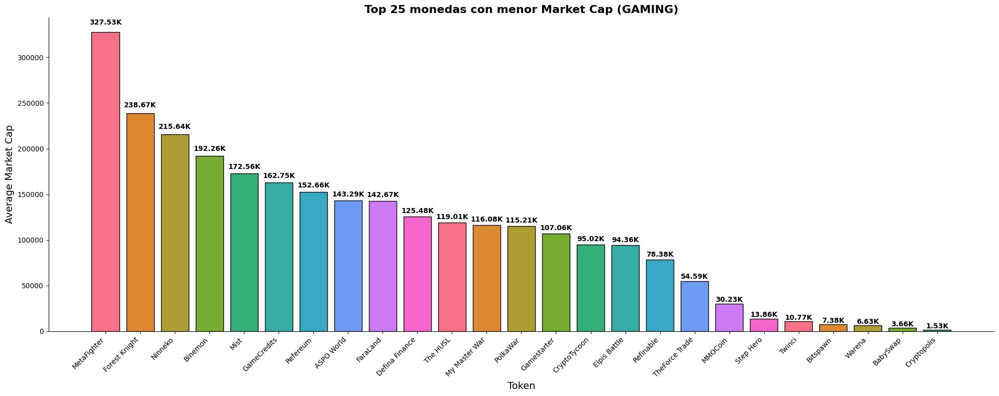

In [38]:
plot_marketcap(average_marketcap_ai, 0, 25, "AI")
plot_marketcap(average_marketcap_meme, 0, 25, "MEME")
plot_marketcap(average_marketcap_rwa, 0, 25, "RWA")
plot_marketcap(avarage_marketcap_gaming, 0, 25, "GAMING")

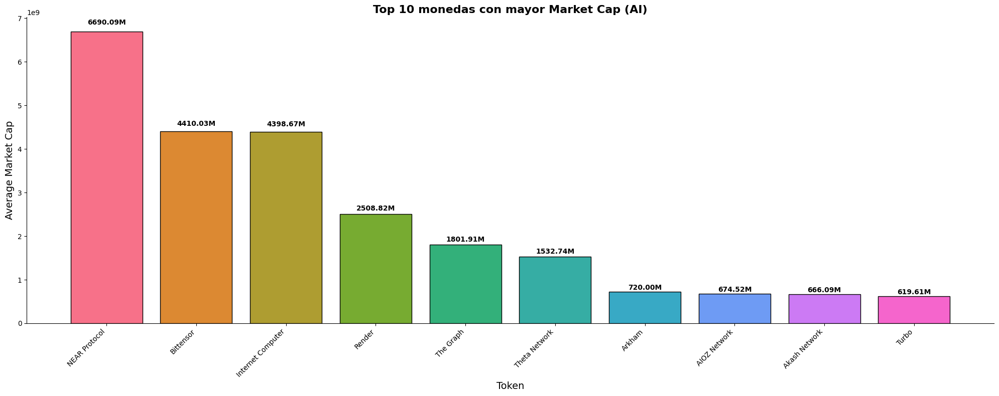

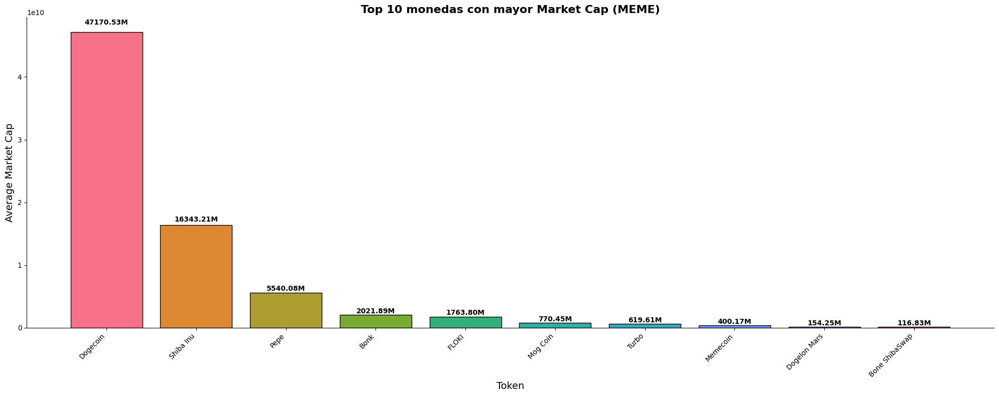

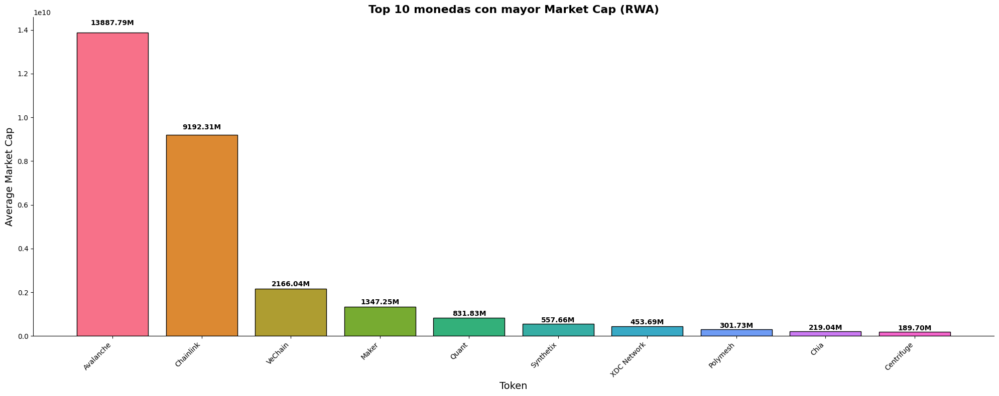

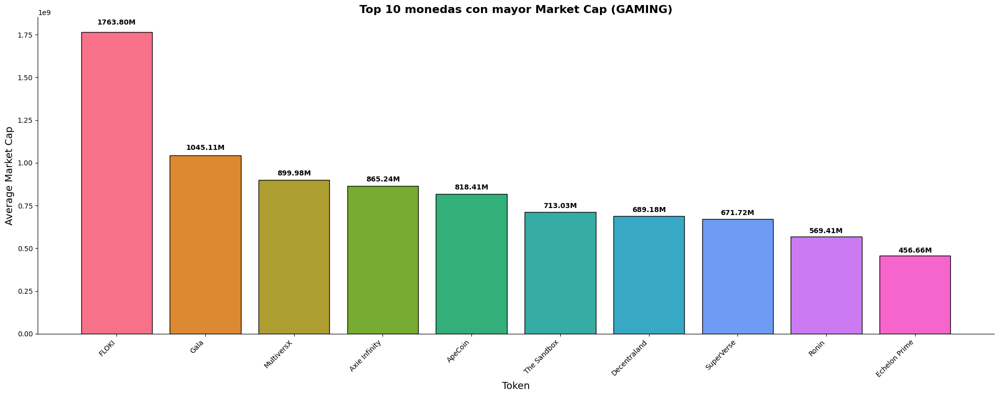

In [39]:
plot_marketcap(average_marketcap_ai, 1, 10, "AI")
plot_marketcap(average_marketcap_meme,1, 10, "MEME")
plot_marketcap(average_marketcap_rwa, 1, 10, "RWA")
plot_marketcap(avarage_marketcap_gaming, 1, 10, "GAMING")

In [40]:
def complete_crypto(top_coin, bottom_coin, df):
    top_coin = df[df['name'].isin(top_coin)].copy()
    bottom_coin = df[df['name'].isin(bottom_coin)].copy()
    top_coin.loc[:, 'timestamp'] = pd.to_datetime(top_coin['timestamp'], unit='s')
    bottom_coin.loc[:, 'timestamp'] = pd.to_datetime(bottom_coin['timestamp'], unit='s')
    return {
        'top': top_coin,
        'bottom': bottom_coin
    }

In [41]:
df_ai = complete_crypto(coin_ai['top'], coin_ai['bottom'], filtered_data_ai)
df_meme = complete_crypto(coin_meme['top'], coin_meme['bottom'], filtered_data_meme)
df_rwa = complete_crypto(coin_rwa['top'], coin_rwa['bottom'], filtered_data_rwa)
df_gaming = complete_crypto(coin_gaming['top'], coin_gaming['bottom'], filtered_data_gaming)

In [42]:
min(df_meme['bottom']['timestamp'])

Timestamp('2020-08-09 00:00:00')

Visualizacion de las 5 criptomonedas top y botton

In [43]:
def plot_price(df, title, palette=palette):
    plt.figure(figsize=(14, 8))
    
    # Agrupamos y asignamos un color diferente a cada línea
    for i, (name, group) in enumerate(df.groupby('name')):
        plt.plot(group['timestamp'], group['close'], label=name, color=palette[i % len(palette)], alpha=0.8, linewidth=1.5)
    
    # Configuración del título y etiquetas
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Token", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

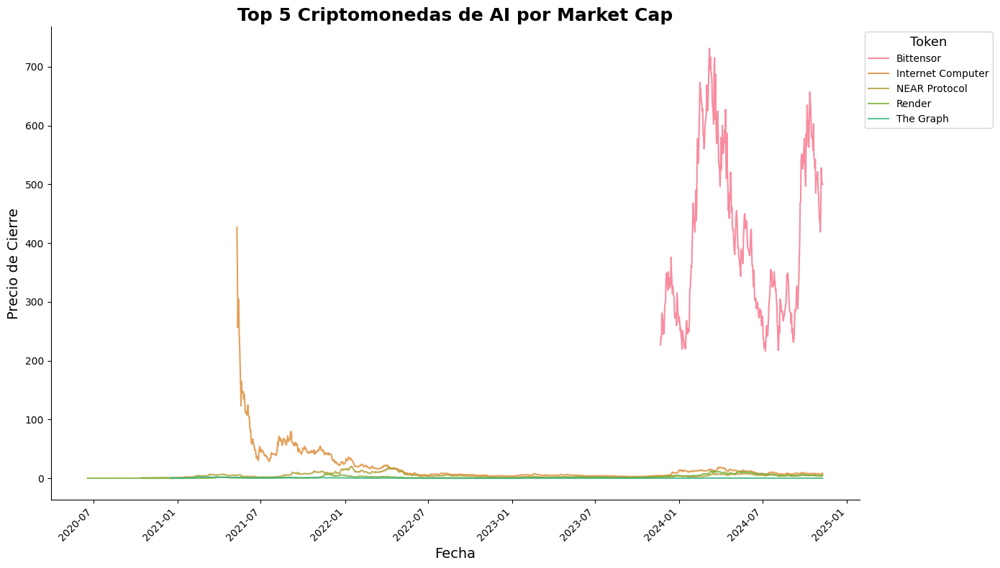

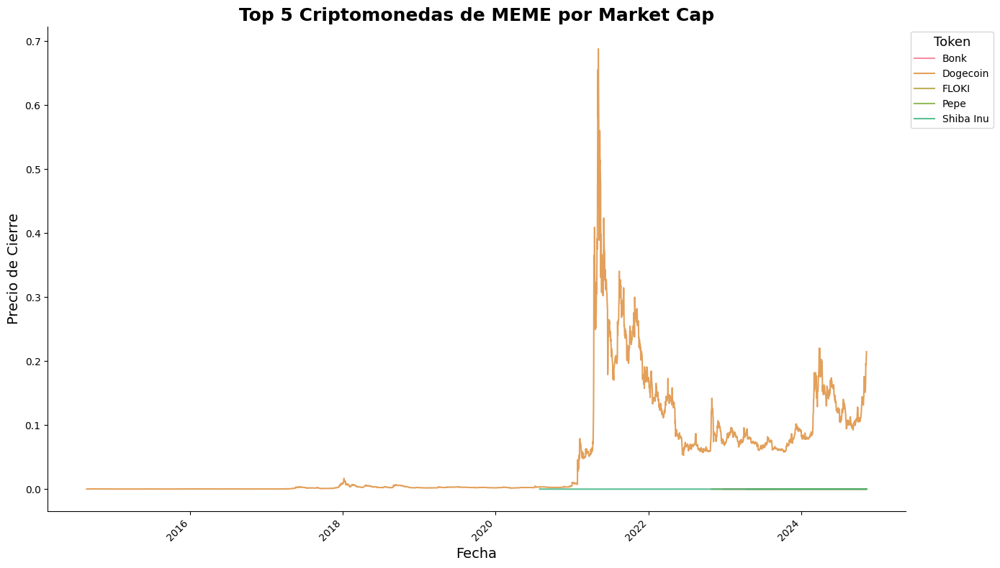

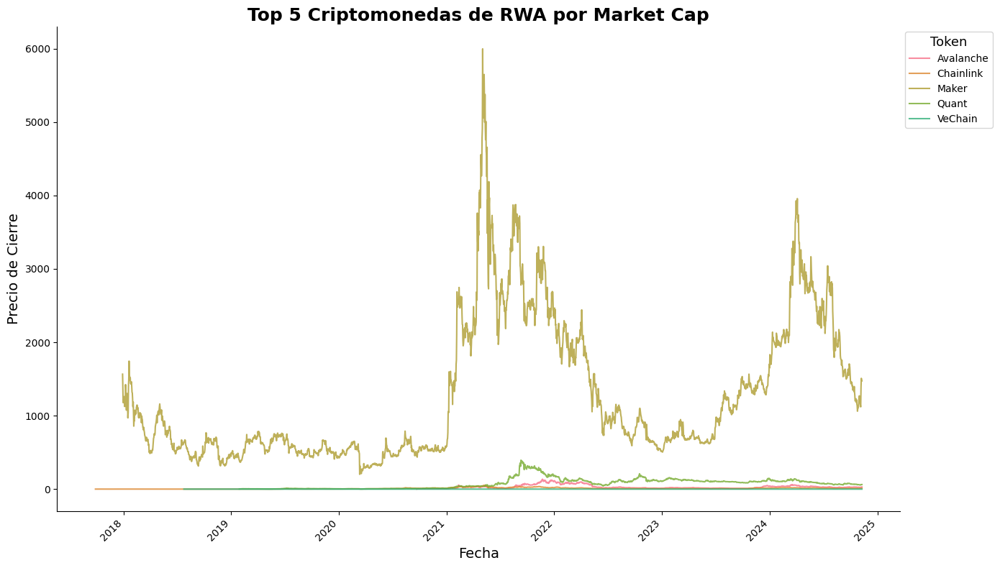

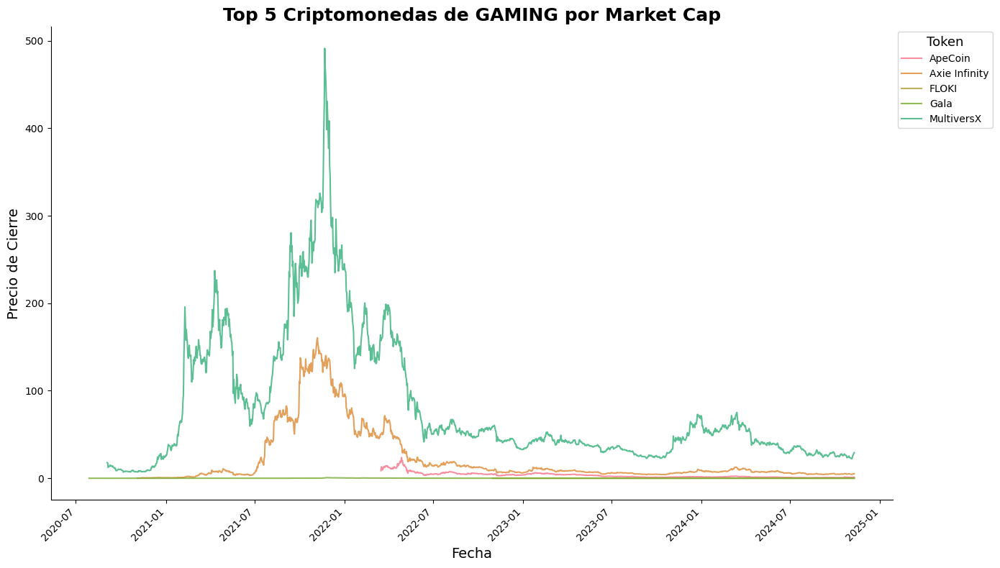

In [44]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
plot_price(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
plot_price(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
plot_price(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
plot_price(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

In [45]:
def plot_cryptos_in_range(df, start_date, end_date, title, palette=palette):
    # Filtrar los datos en el rango de fechas especificado
    cryptos_filtered = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    
    # Crear la figura
    plt.figure(figsize=(14, 8))
    
    # Graficar cada criptomoneda con un color distinto de la paleta
    for i, (name, group) in enumerate(cryptos_filtered.groupby('name')):
        plt.plot(group['timestamp'], group['close'], label=name, color=palette[i % len(palette)], alpha=0.8, linewidth=1.5)
    
    # Configuración del título y etiquetas de ejes
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Token", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

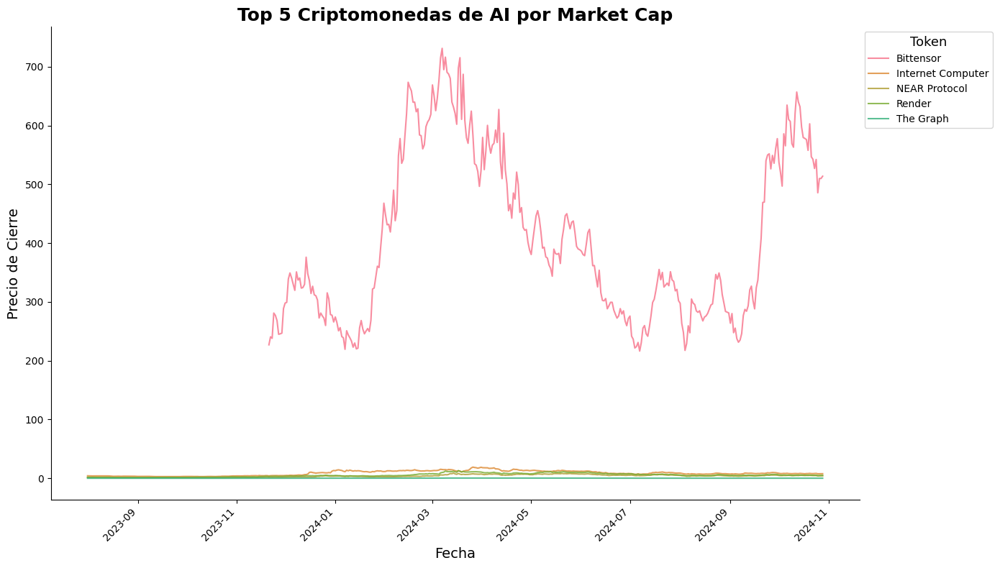

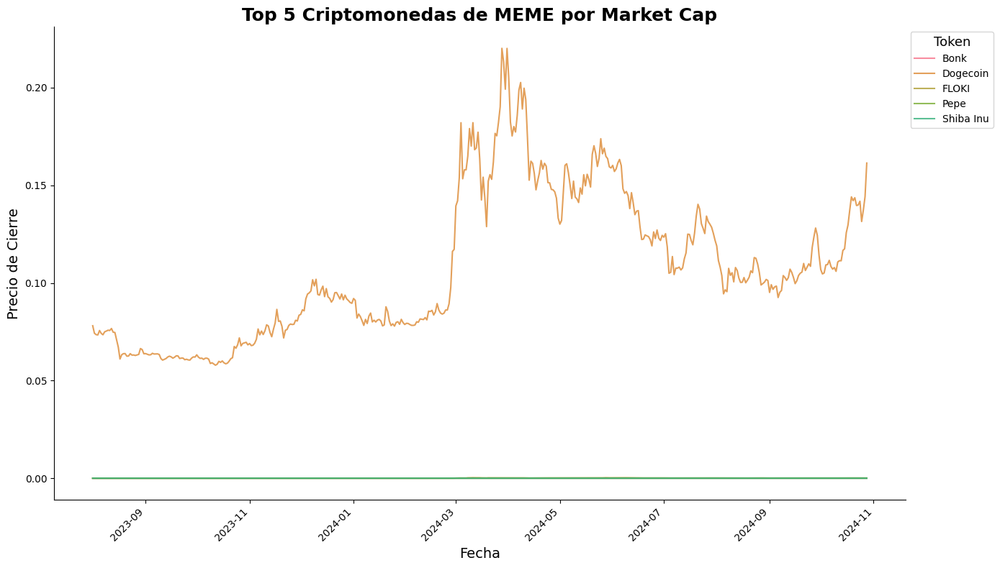

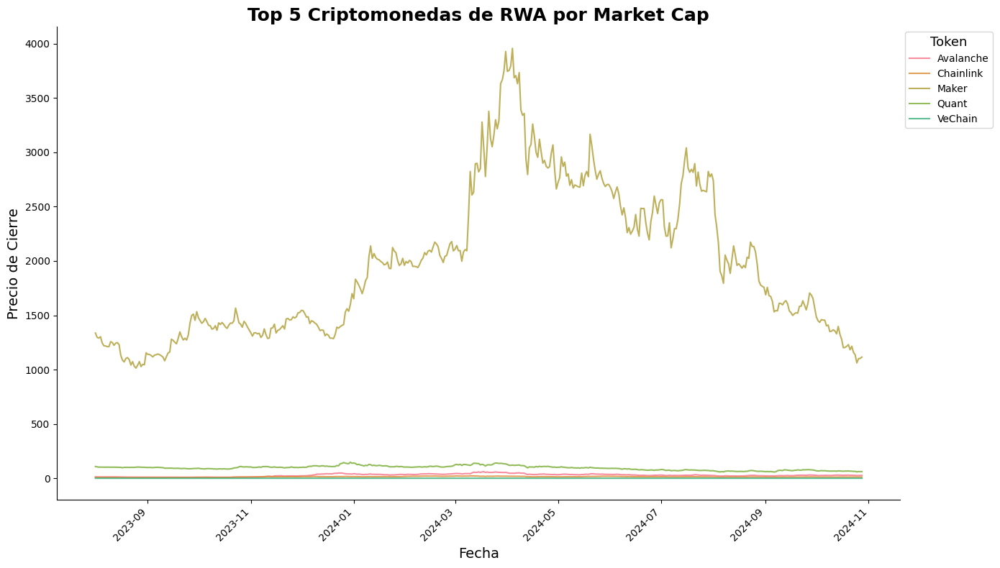

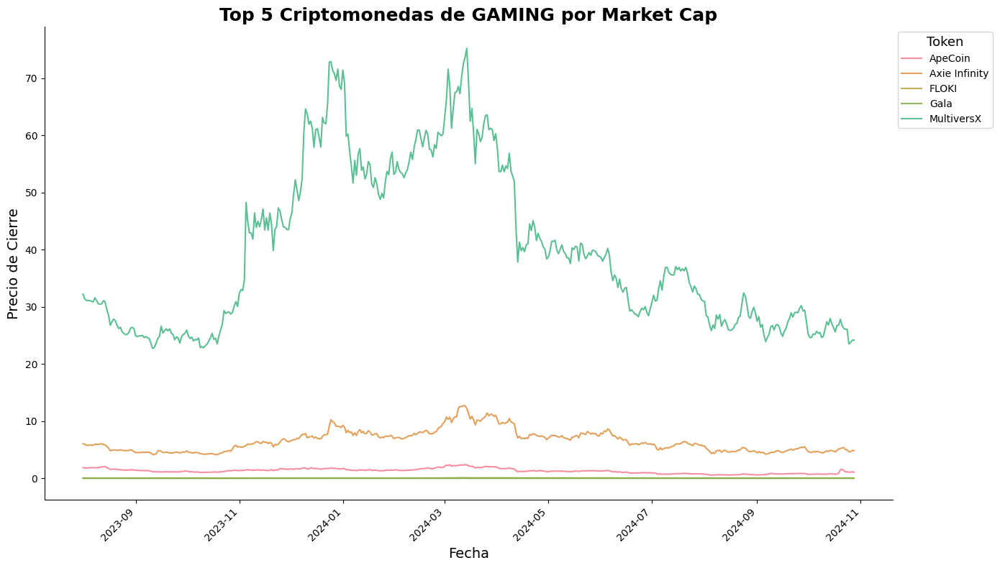

In [46]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en un rango de fechas
plot_cryptos_in_range(df_ai['top'],  datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de AI por Market Cap")
plot_cryptos_in_range(df_meme['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de MEME por Market Cap")
plot_cryptos_in_range(df_rwa['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de RWA por Market Cap")
plot_cryptos_in_range(df_gaming['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de GAMING por Market Cap")

In [47]:
def plot_date_halving(df, start_date, end_date, title, palette=palette):
    # Fecha del halving
    halving_date = datetime(2024, 4, 19)
    #halving_date_2 = datetime(2023, 4, 19)  # Segunda fecha de halving

    # Filtrar los datos en el rango de fechas especificado
    cryptos_filtered = df[(df['timestamp'] >= start_date) & (df['timestamp'] <= end_date)]
    
    # Crear la figura
    plt.figure(figsize=(14, 8))
    
    # Graficar cada criptomoneda con diferentes estilos antes y después del halving
    for i, (name, group) in enumerate(cryptos_filtered.groupby('name')):
        color = palette[i % len(palette)]
        before_halving = group[group['timestamp'] < halving_date]
        after_halving = group[group['timestamp'] >= halving_date]
        
        # Línea sólida para antes del halving
        plt.plot(before_halving['timestamp'], before_halving['close'], label=f'{name} - Antes del Halving', 
                color=color, alpha=0.8, linewidth=1.5)
        
        # Línea punteada para después del halving
        plt.plot(after_halving['timestamp'], after_halving['close'], linestyle='--', label=f'{name} - Después del Halving', 
                color=color, alpha=0.8, linewidth=1.5)
    
    # Línea vertical para la fecha del halving
    plt.axvline(x=halving_date, color='red', linestyle=':', linewidth=2, label='Fecha del Halving (19 de Abril de 2024)')
    
    # Línea vertical para la segunda fecha del halving
    #plt.axvline(x=halving_date_2, color='blue', linestyle=':', linewidth=2, label='Fecha del Segundo Halving (19 de Abril de 2023)')

    # Configuración del título y etiquetas de ejes
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)

    # Formato de la leyenda
    plt.legend(title="Leyenda", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))

    # Mejorar el formato de la fecha en el eje X
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)

    # Agregar bordes suaves al gráfico
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    # Ajustar el diseño y mostrar el gráfico
    plt.tight_layout()
    plt.show()

In [48]:
df_ai['top']['timestamp'].min(), df_meme['top']['timestamp'].min(), df_rwa['top']['timestamp'].min(), df_gaming['top']['timestamp'].min()

(Timestamp('2020-06-18 00:00:00'),
 Timestamp('2014-08-26 00:00:00'),
 Timestamp('2017-09-28 00:00:00'),
 Timestamp('2020-07-28 00:00:00'))

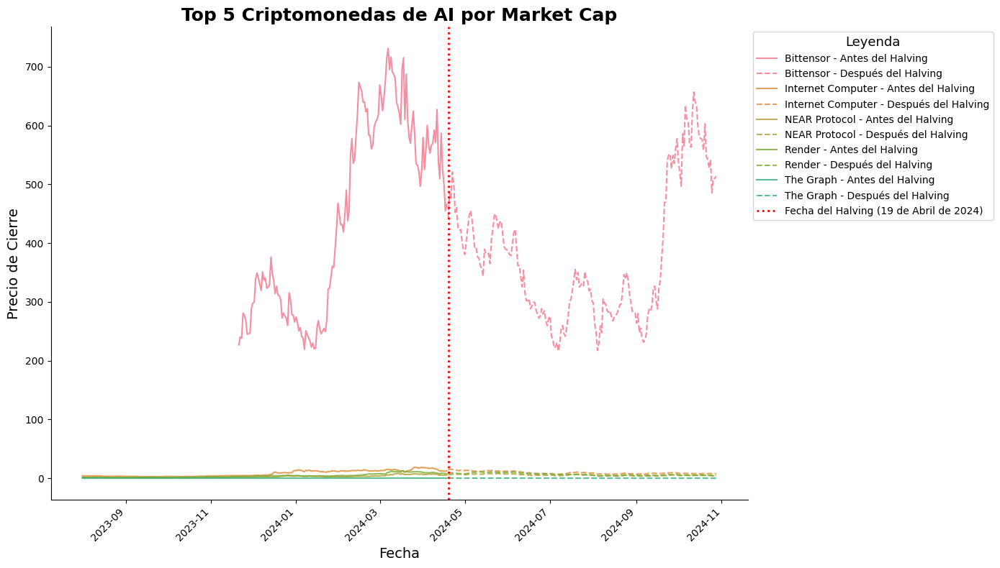

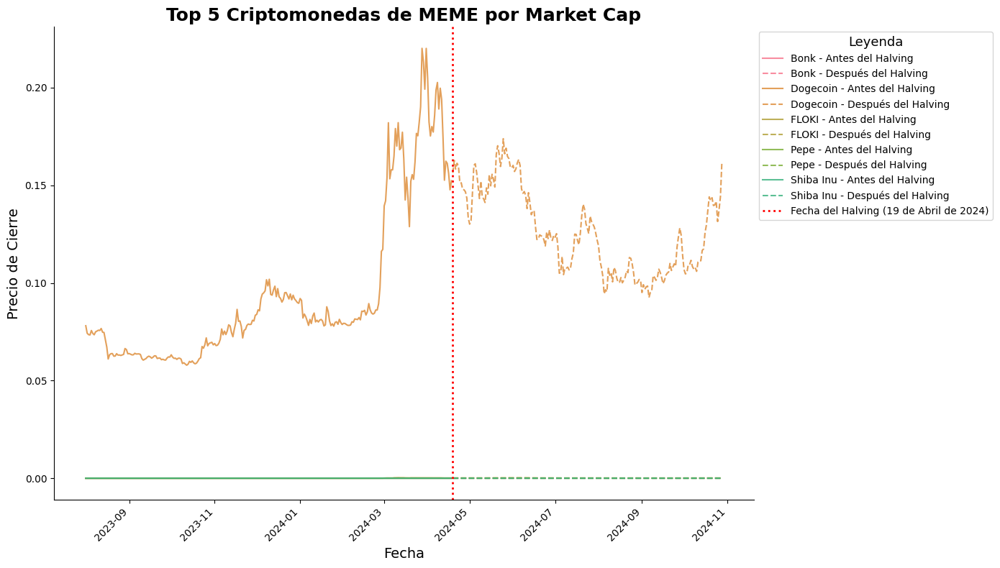

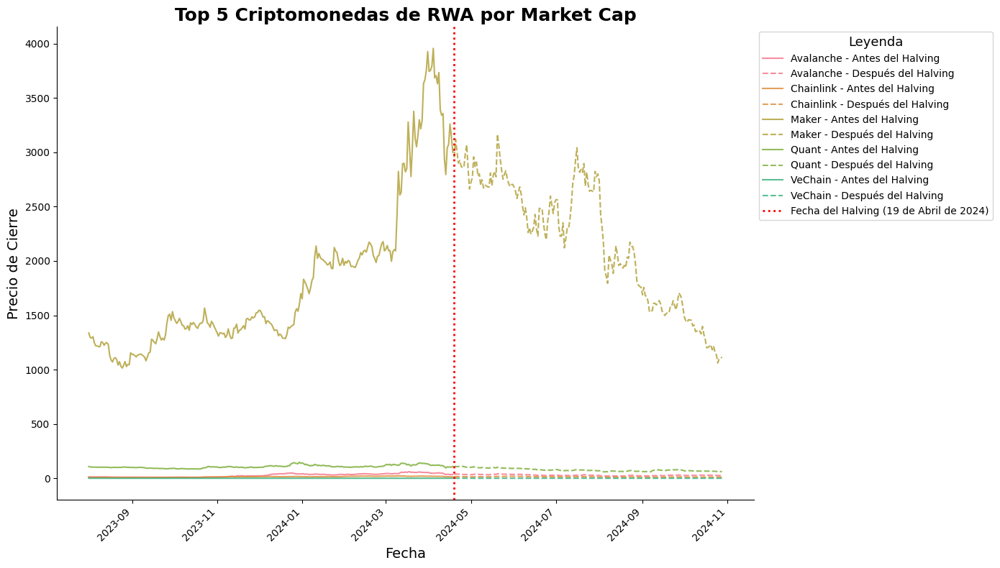

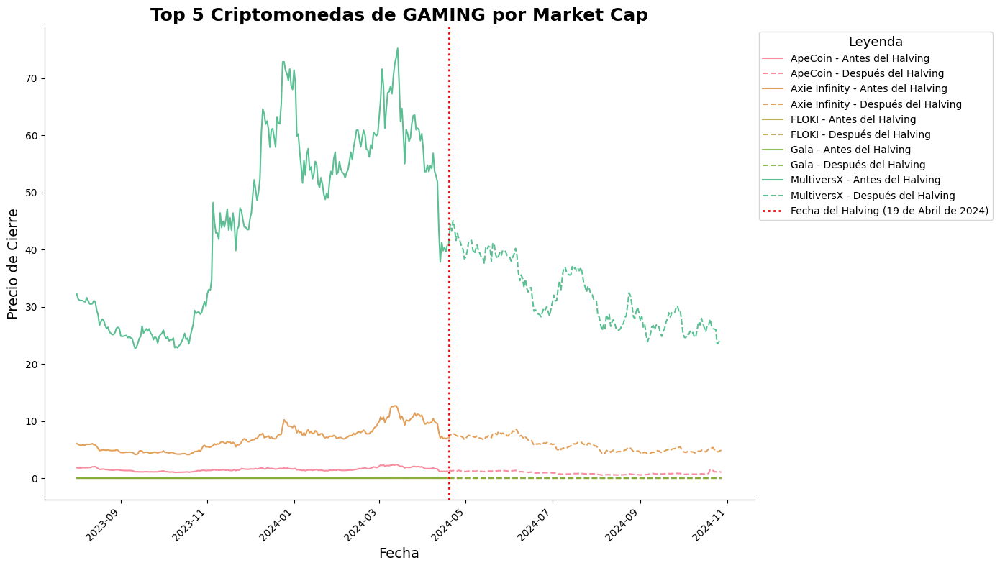

In [49]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en un rango de fechas con el evento del halving
plot_date_halving(df_ai['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de AI por Market Cap")
plot_date_halving(df_meme['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de MEME por Market Cap")
plot_date_halving(df_rwa['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de RWA por Market Cap")
plot_date_halving(df_gaming['top'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Top 5 Criptomonedas de GAMING por Market Cap")

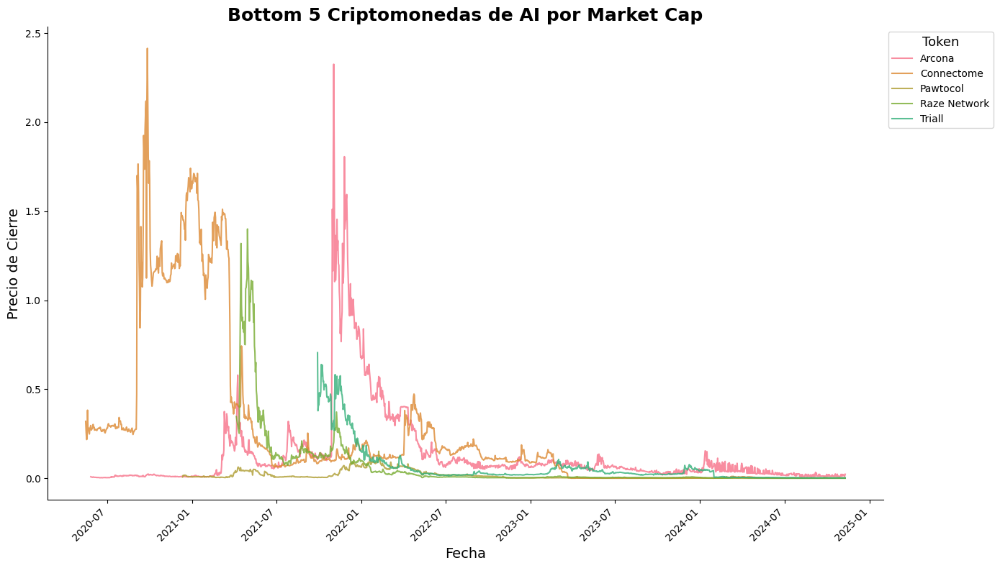

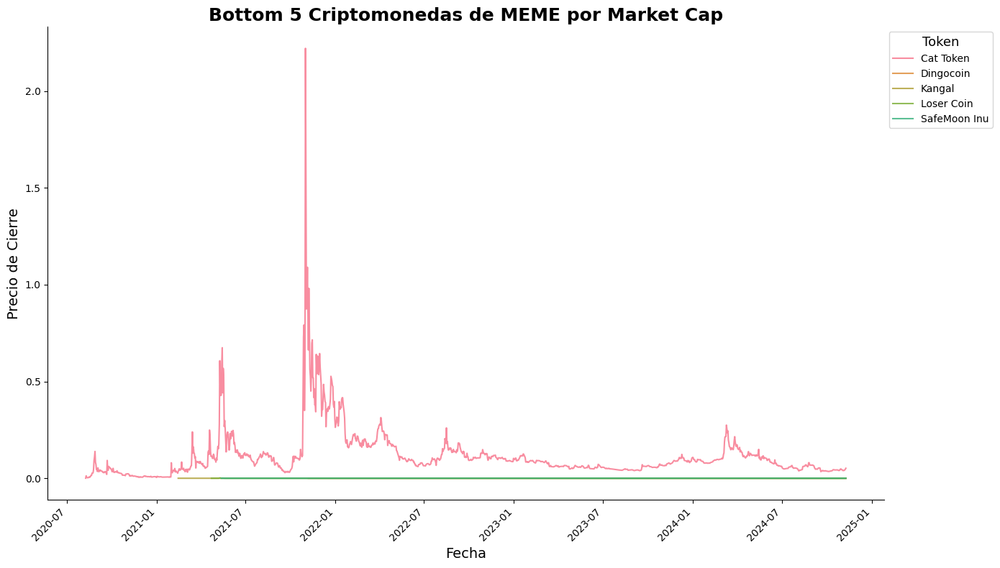

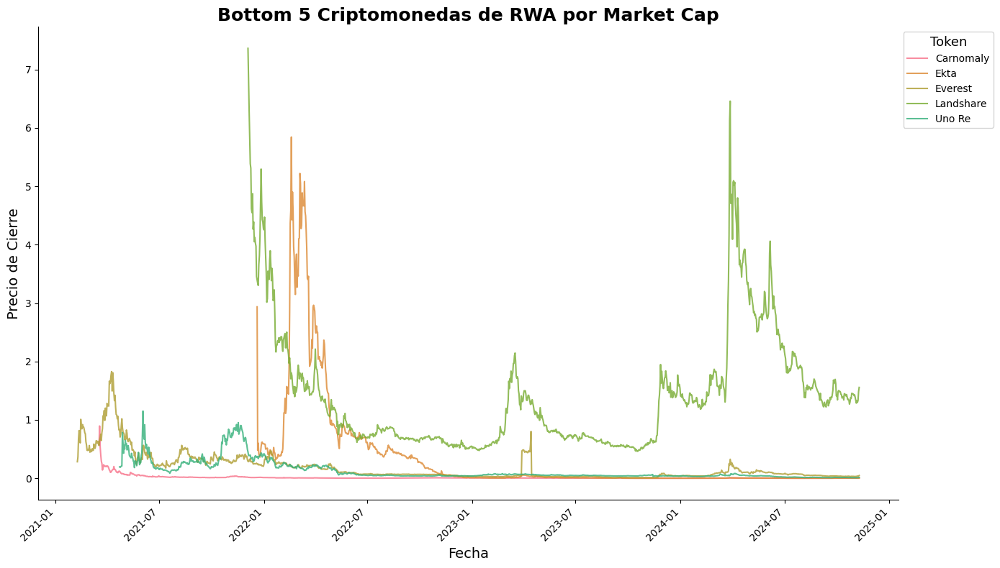

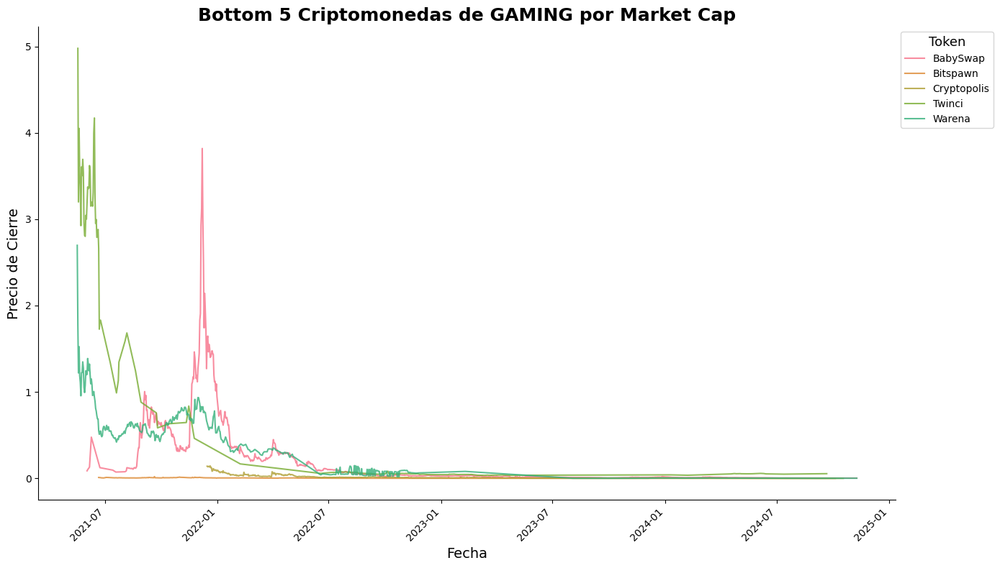

In [50]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en cada categoría
plot_price(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
plot_price(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_price(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
plot_price(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

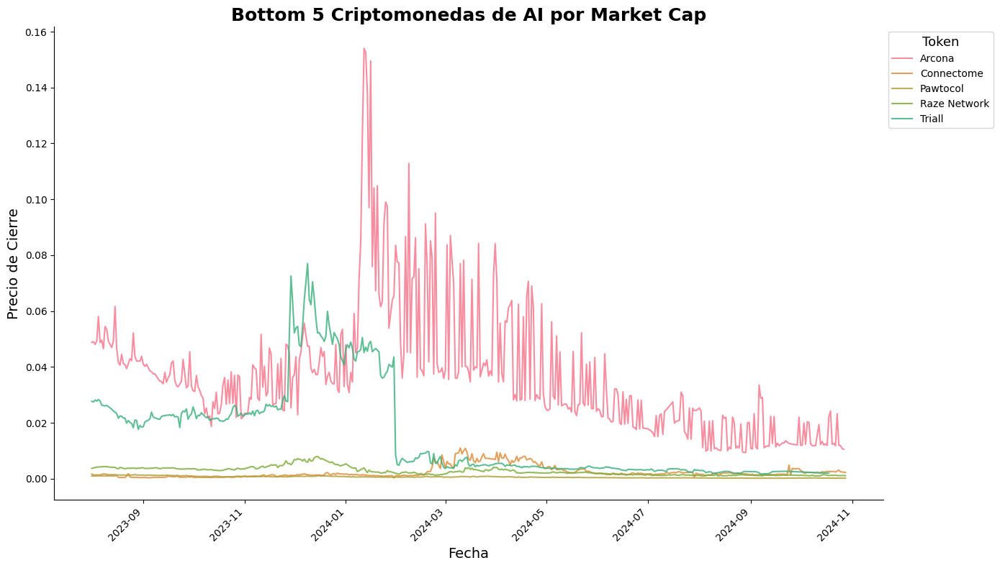

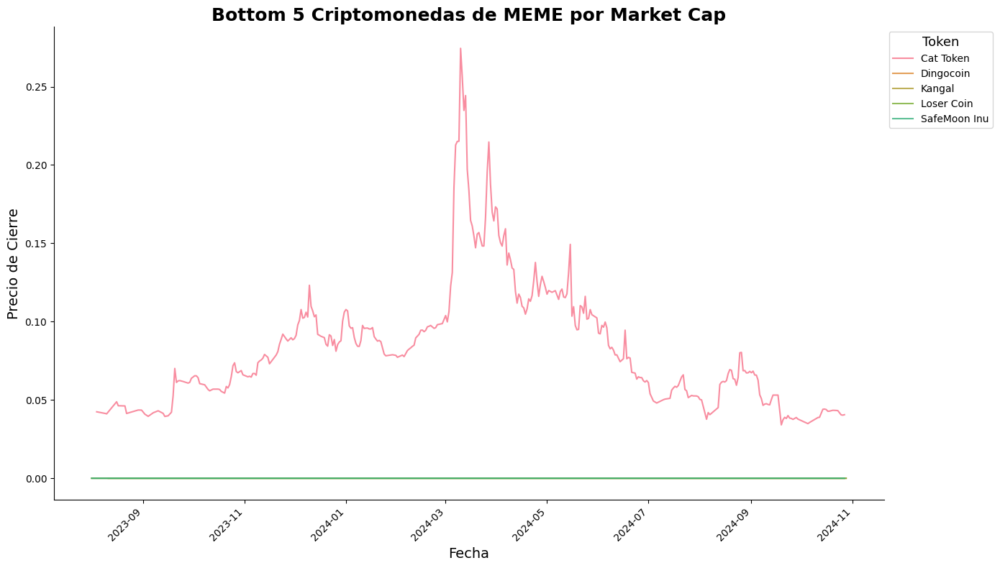

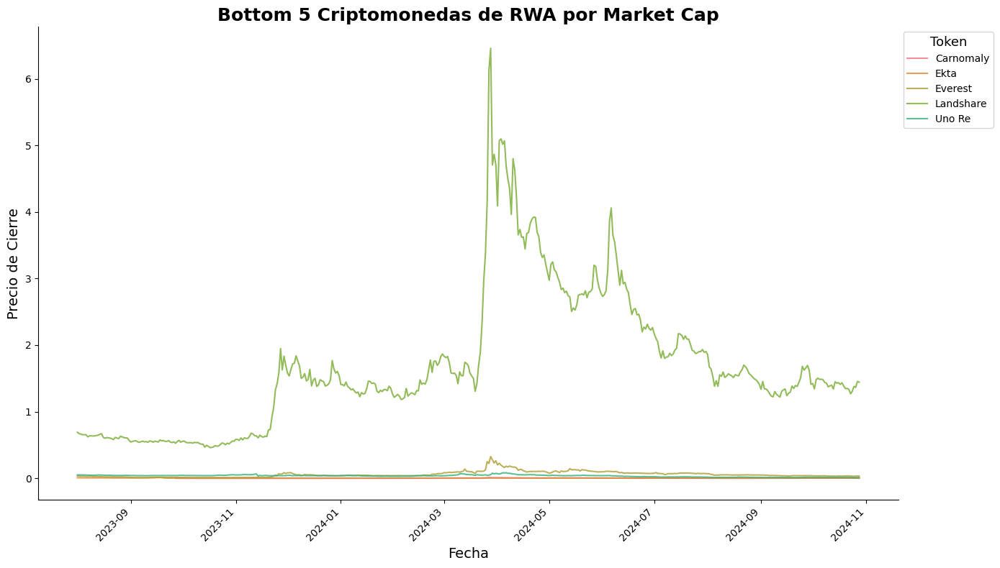

In [51]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en un rango de fechas
plot_cryptos_in_range(df_ai['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de AI por Market Cap")
plot_cryptos_in_range(df_meme['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_cryptos_in_range(df_rwa['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de RWA por Market Cap")

In [52]:
df_ai['bottom']['timestamp'].min(), df_meme['bottom']['timestamp'].min(), df_rwa['bottom']['timestamp'].min(), df_gaming['bottom']['timestamp'].min()

(Timestamp('2020-05-16 00:00:00'),
 Timestamp('2020-08-09 00:00:00'),
 Timestamp('2021-02-08 00:00:00'),
 Timestamp('2021-05-17 00:00:00'))

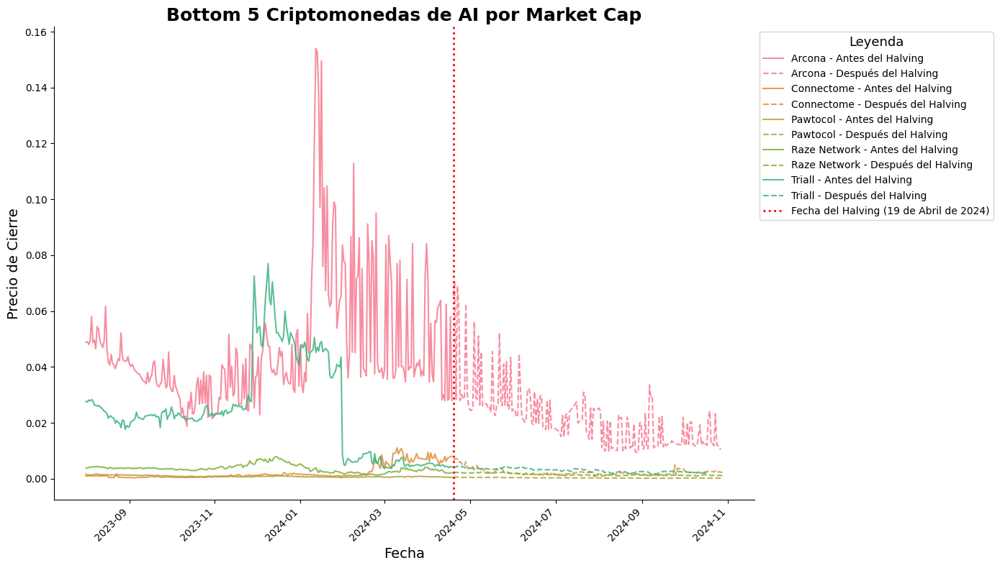

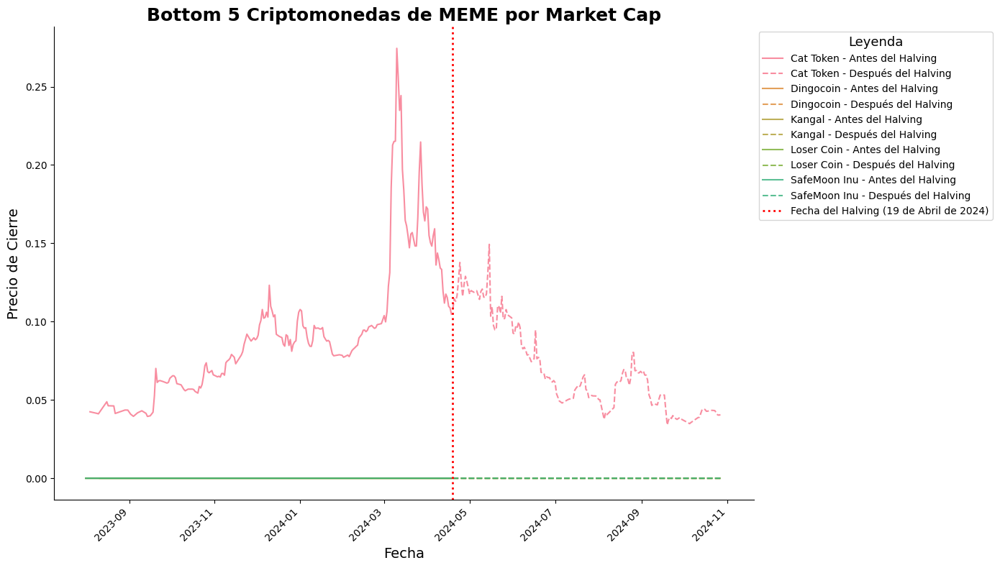

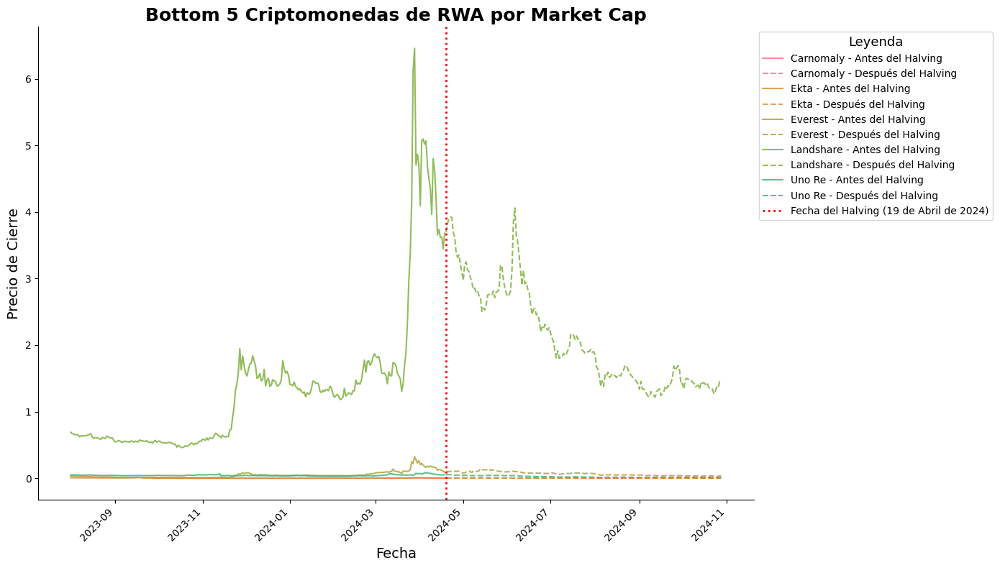

In [53]:
# Precio de Cierre de las 5 criptomonedas con menor Market Cap en un rango de fechas con el evento del halving
plot_date_halving(df_ai['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de AI por Market Cap")
plot_date_halving(df_meme['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de MEME por Market Cap")
plot_date_halving(df_rwa['bottom'], datetime(2023, 8, 1), datetime(2024, 10, 28), "Bottom 5 Criptomonedas de RWA por Market Cap")

Autocorrelación

In [54]:
def autocorrelacion(df, title, max_lags=365, palette=palette):
    for i, (name, group) in enumerate(df.groupby('name')):
        plt.figure(figsize=(12, 6))
        
        # Seleccionar el color de la paleta para cada criptomoneda
        color = palette[i % len(palette)]
        
        # Definir el número de rezagos (lags) a mostrar, limitado por el tamaño de los datos
        lags = min(max_lags, len(group['close']) - 1)
        
        # Crear gráfico de autocorrelación con el color de la paleta
        plot_acf(group['close'], lags=lags, alpha=0.05,
                title=f'Autocorrelación para {name} - {title}',
                zero=False, color=color, vlines_kwargs={'colors': color})
        
        # Configuración del título y etiquetas de ejes
        plt.title(f'Autocorrelación para {name} - {title}', fontsize=16, fontweight='bold', pad=25)
        plt.xlabel('Rezagos', fontsize=14)
        plt.ylabel('Autocorrelación', fontsize=14)
        
        # Ajustes adicionales en el gráfico
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        
        # Agregar línea de referencia horizontal
        plt.axhline(y=0, color='gray', linestyle='--', linewidth=1)
        
        # Eliminar bordes superiores y derechos para un diseño más limpio
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()

<Figure size 1200x600 with 0 Axes>

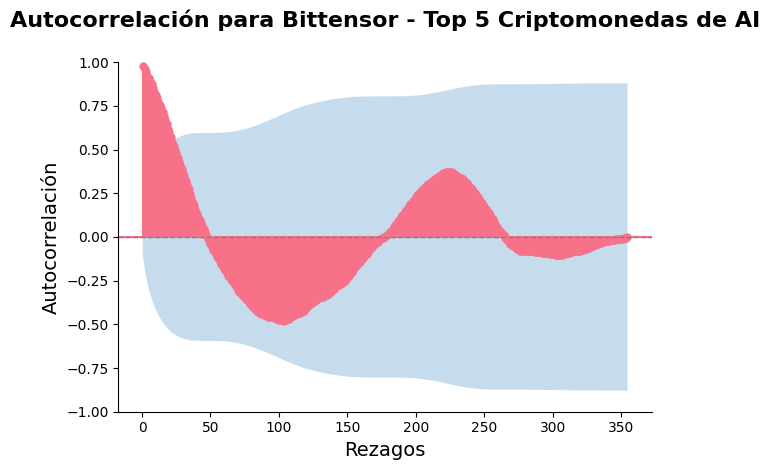

<Figure size 1200x600 with 0 Axes>

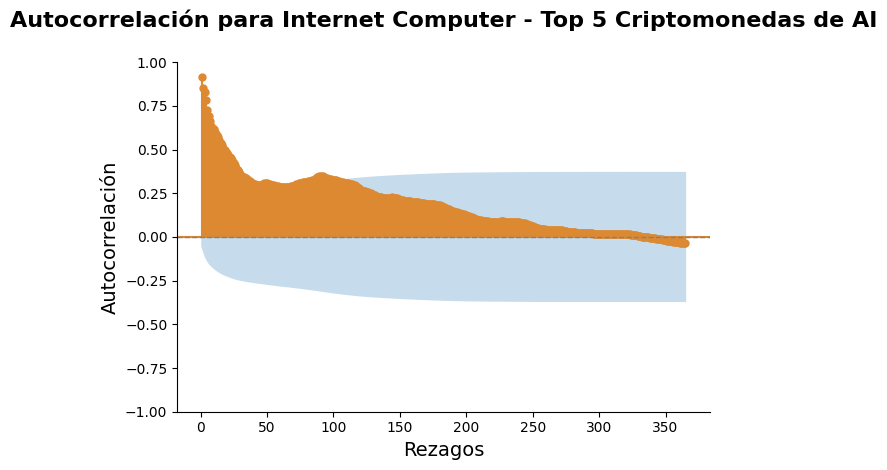

<Figure size 1200x600 with 0 Axes>

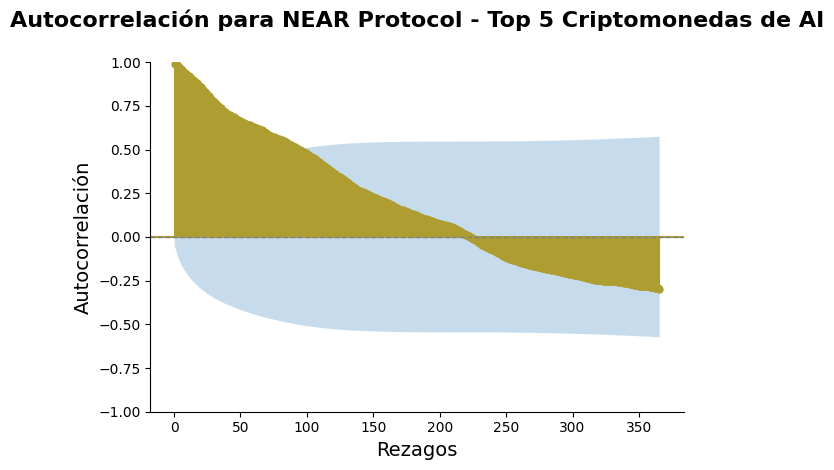

<Figure size 1200x600 with 0 Axes>

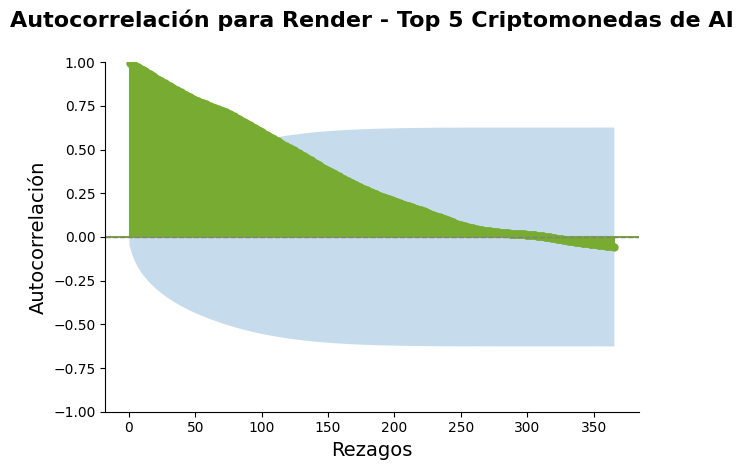

<Figure size 1200x600 with 0 Axes>

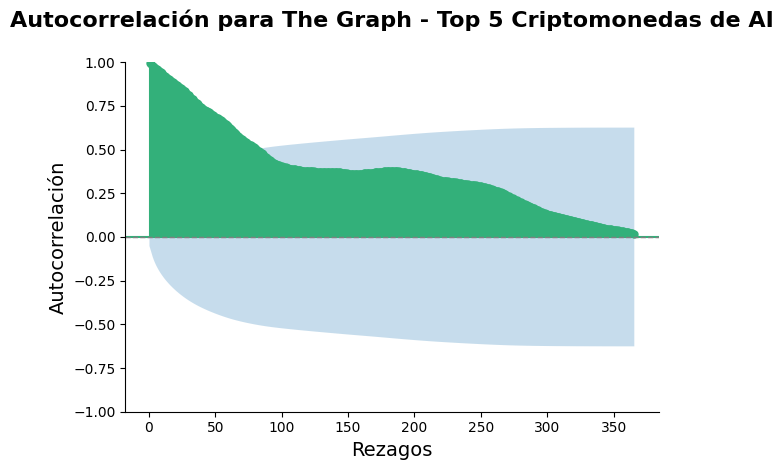

<Figure size 1200x600 with 0 Axes>

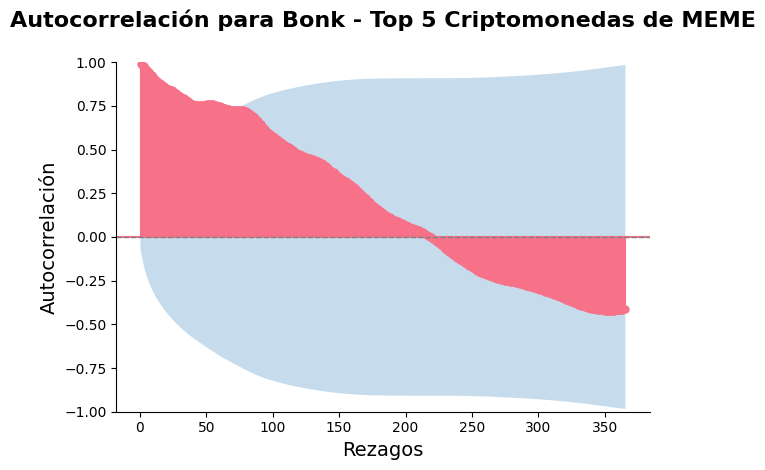

<Figure size 1200x600 with 0 Axes>

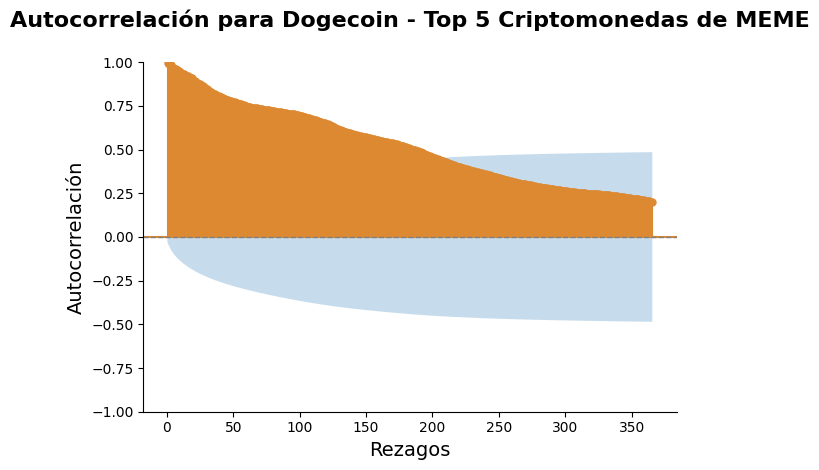

<Figure size 1200x600 with 0 Axes>

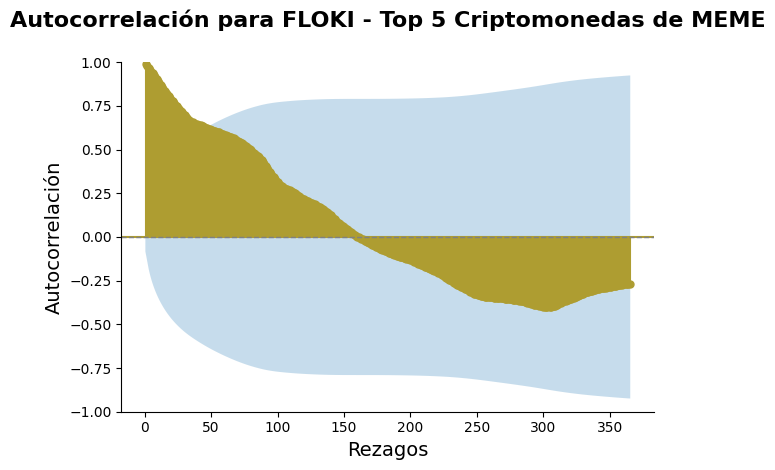

<Figure size 1200x600 with 0 Axes>

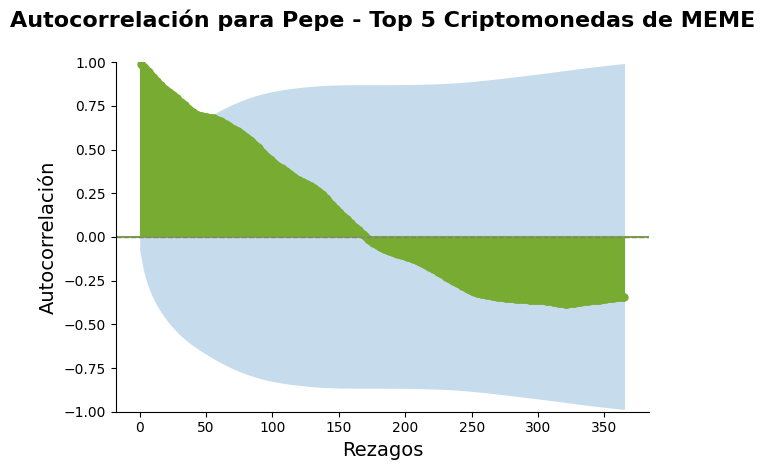

<Figure size 1200x600 with 0 Axes>

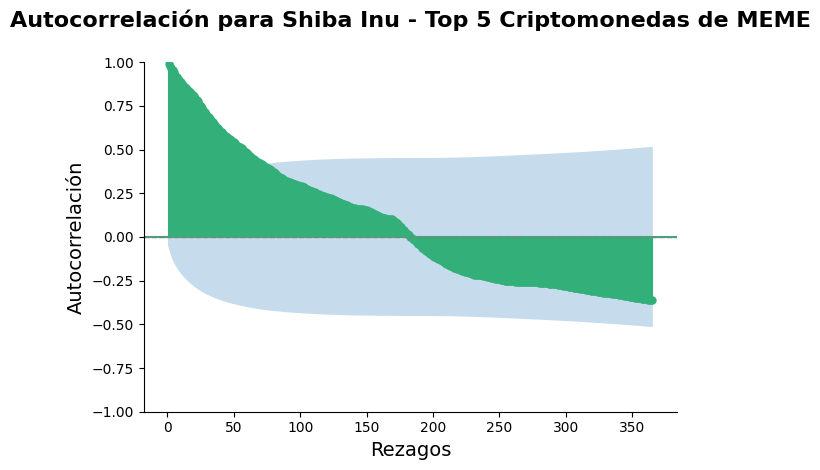

<Figure size 1200x600 with 0 Axes>

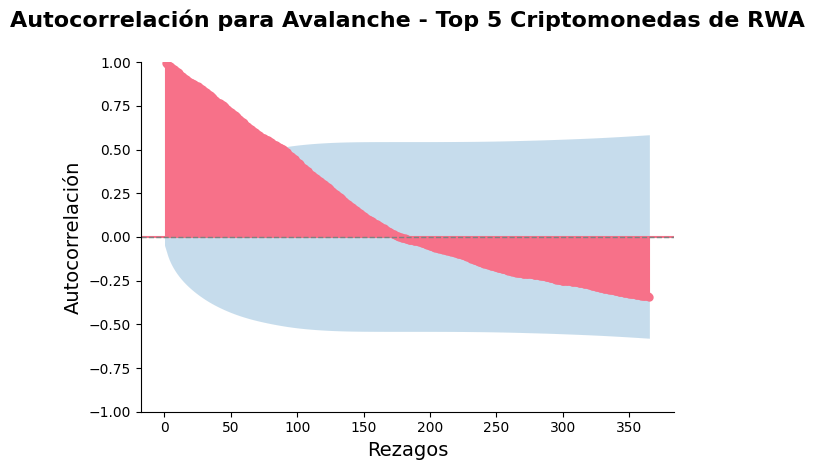

<Figure size 1200x600 with 0 Axes>

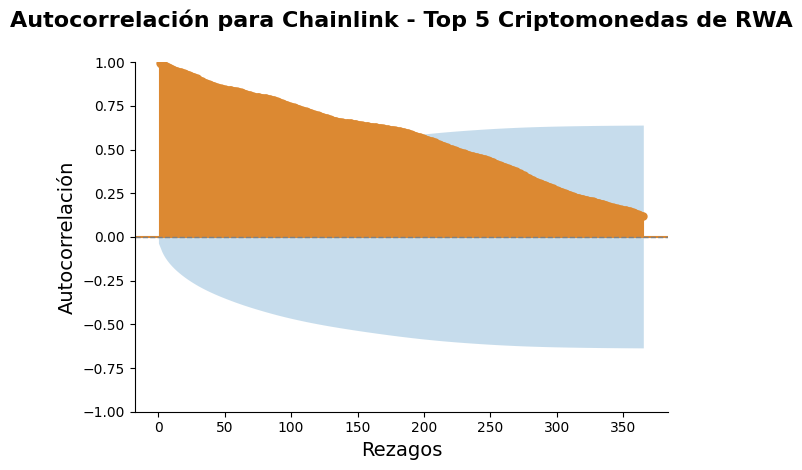

<Figure size 1200x600 with 0 Axes>

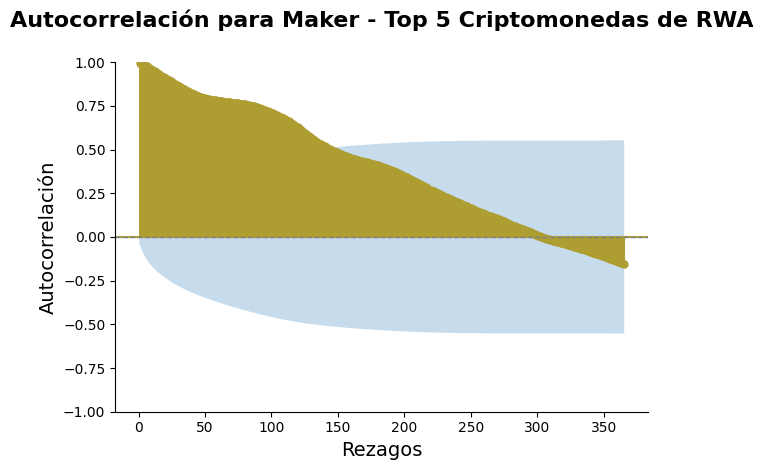

<Figure size 1200x600 with 0 Axes>

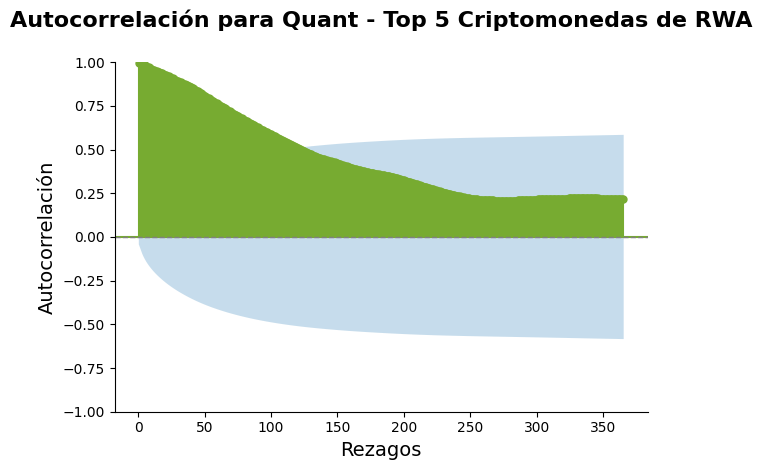

<Figure size 1200x600 with 0 Axes>

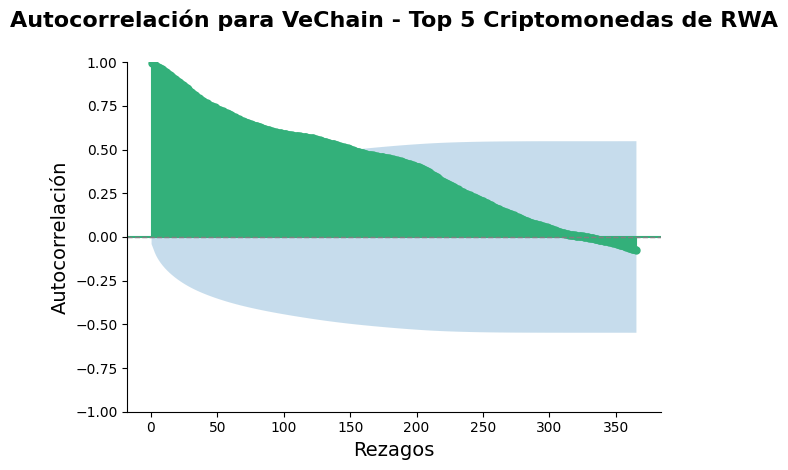

<Figure size 1200x600 with 0 Axes>

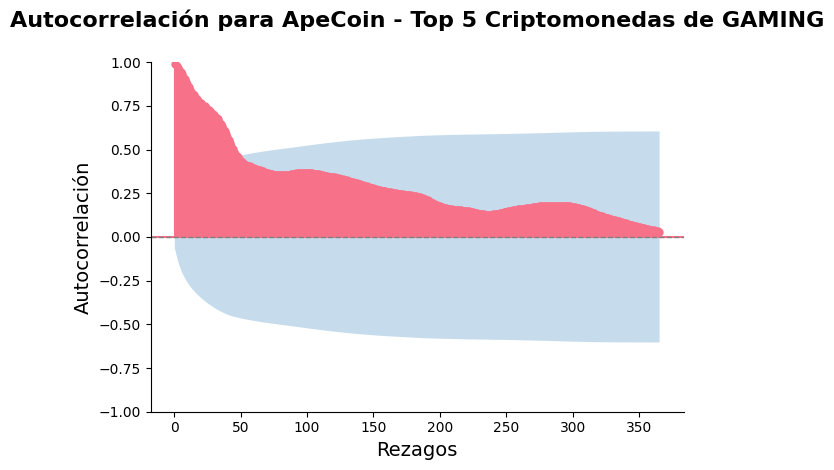

<Figure size 1200x600 with 0 Axes>

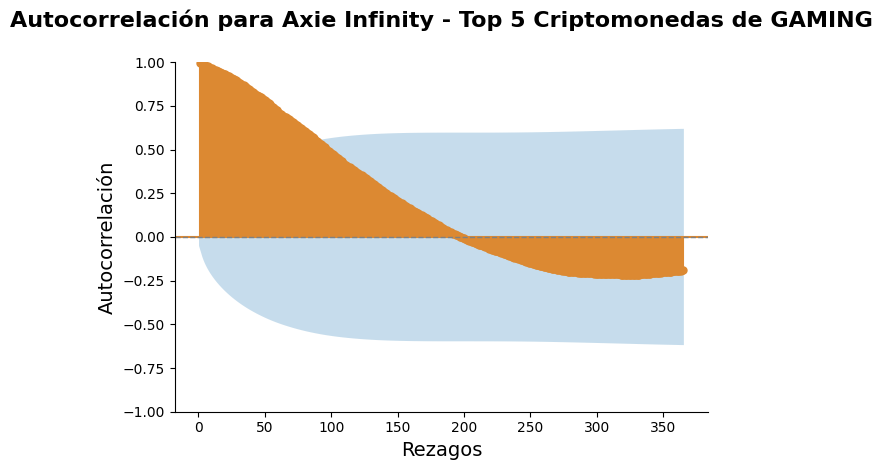

<Figure size 1200x600 with 0 Axes>

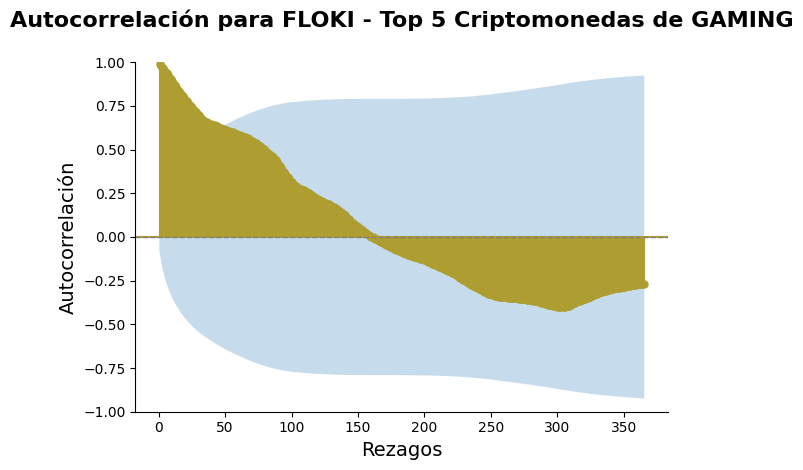

<Figure size 1200x600 with 0 Axes>

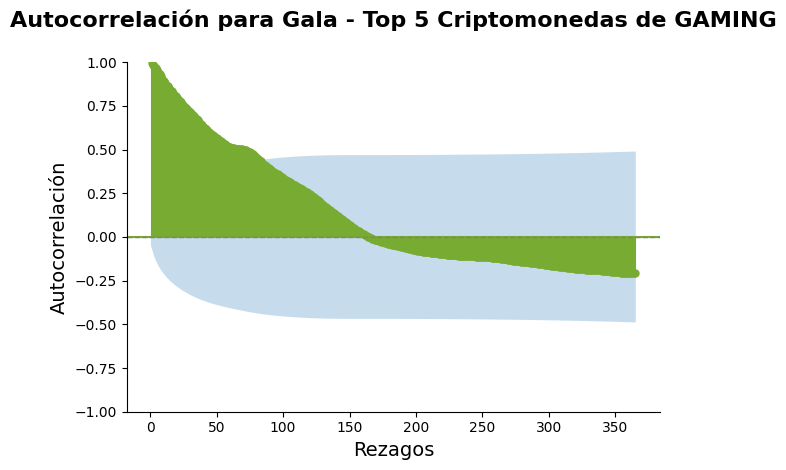

<Figure size 1200x600 with 0 Axes>

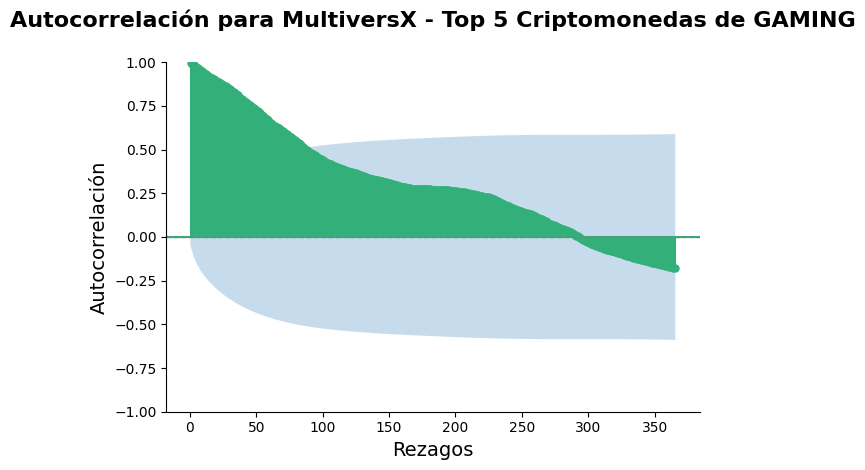

In [55]:
autocorrelacion(df_ai['top'], "Top 5 Criptomonedas de AI")
autocorrelacion(df_meme['top'], "Top 5 Criptomonedas de MEME")
autocorrelacion(df_rwa['top'], "Top 5 Criptomonedas de RWA")
autocorrelacion(df_gaming['top'], "Top 5 Criptomonedas de GAMING")

<Figure size 1200x600 with 0 Axes>

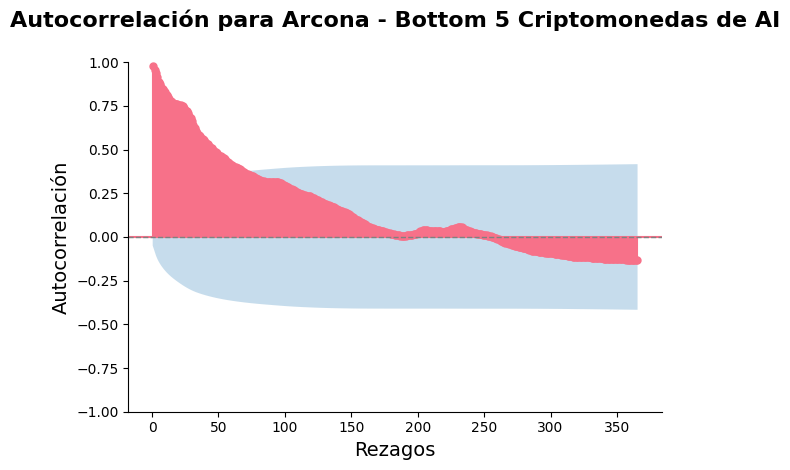

<Figure size 1200x600 with 0 Axes>

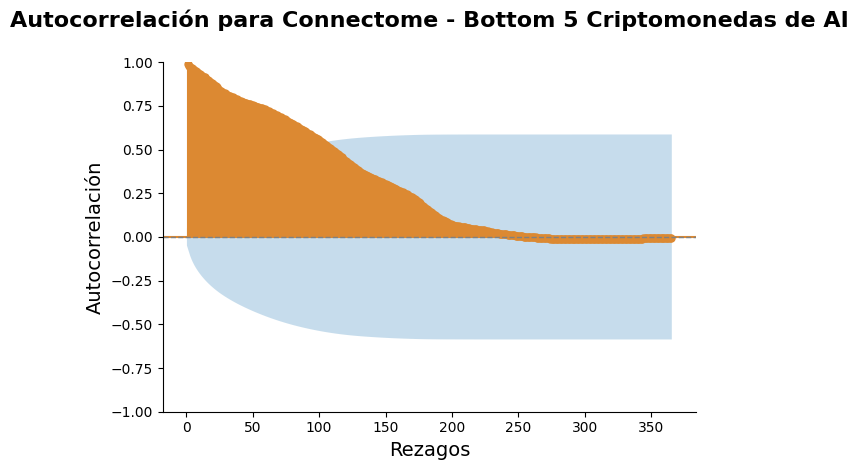

<Figure size 1200x600 with 0 Axes>

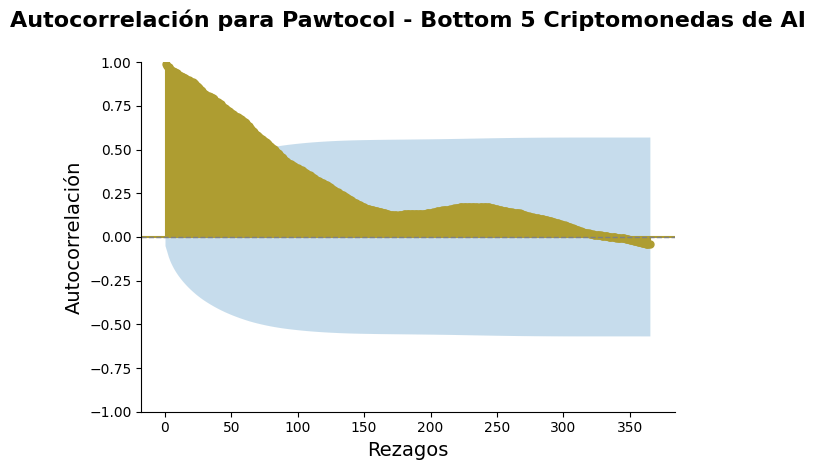

<Figure size 1200x600 with 0 Axes>

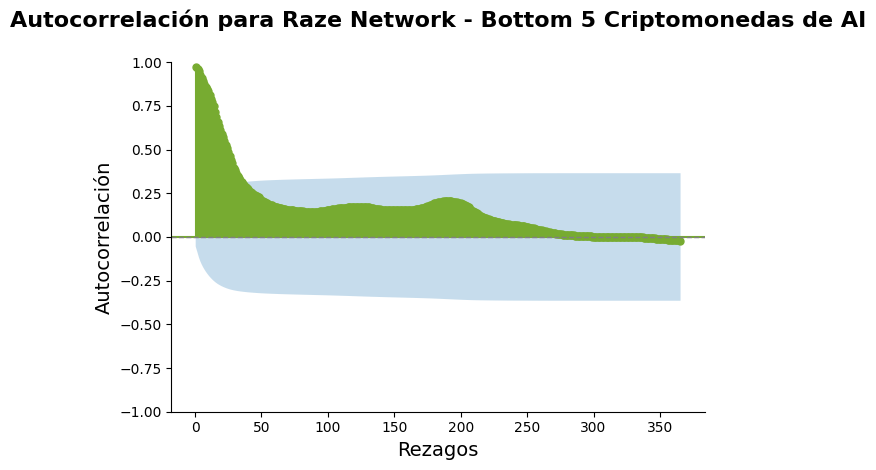

<Figure size 1200x600 with 0 Axes>

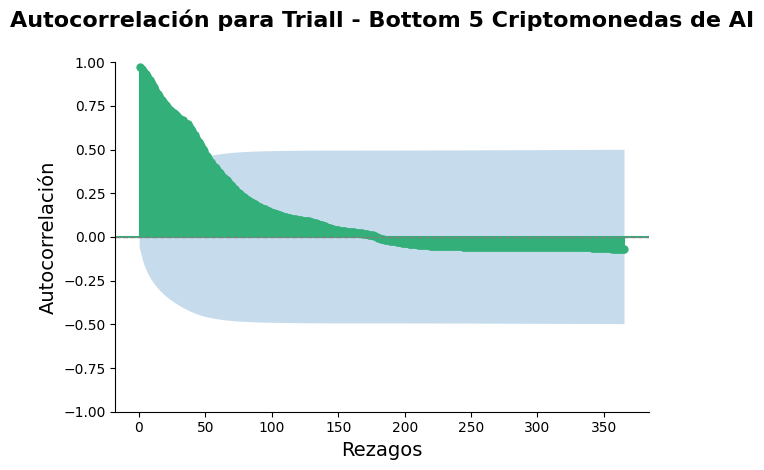

<Figure size 1200x600 with 0 Axes>

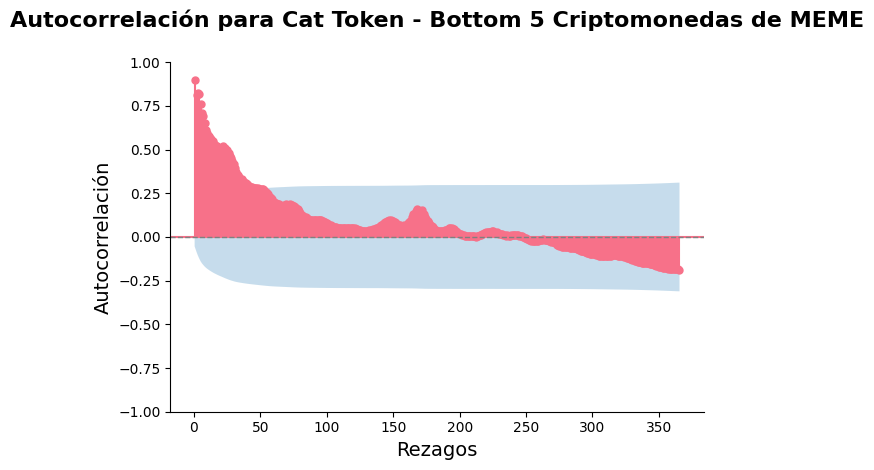

<Figure size 1200x600 with 0 Axes>

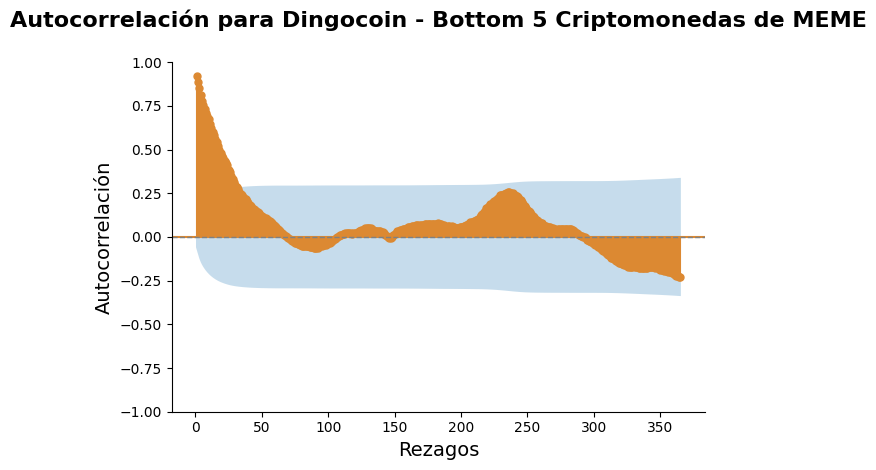

<Figure size 1200x600 with 0 Axes>

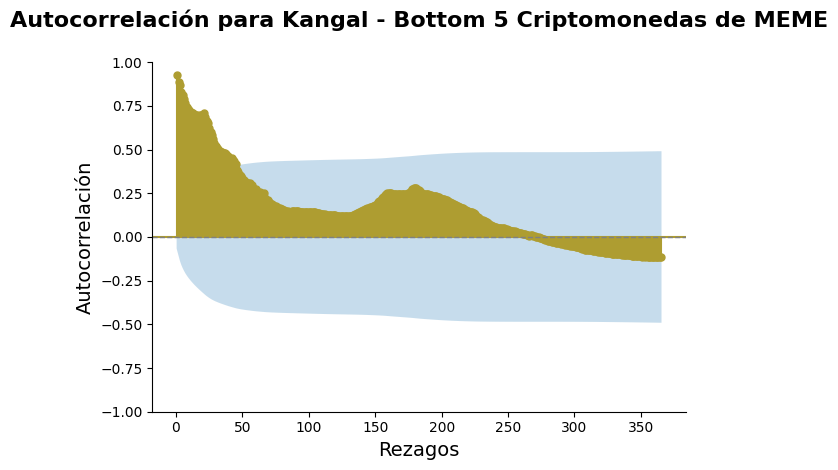

<Figure size 1200x600 with 0 Axes>

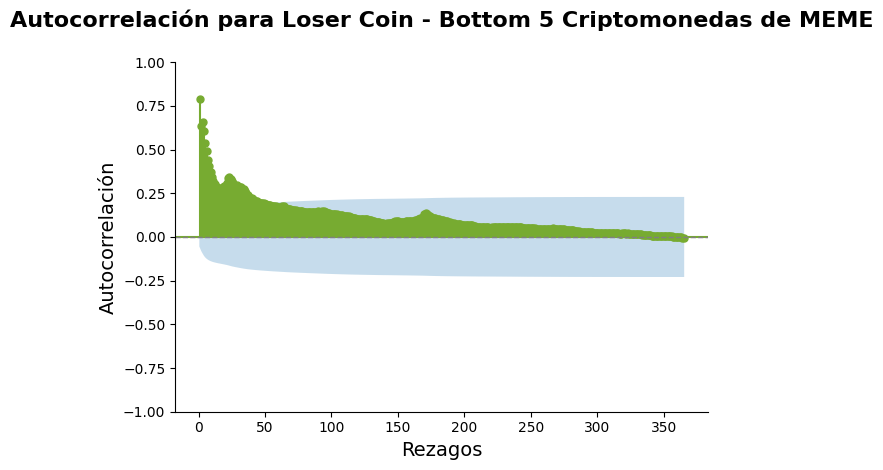

<Figure size 1200x600 with 0 Axes>

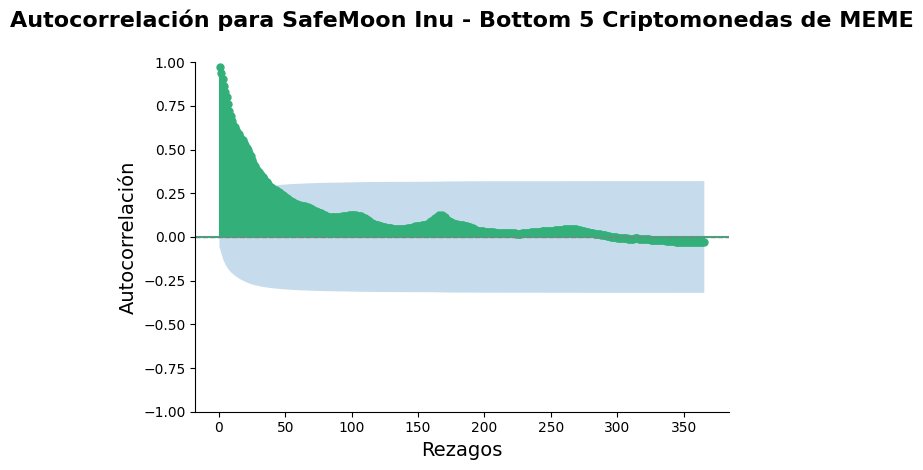

<Figure size 1200x600 with 0 Axes>

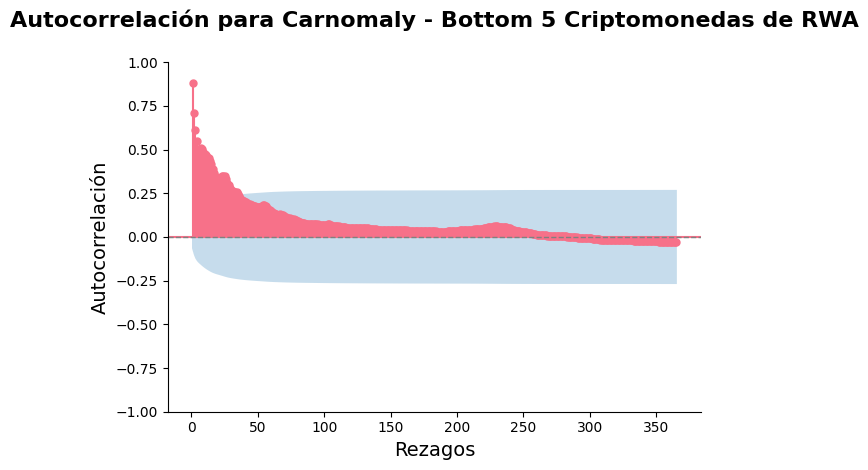

<Figure size 1200x600 with 0 Axes>

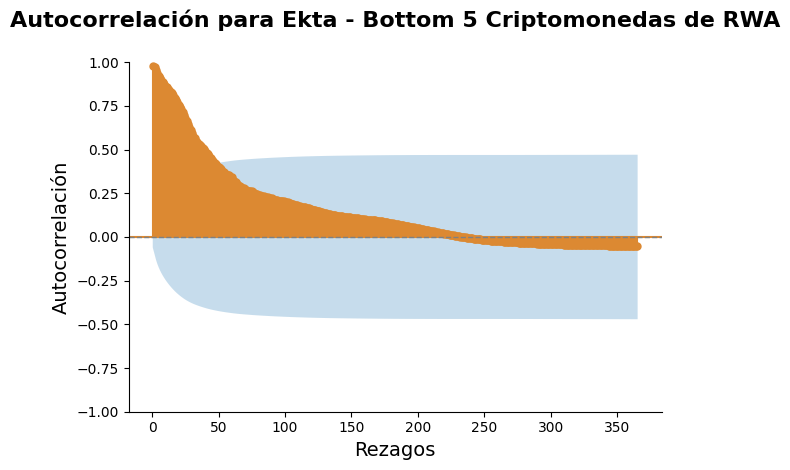

<Figure size 1200x600 with 0 Axes>

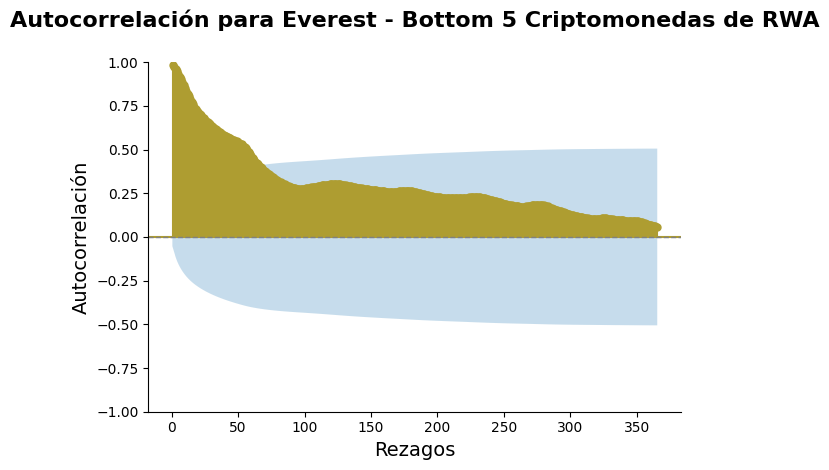

<Figure size 1200x600 with 0 Axes>

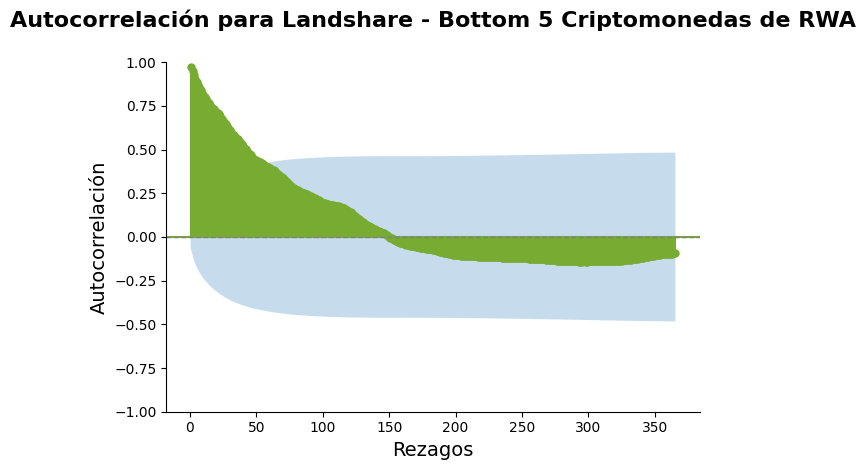

<Figure size 1200x600 with 0 Axes>

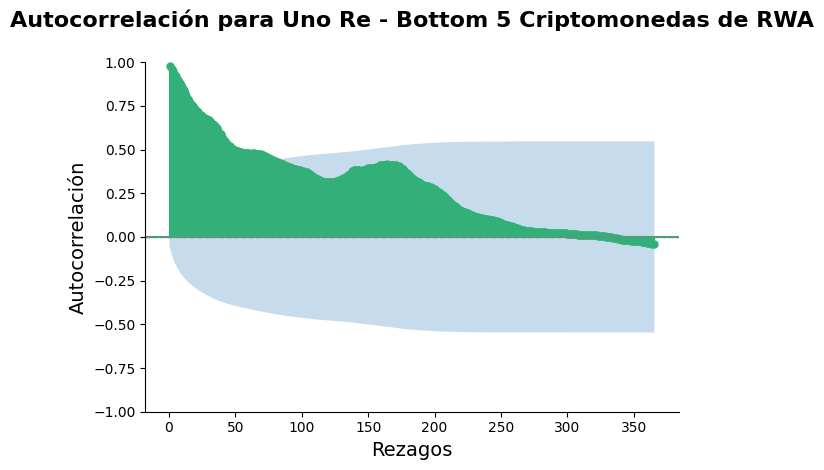

<Figure size 1200x600 with 0 Axes>

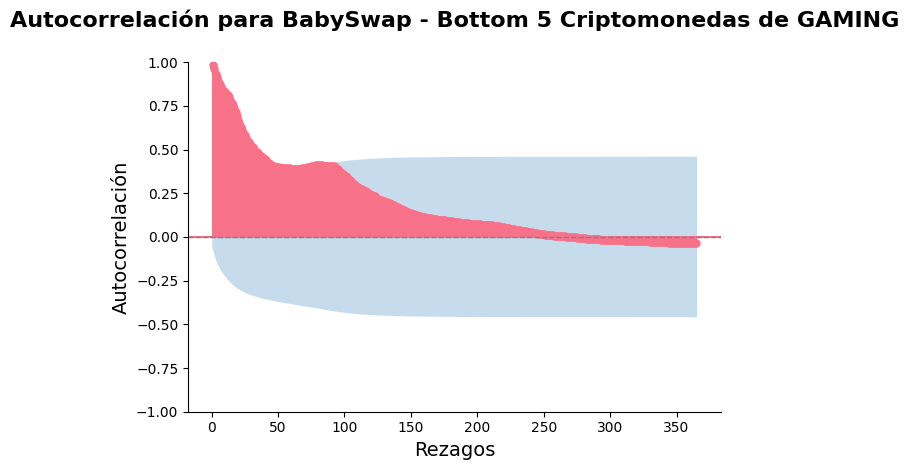

<Figure size 1200x600 with 0 Axes>

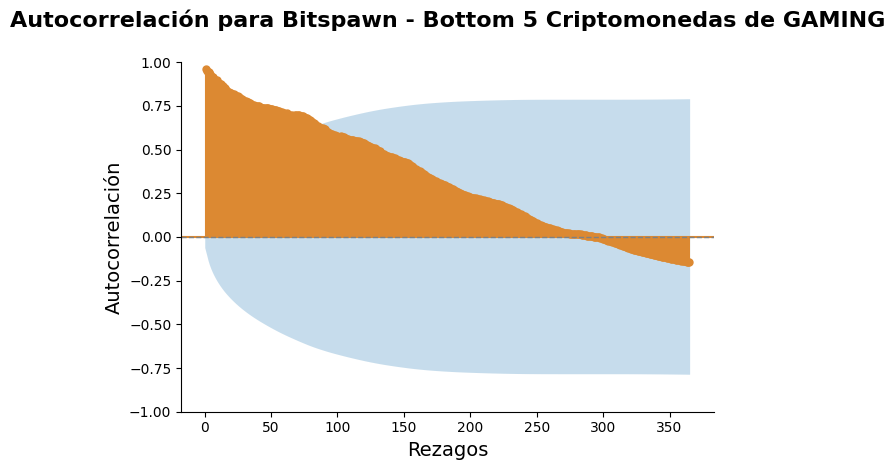

<Figure size 1200x600 with 0 Axes>

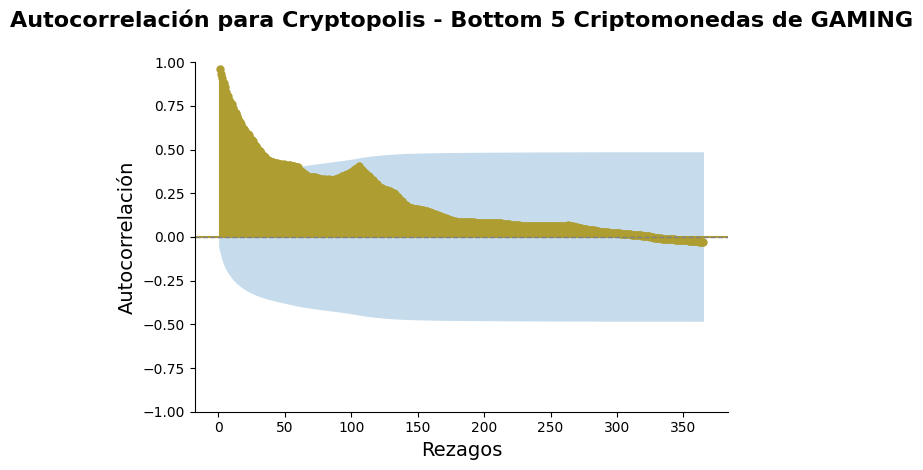

<Figure size 1200x600 with 0 Axes>

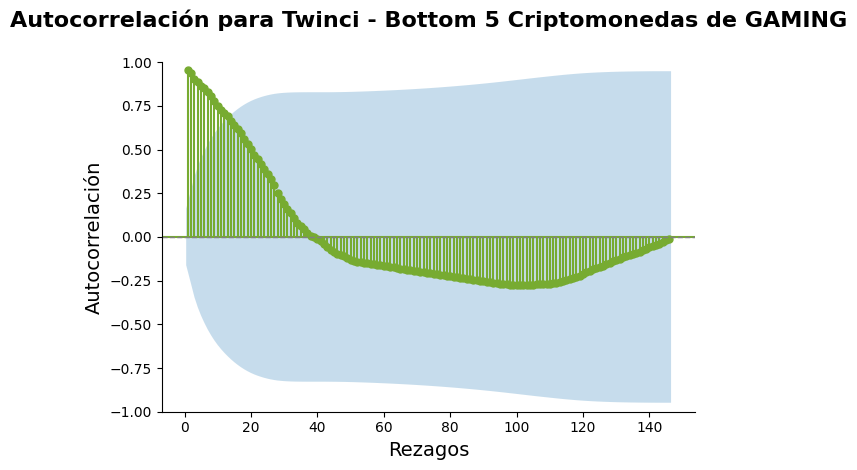

<Figure size 1200x600 with 0 Axes>

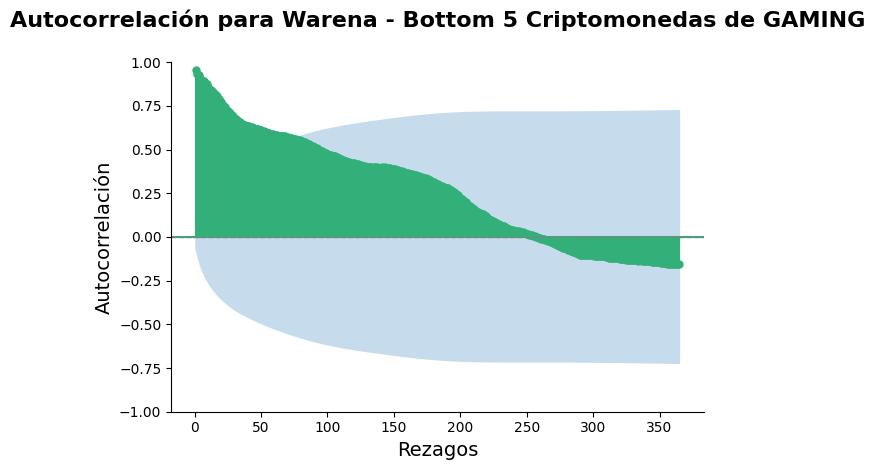

In [56]:
autocorrelacion(df_ai['bottom'], "Bottom 5 Criptomonedas de AI")
autocorrelacion(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME")
autocorrelacion(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA")
autocorrelacion(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING")

Medias Móviles de Diferentes Ventanas

In [80]:
import matplotlib.pyplot as plt
import pandas as pd

def media_movel(df, title, palette=palette):
    df = df.copy()
    
    # Convertir 'timestamp' a formato de fecha y establecerlo como índice
    df['date'] = pd.to_datetime(df['timestamp'], unit='s')
    df.set_index('date', inplace=True)
    
    for name, group in df.groupby('name'):
        # Calcular medias móviles
        group['MA_7'] = group['close'].rolling(window=7).mean()
        group['MA_30'] = group['close'].rolling(window=30).mean()
        group['MA_90'] = group['close'].rolling(window=90).mean()
    
        # Crear la figura
        plt.figure(figsize=(12, 6))
        
        # Graficar el precio de cierre y las medias móviles
        plt.plot(group.index, group['close'], label='Precio de Cierre', color="black", linewidth=1.5)
        plt.plot(group.index, group['MA_7'], label='Media Móvil (7 días)', color="purple", linestyle='-', linewidth=1.2)
        plt.plot(group.index, group['MA_30'], label='Media Móvil (30 días)', color="pink", linestyle='-', linewidth=1.2)
        plt.plot(group.index, group['MA_90'], label='Media Móvil (90 días)', color="green", linestyle='-', linewidth=1.2)
        plt.axvline(x=datetime(2024, 4, 19), color='red', linestyle=':', linewidth=2, label='Ultimo having')
        
        # Configuración del título con padding adicional y etiquetas de ejes
        plt.title(f'Medias Móviles de {name} - {title}', fontsize=16, fontweight='bold', pad=15)
        plt.xlabel('Fecha', fontsize=14)
        plt.ylabel('Precio de Cierre', fontsize=14)
        
        # Ajuste de las etiquetas del eje x con formato de fecha
        plt.xticks(rotation=45, ha='right', fontsize=10)
        plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter("%Y-%m-%d"))
        
        # Configuración de la leyenda fuera del área del gráfico
        plt.legend(title="Indicadores", title_fontsize='13', fontsize='10', bbox_to_anchor=(1.05, 1))

        # Agregar bordes suaves al gráfico
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()


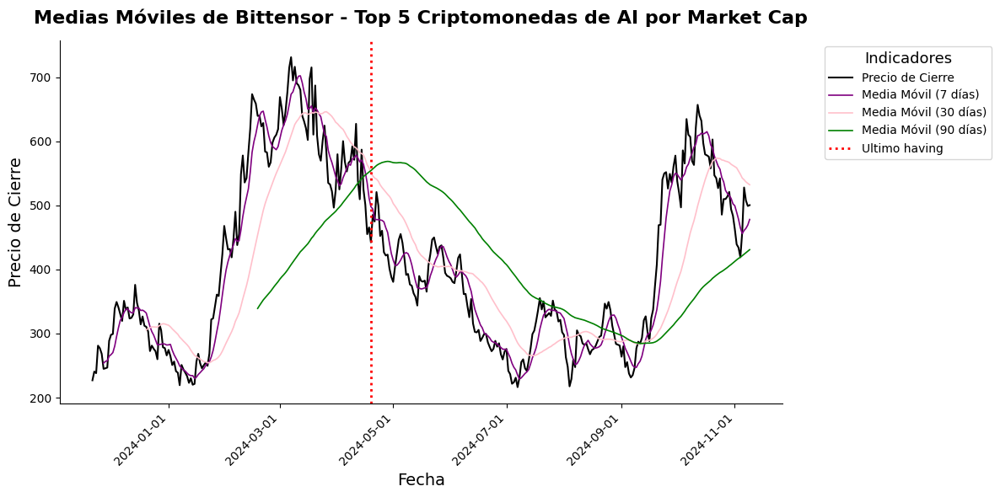

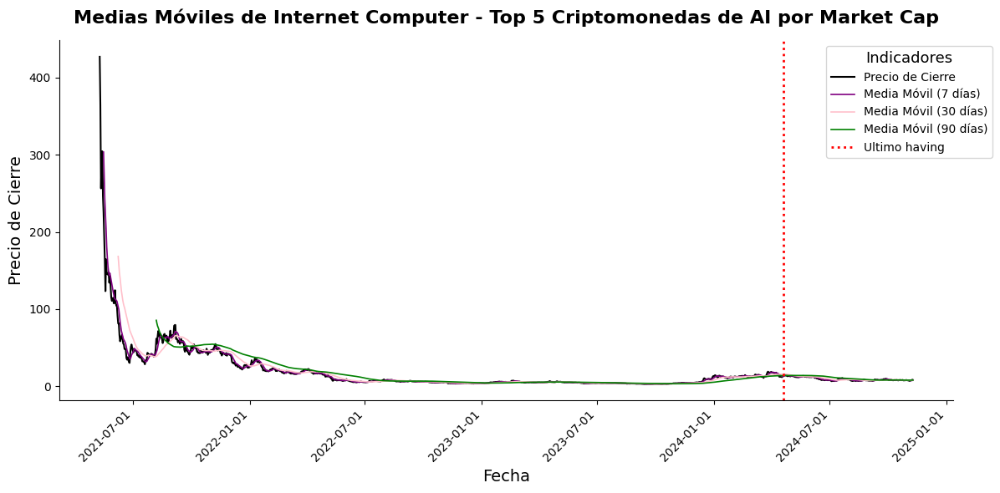

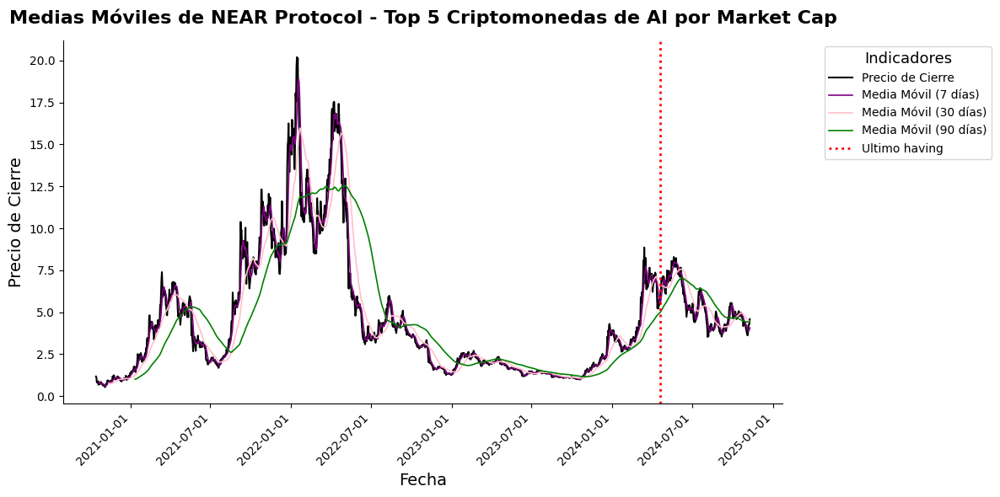

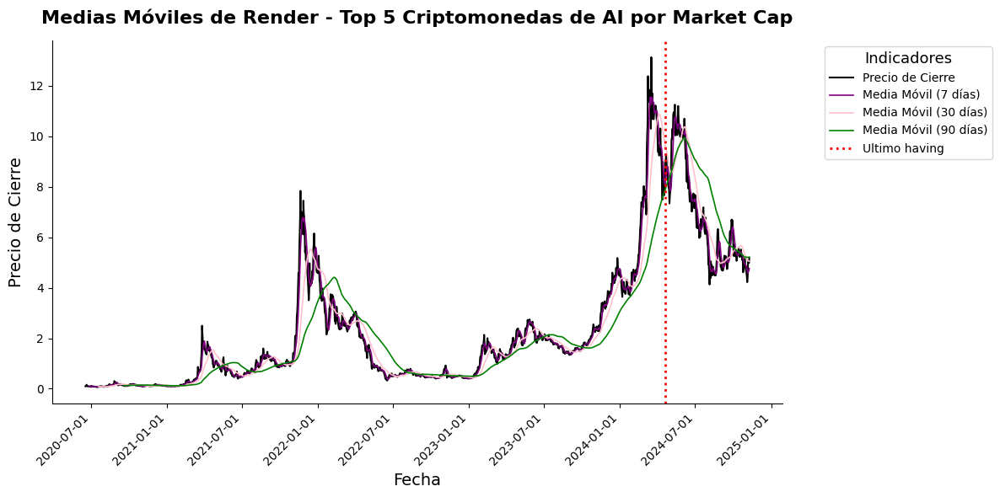

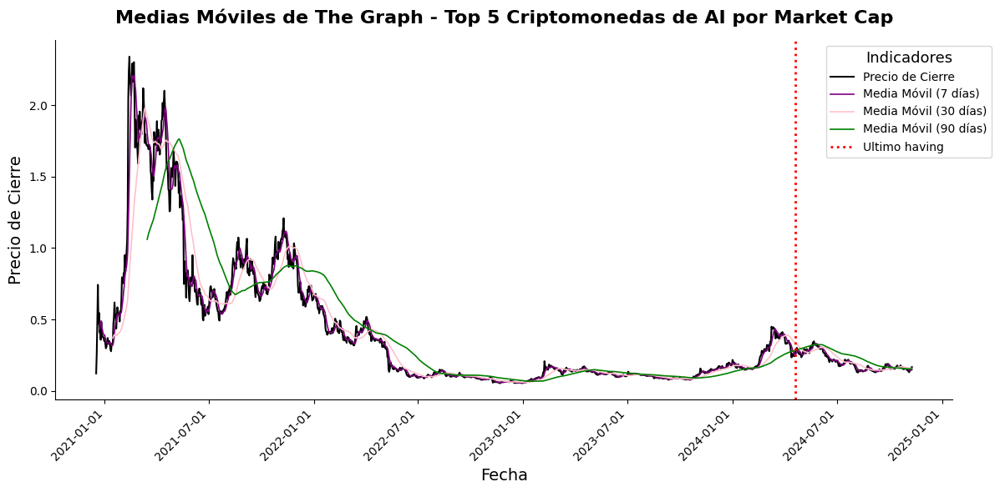

...

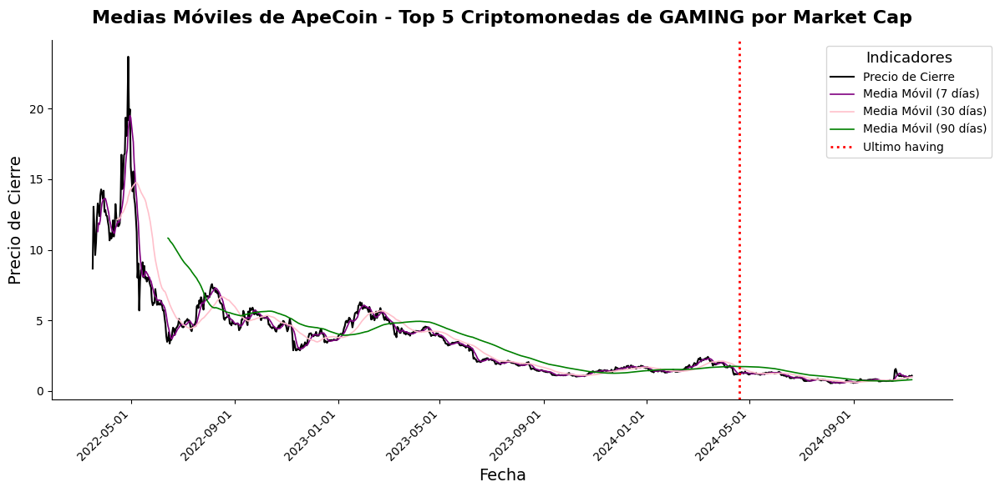

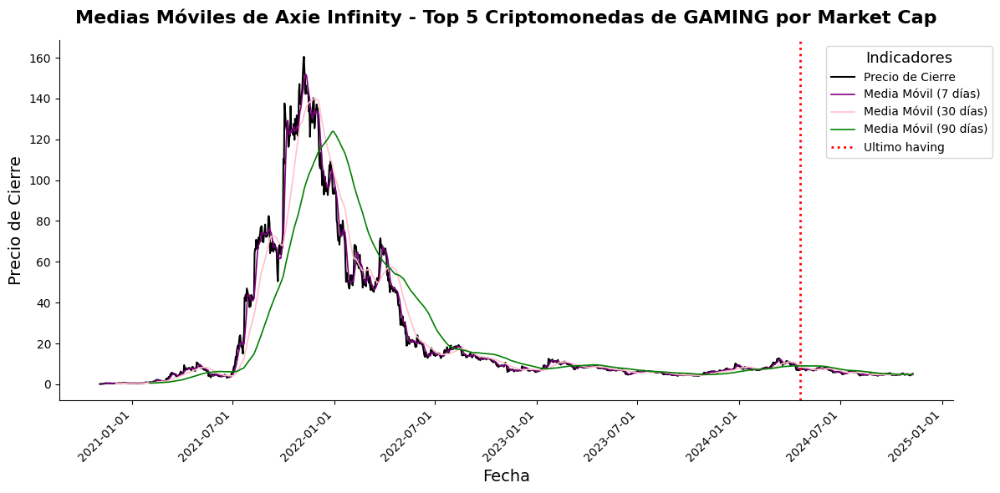

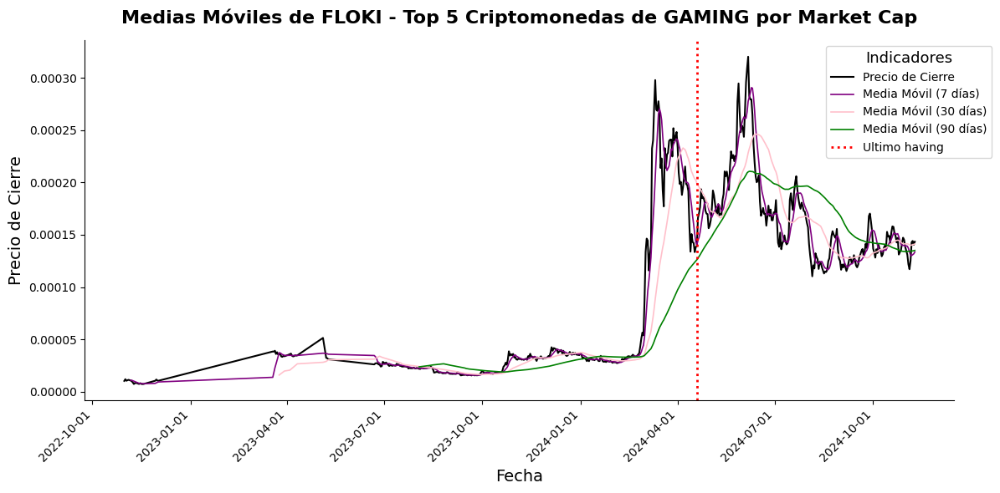

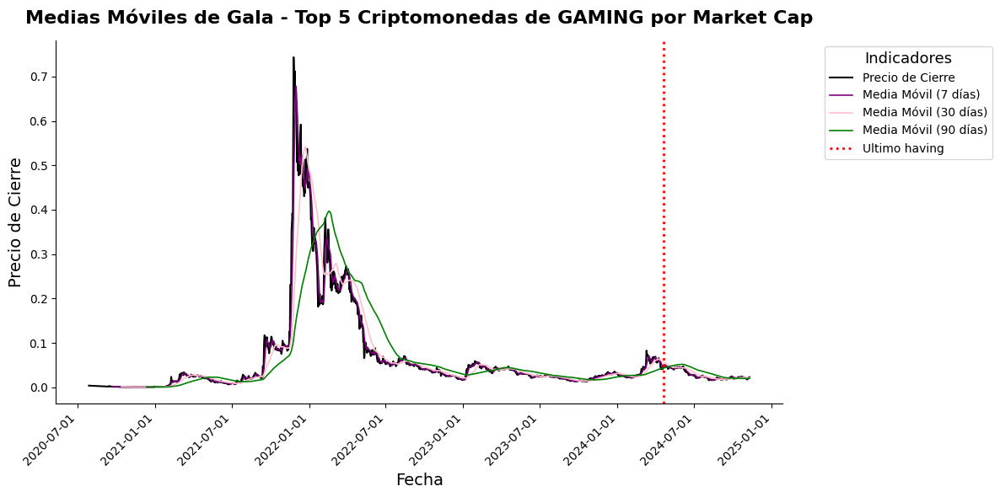

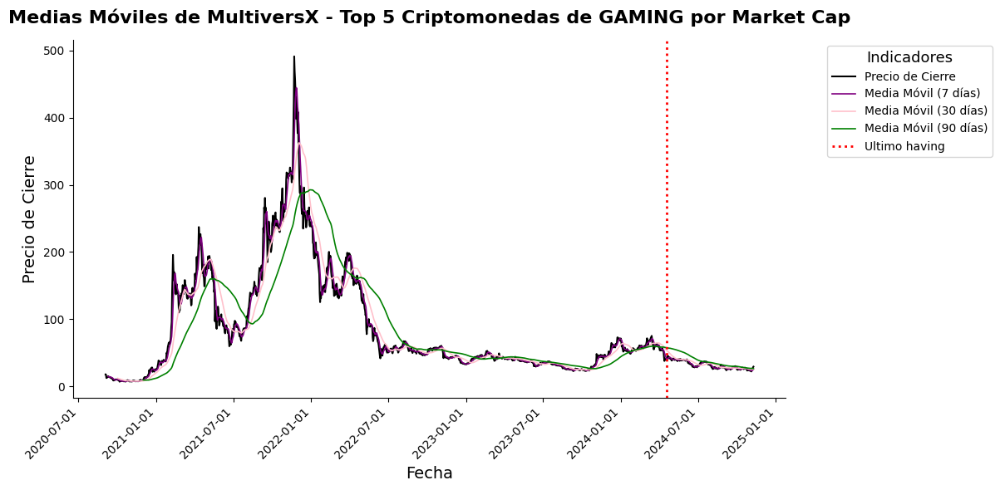

In [81]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
media_movel(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
media_movel(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
media_movel(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
media_movel(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

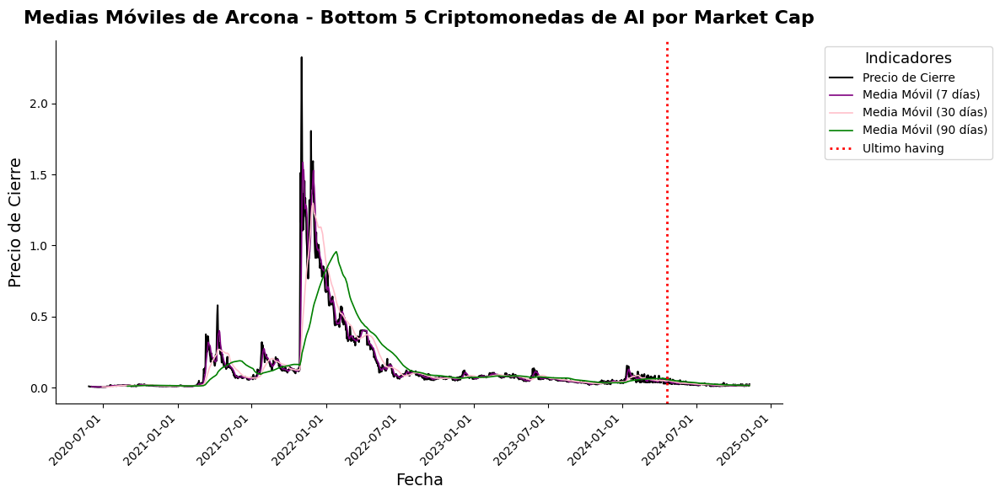

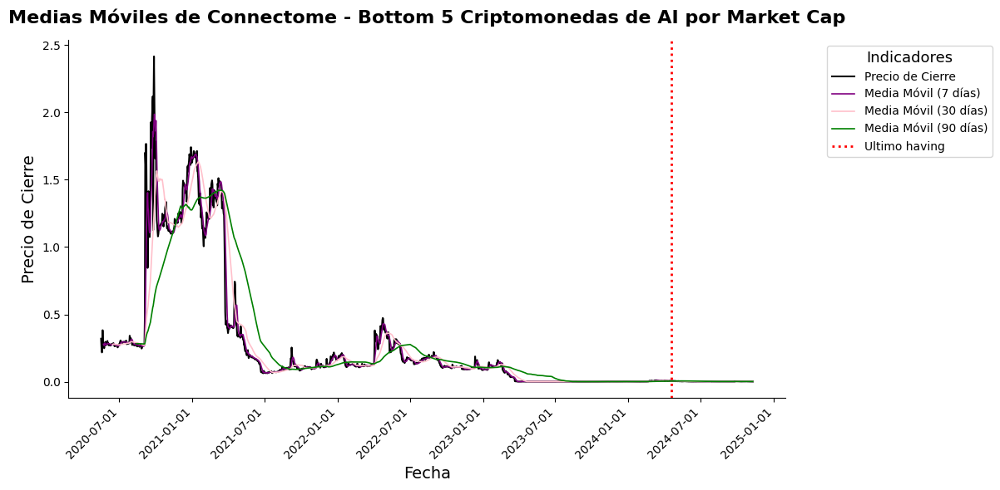

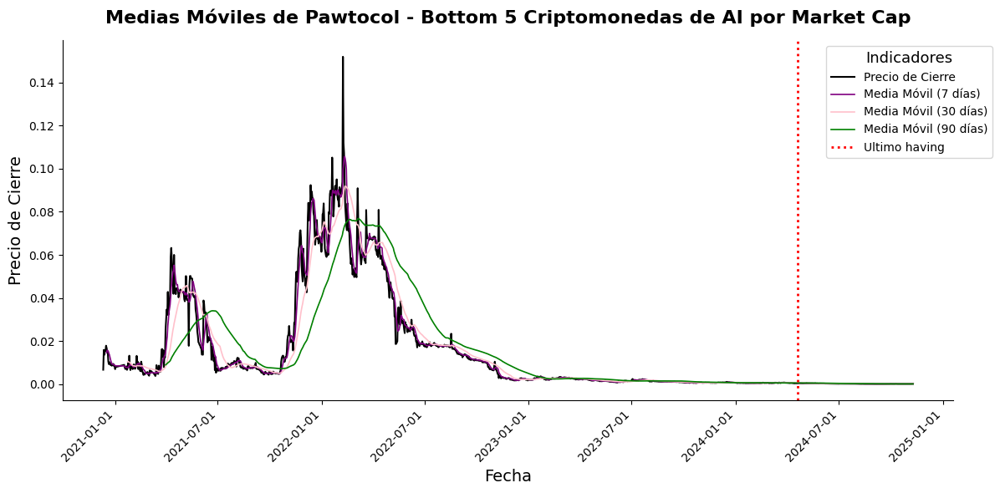

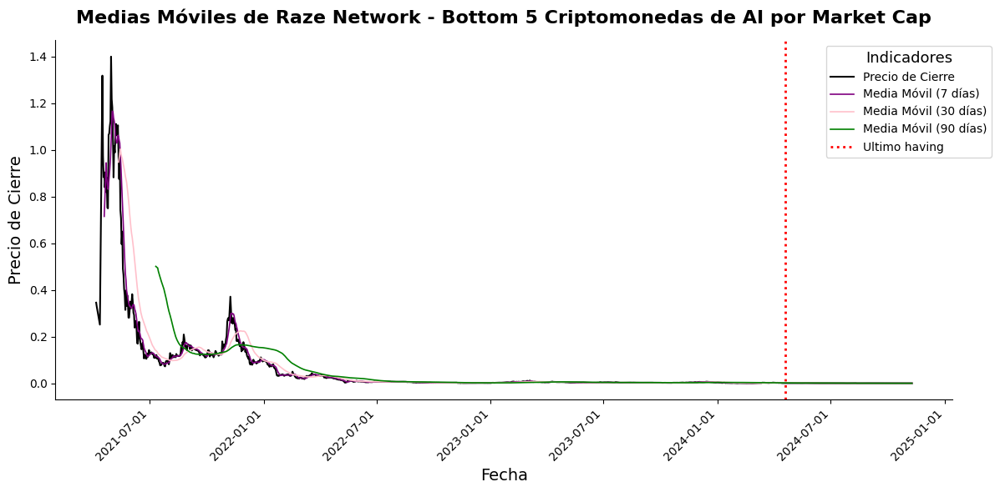

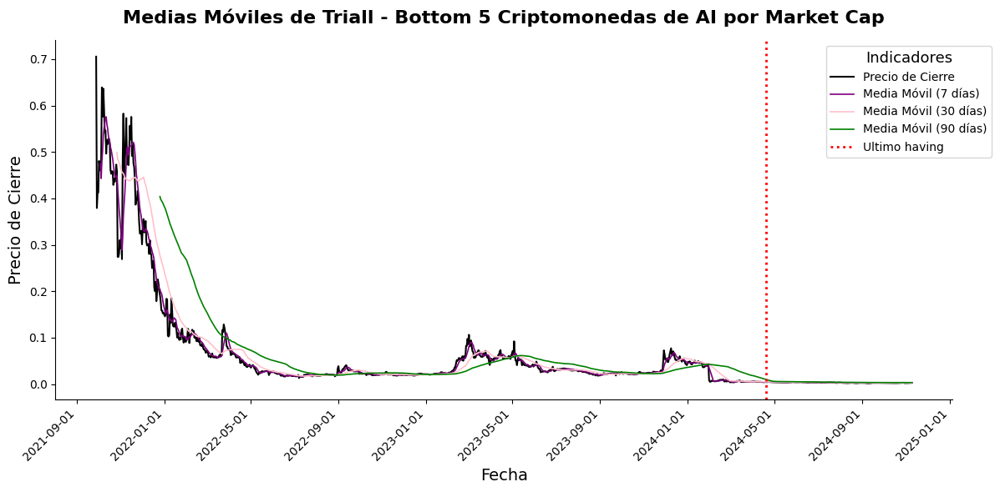

...

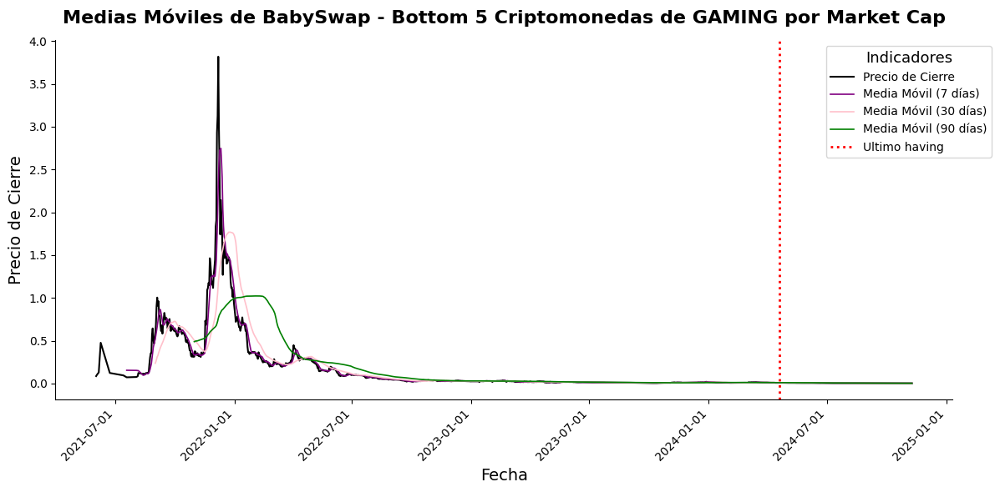

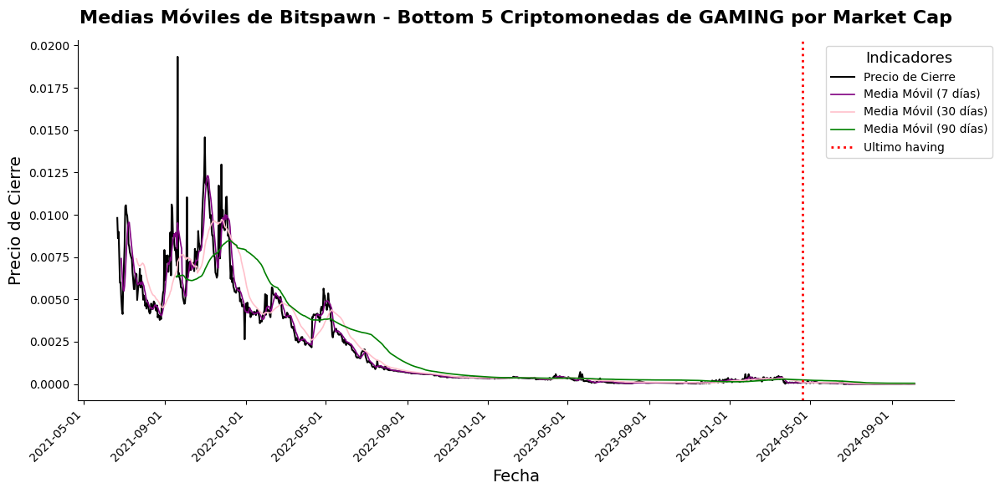

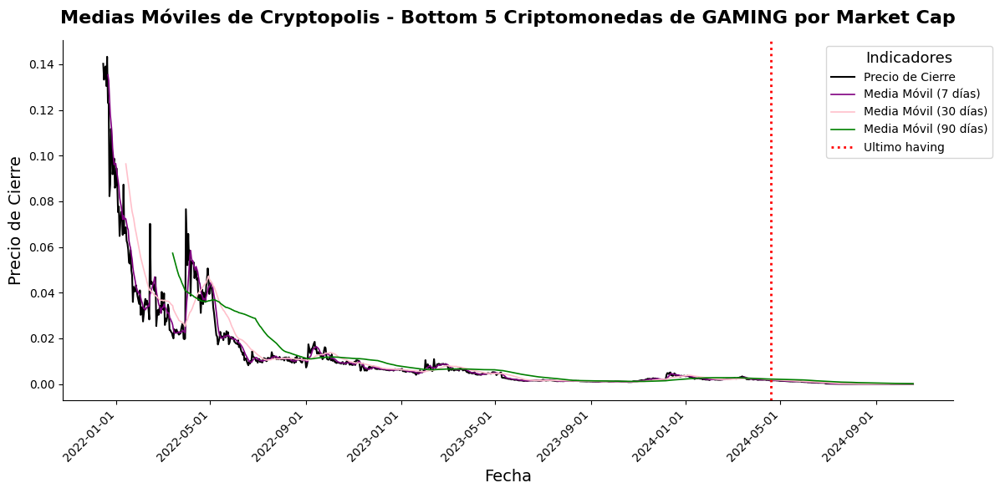

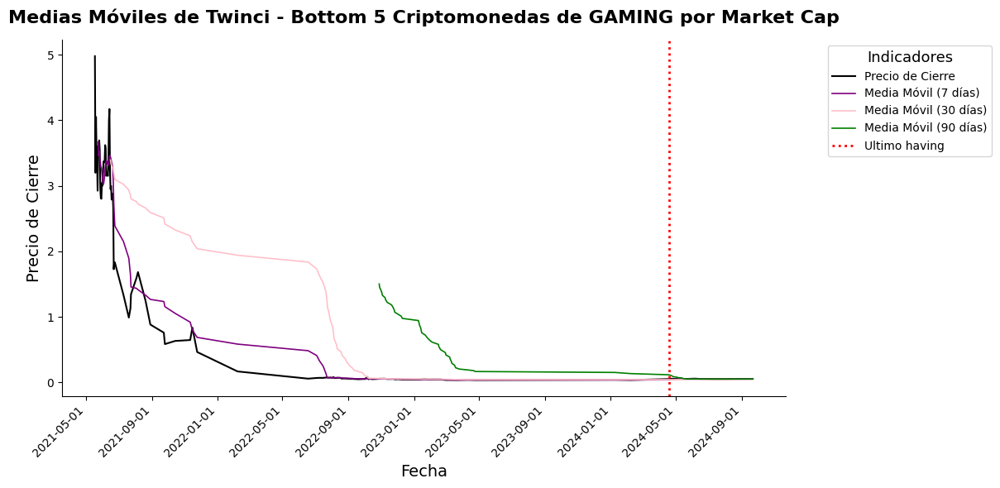

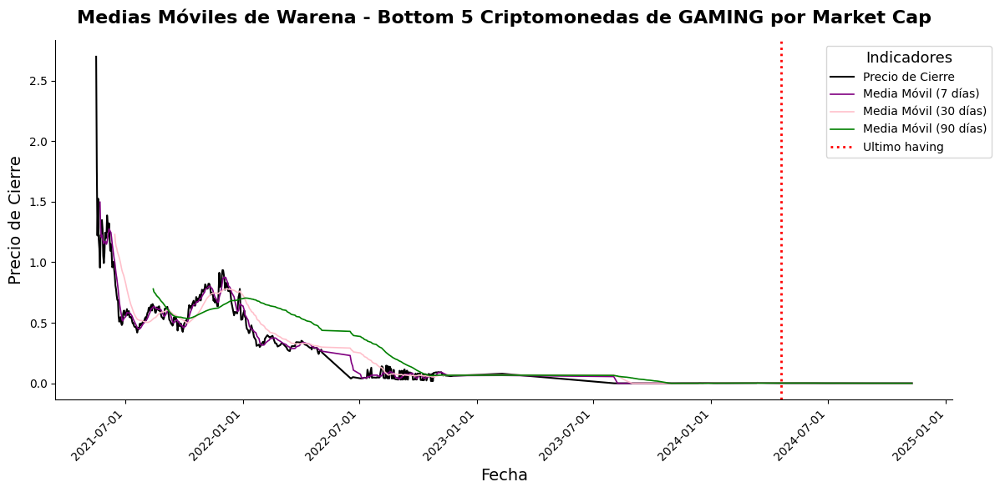

In [82]:
# Precios de Cierre de las 5 criptomonedas con menor Market Cap en cada categoría
media_movel(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
media_movel(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
media_movel(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
media_movel(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

Las gráficas de las criptomonedas con menor capitalización de mercado revelan un comportamiento notoriamente volátil y con patrones de declive prolongado tras picos abruptos de valor. En cada categoría, estas criptomonedas presentan incrementos significativos en el precio en periodos específicos, probablemente impulsados por eventos especulativos o noticias puntuales, seguidos por una caída sostenida que lleva a una estabilidad casi plana en el largo plazo.

En la categoría AI, la gráfica de Arcona muestra cómo los precios alcanzan un pico considerable para luego decaer rápidamente, mientras que las medias móviles a 30 y 90 días reaccionan de manera más lenta, destacando la magnitud de la corrección. 

En cuanto a MEME, Cat Token sigue un patrón similar, con un comportamiento inicial especulativo que pierde fuerza rápidamente, y las medias móviles de 90 días reflejan un ajuste gradual hacia una tendencia plana.

En el caso de RWA, Carnomaly presenta un descenso abrupto tras un pico inicial, mostrando que estas monedas tienden a no sostener niveles de precio altos, y las medias móviles indican cómo las fluctuaciones iniciales son suavizadas a lo largo del tiempo. 

Por último, en GAMING, BabySwap evidencia una dinámica especulativa con máximos repentinos que no se sostienen, lo que deja claro que estas criptomonedas dependen en gran medida del interés momentáneo del mercado.

Volatilidad (Desviación Estándar Móvil de 7 Días) del Precio de Cierre 

In [83]:
def volatilidad(df, title, palette=palette):
    for name, group in df.groupby('name'):
        # Calcular volatilidad (desviación estándar de 7 días)
        volatility = group['close'].rolling(window=7).std()
        
        # Crear la figura
        plt.figure(figsize=(12, 6))
        
        # Graficar la volatilidad
        plt.plot(group['timestamp'], volatility, label='Volatilidad (7 días)', color=palette[1], linewidth=1.5)
        
        # Configuración del título con padding adicional y etiquetas de ejes
        plt.title(f'Volatilidad de {name} - {title}', fontsize=16, fontweight='bold', pad=15)
        plt.xlabel('Timestamp', fontsize=14)  # Usamos 'Timestamp' como etiqueta del eje X
        plt.ylabel('Volatilidad', fontsize=14)
        
        # Ajuste de las etiquetas del eje x sin formatear la fecha
        plt.xticks(rotation=45, ha='right', fontsize=10)
        plt.yticks(fontsize=10)
        
        # Configuración de la leyenda fuera del área del gráfico
        plt.legend(title="Indicador", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1.05, 1))

        # Agregar bordes suaves al gráfico
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        # Ajustar el diseño y mostrar el gráfico
        plt.tight_layout()
        plt.show()

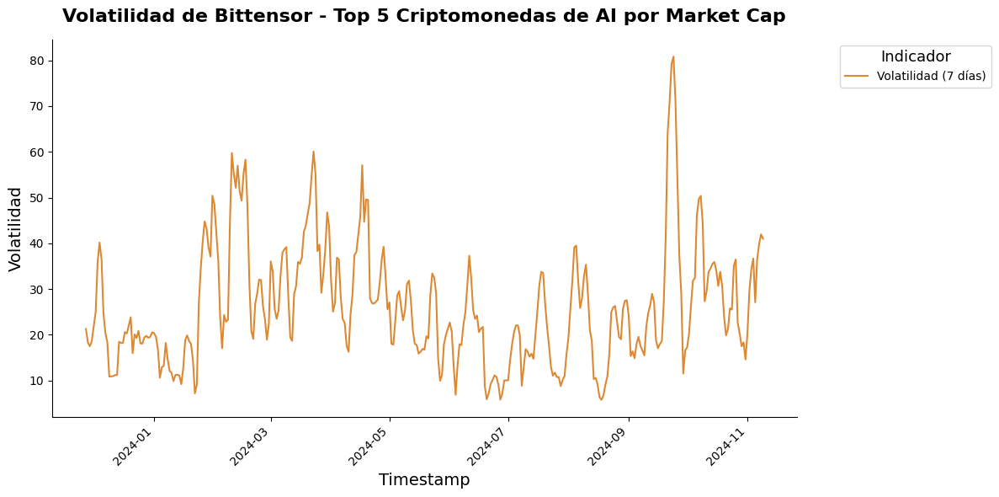

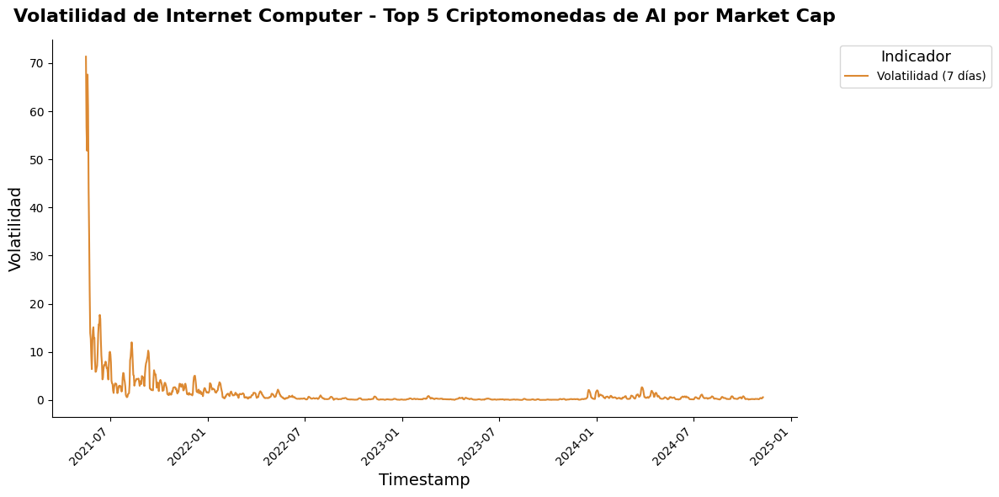

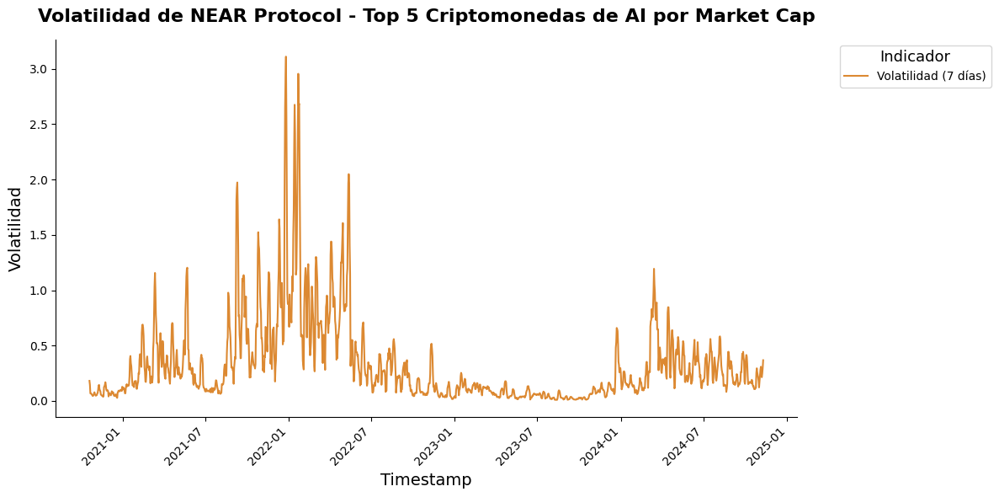

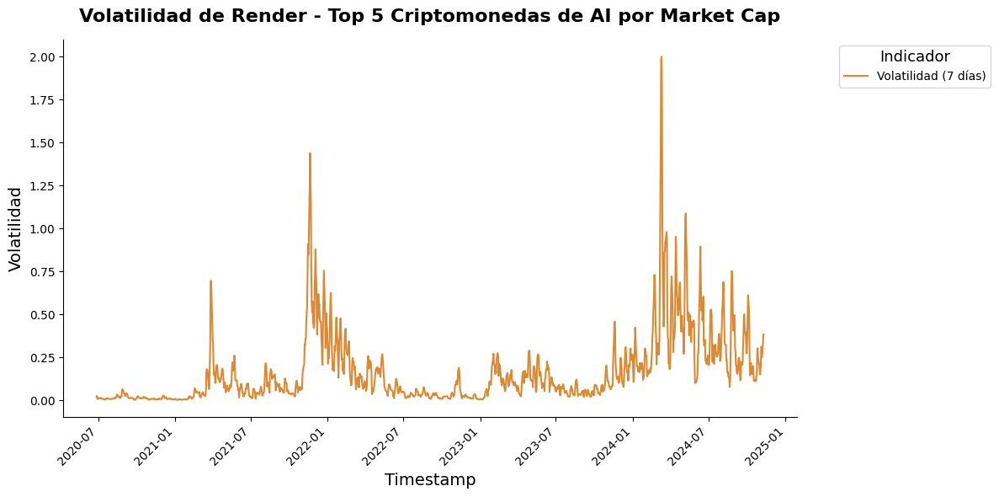

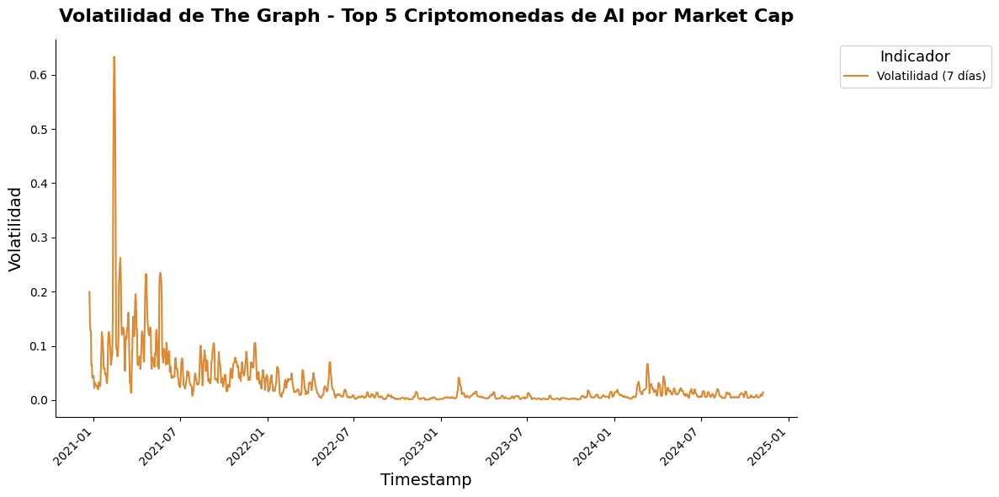

...

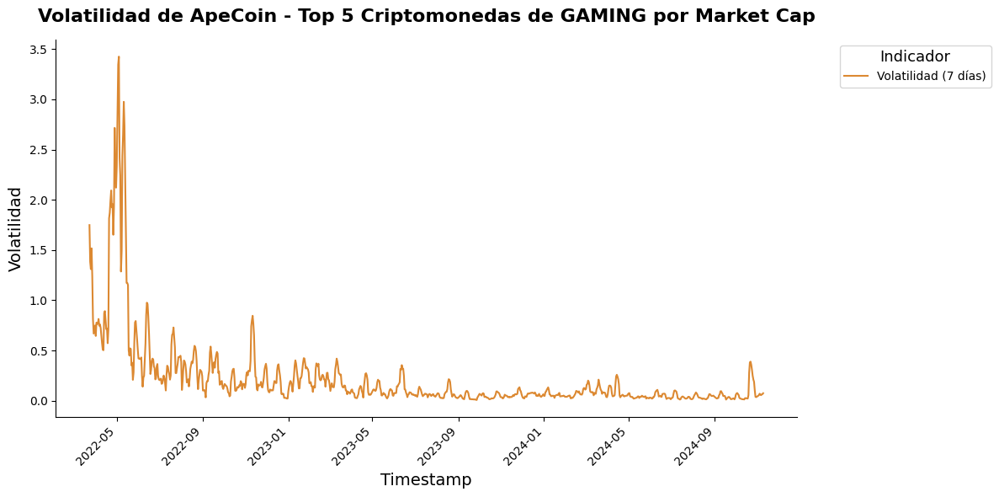

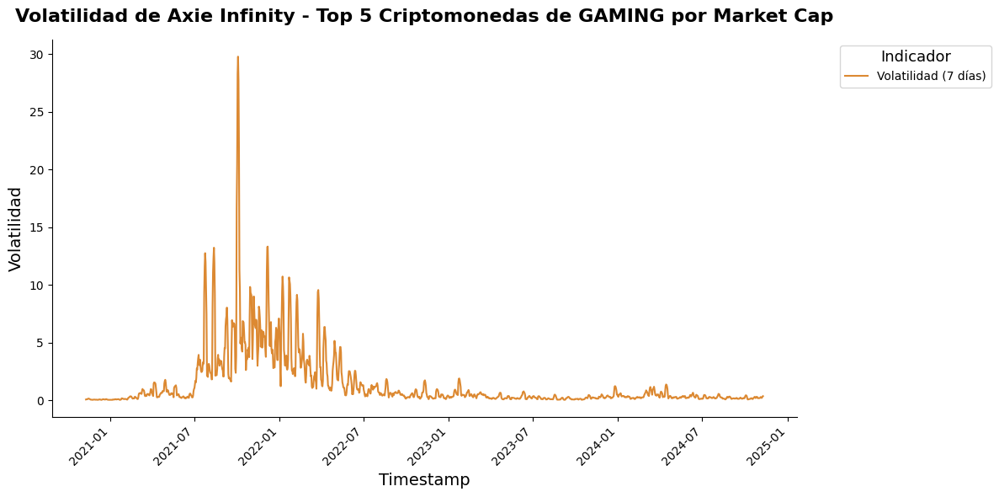

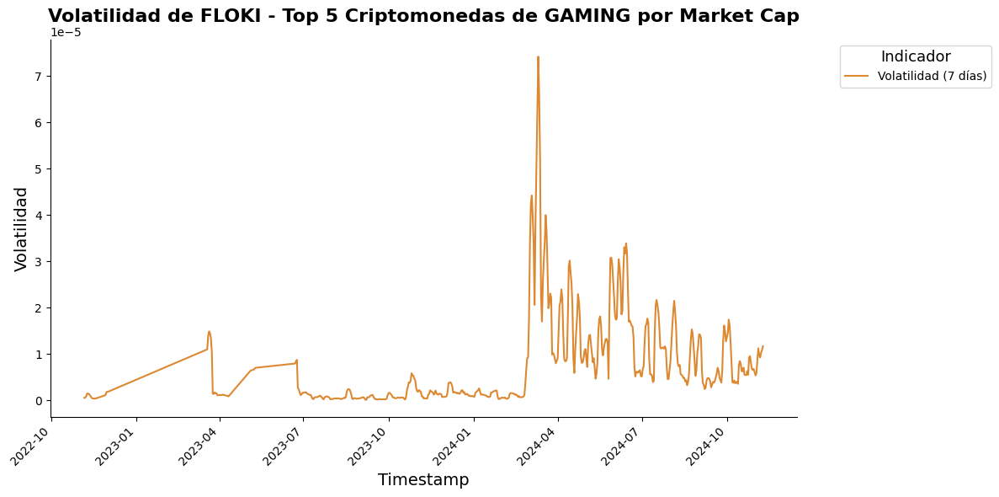

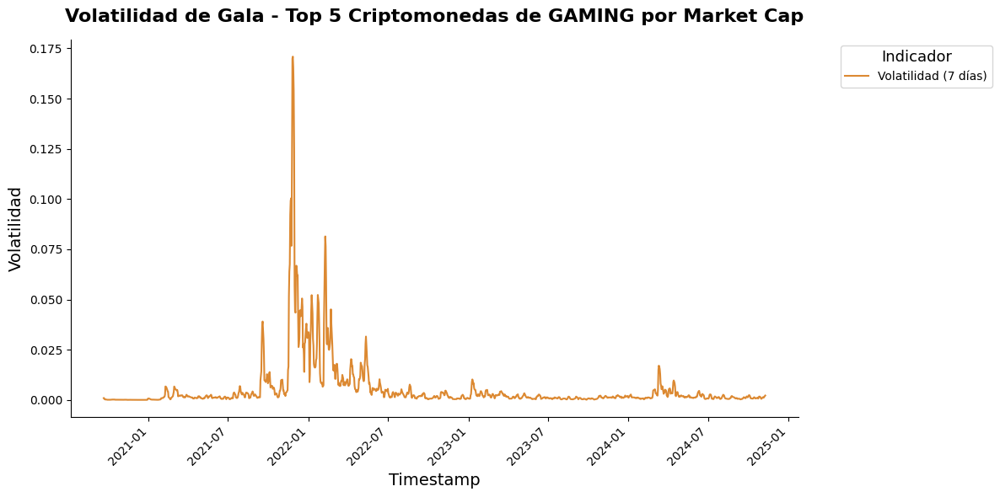

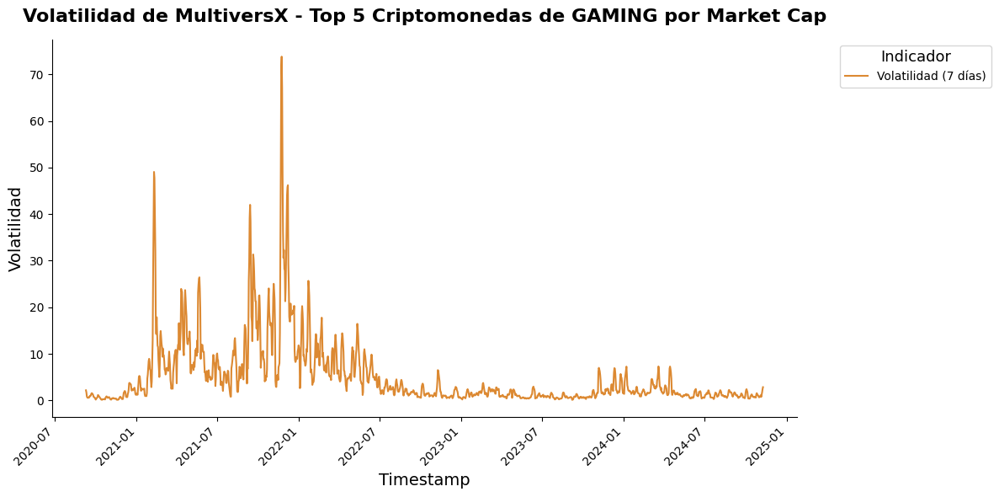

In [84]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
volatilidad(df_ai['top'], "Top 5 Criptomonedas de AI por Market Cap")
volatilidad(df_meme['top'], "Top 5 Criptomonedas de MEME por Market Cap")
volatilidad(df_rwa['top'], "Top 5 Criptomonedas de RWA por Market Cap")
volatilidad(df_gaming['top'], "Top 5 Criptomonedas de GAMING por Market Cap")

Las gráficas de volatilidad muestran el comportamiento de las fluctuaciones en los precios de cierre de las principales criptomonedas en las categorías de AI, MEME, RWA y GAMING. 

En la categoría AI, la volatilidad experimenta picos significativos en ciertos periodos, lo que sugiere sensibilidad a eventos externos o movimientos especulativos. Sin embargo, estos picos tienden a estabilizarse rápidamente, indicando cierto nivel de madurez en el mercado.

En MEME, los niveles de volatilidad son más amplios y prolongados, reflejando la naturaleza especulativa y dependiente de la popularidad de estas monedas. La volatilidad alcanza valores extremos durante eventos puntuales, pero mantiene oscilaciones incluso en periodos de calma relativa, destacando su inestabilidad inherente.

En RWA, la volatilidad muestra una tendencia decreciente a lo largo del tiempo, pasando de fluctuaciones significativas a niveles más moderados. Esto podría estar relacionado con una consolidación del mercado o una menor especulación en esta categoría. 

Finalmente, en GAMING, la volatilidad es inicialmente alta, con picos pronunciados en los primeros periodos analizados, pero disminuye notablemente, reflejando una reducción en la actividad especulativa y una estabilización en los precios de estas criptomonedas.

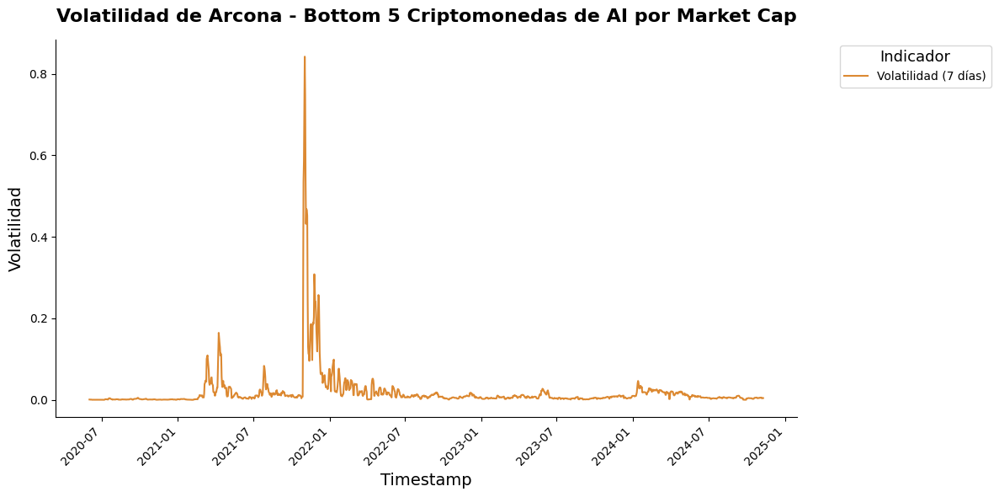

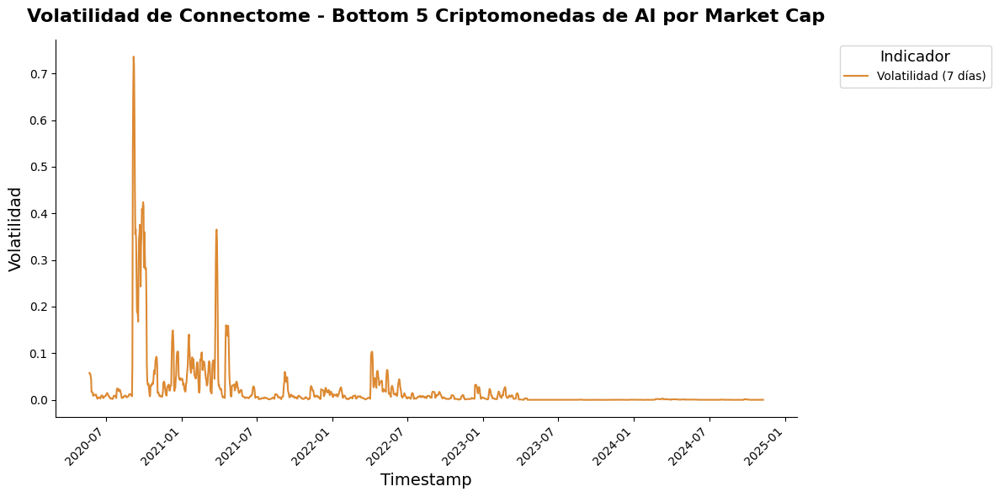

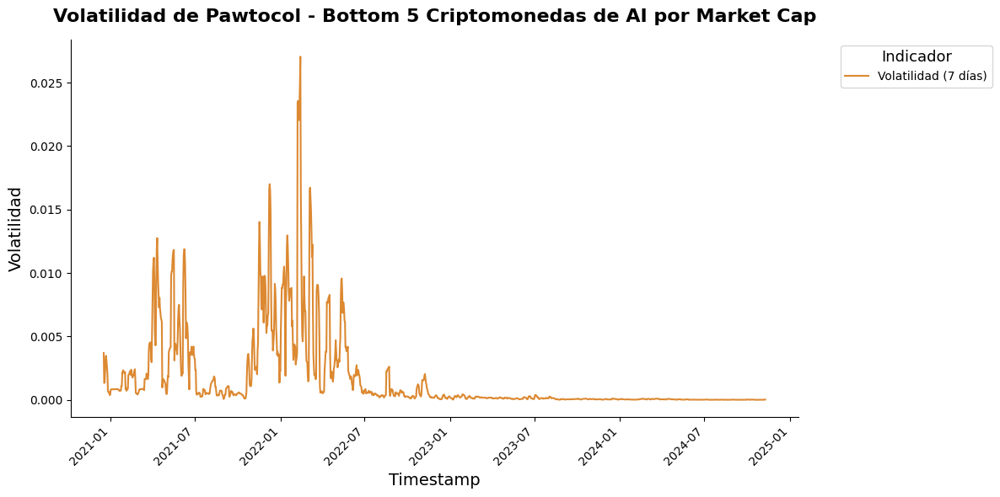

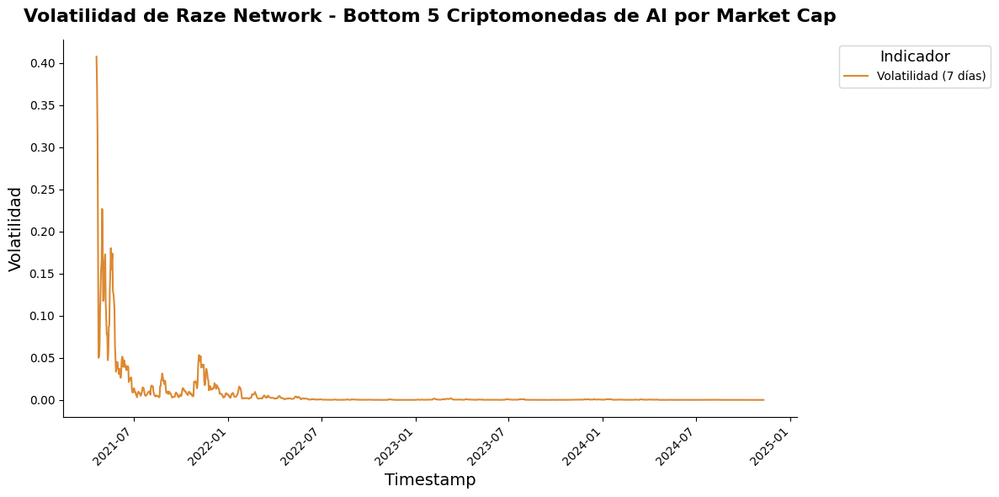

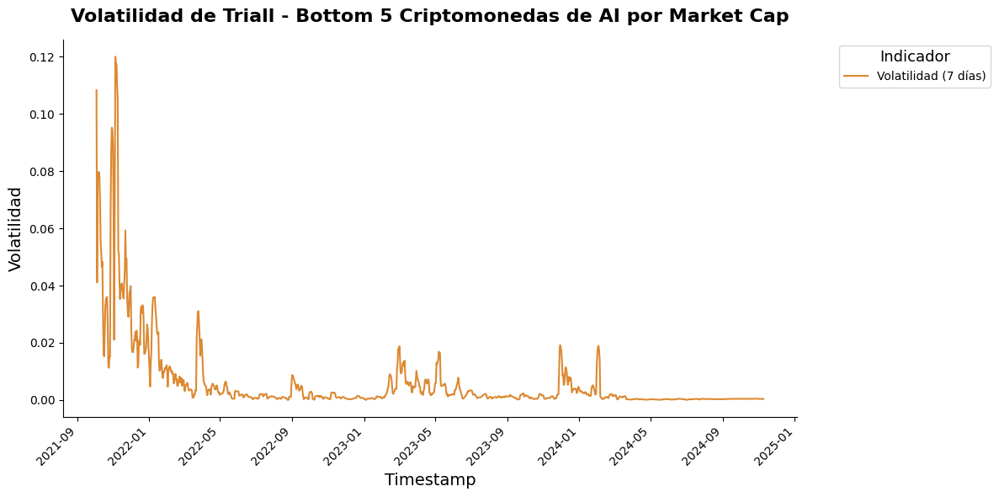

...

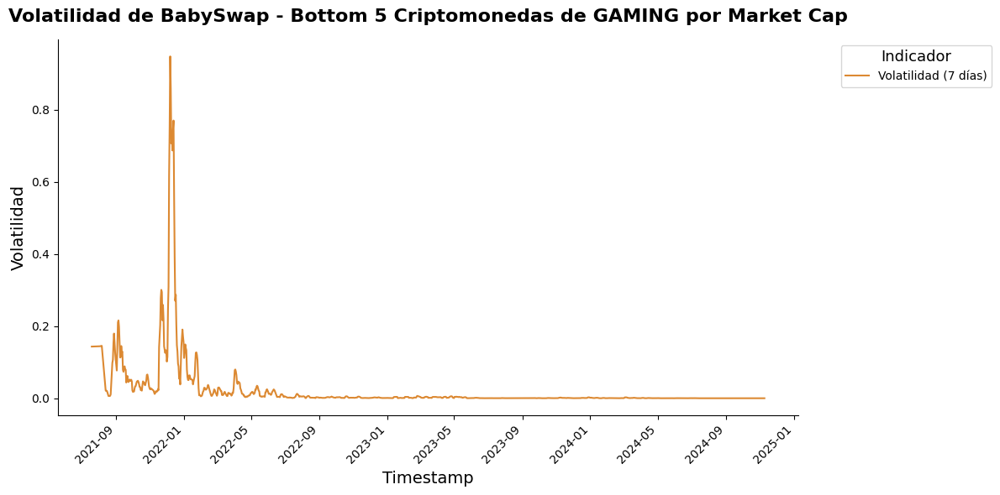

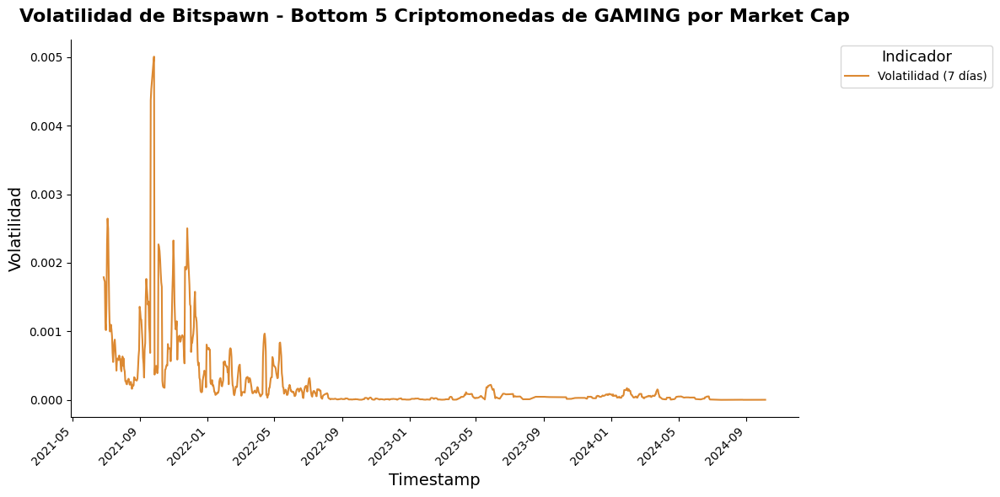

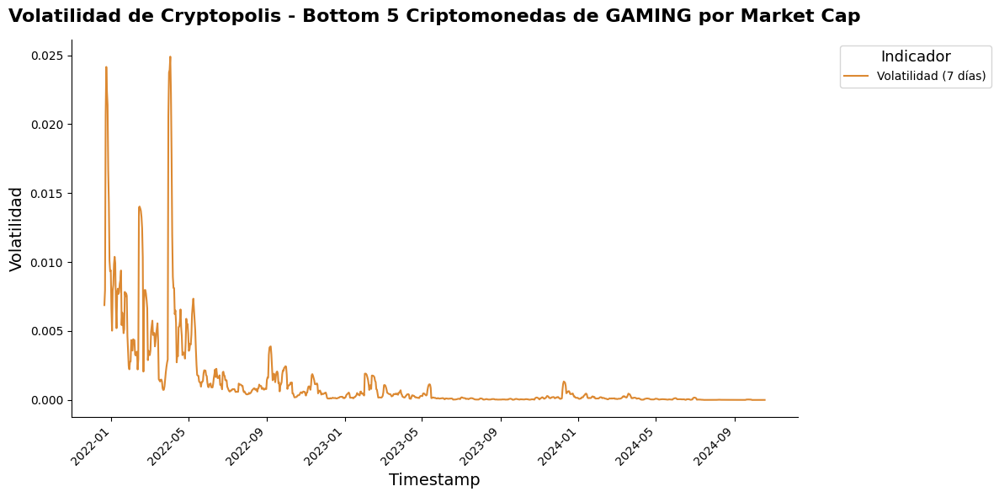

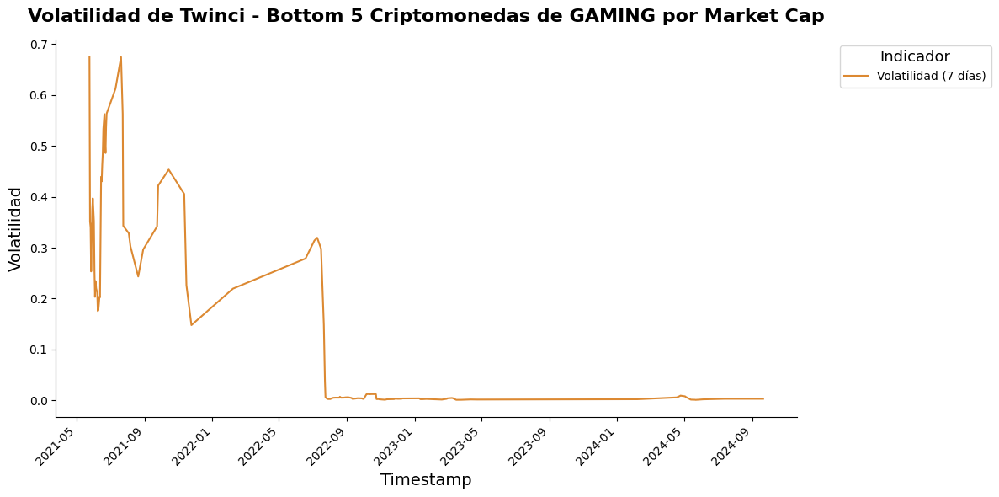

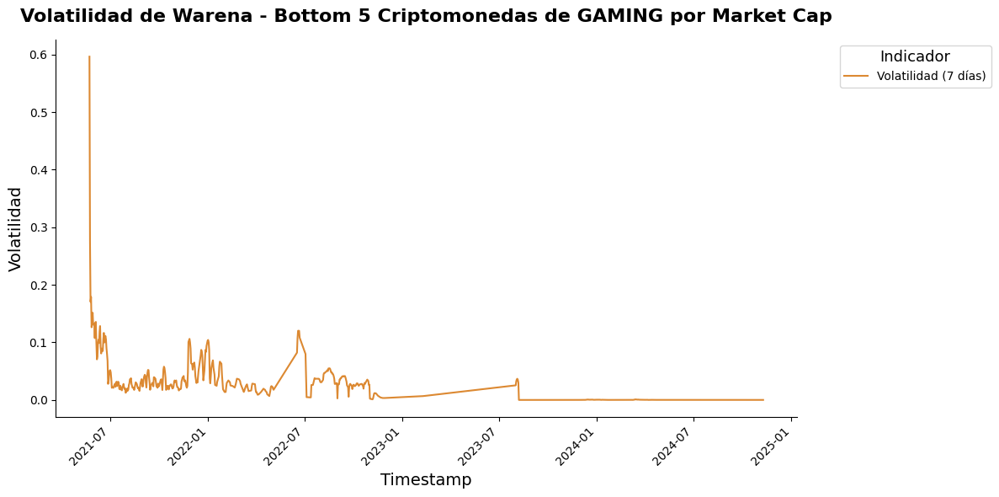

In [85]:
volatilidad(df_ai['bottom'], "Bottom 5 Criptomonedas de AI por Market Cap")
volatilidad(df_meme['bottom'], "Bottom 5 Criptomonedas de MEME por Market Cap")
volatilidad(df_rwa['bottom'], "Bottom 5 Criptomonedas de RWA por Market Cap")
volatilidad(df_gaming['bottom'], "Bottom 5 Criptomonedas de GAMING por Market Cap")

Las gráficas de volatilidad para las criptomonedas con menor capitalización de mercado muestran patrones característicos de activos con baja estabilidad y alta especulación. 

En la categoría AI, la volatilidad de Arcona alcanza un pico extremo durante un breve periodo, seguido de una rápida caída hacia niveles bajos y constantes, lo que indica una reacción a eventos específicos y una falta de actividad sostenida en el mercado.

Luego en MEME, la gráfica de Cat Token refleja un comportamiento similar, con un aumento pronunciado en la volatilidad durante un periodo especulativo, para luego estabilizarse en valores casi nulos, lo que evidencia su limitada relevancia en el mercado tras el interés inicial. 

Por otro lado en la categoría RWA, representada por Carnomaly, muestra una rápida reducción en la volatilidad después de un periodo inicial de fluctuaciones, lo que sugiere un mercado con escasa actividad y un interés decreciente.

Finalmente, en GAMING, la volatilidad de BabySwap se caracteriza por un pico significativo al principio del periodo analizado, seguido por una tendencia a la estabilidad. Este comportamiento destaca la naturaleza especulativa inicial de estas monedas y la falta de soporte a largo plazo.

Descomposición STL (descomposición de tendencias estacionales utilizando LOESS)

In [86]:
def add_stl_plot(fig, res, colors, legend):
    axs = fig.get_axes()
    components = ["trend", "seasonal", "resid"]
    
    # Fecha del halving
    halving_date = pd.to_datetime("2024-04-19")
    
    for ax, comp, color in zip(axs[1:], components, colors):
        series = getattr(res, comp)
        
        # Graficar la serie con color específico y estilo
        if comp == "resid":
            ax.plot(series, marker="o", linestyle="none", markersize=3, color=color, alpha=0.7, label="Residuales")
        else:
            ax.plot(series, color=color, linewidth=1.5, label=comp.capitalize())
            
            # Añadir leyenda solo en la tendencia
            if comp == "trend":
                ax.legend(legend + ["Fecha del Halving (19 de Abril de 2024)"], frameon=False, loc='upper left', bbox_to_anchor=(1, 1))
                
        ax.axvline(halving_date, color="red", linestyle="--", linewidth=1, label="Fecha del Halving (19 de Abril de 2024)")

In [87]:
def stl_decomposition(df, palette=palette):
    # Convertir 'timestamp' a formato de fecha y establecerlo como índice
    df['date'] = pd.to_datetime(df['timestamp'], unit='s')
    df.set_index('date', inplace=True)

    for name, group in df.groupby('name'):
        # Realizar la descomposición STL con y sin robustez
        stl_robust = STL(group['close'], period=30, robust=True).fit()
        stl_non_robust = STL(group['close'], period=30, robust=False).fit()
        
        # Crear la figura
        fig = stl_robust.plot()
        fig.set_size_inches(14, 10)
        
        # Asignar colores para las versiones robusta y no robusta
        robust_colors = [palette[0], palette[1], palette[2]]
        non_robust_colors = [palette[3], palette[4], palette[5]]
        
        # Añadir la descomposición sin robustez con colores variables
        add_stl_plot(fig, stl_non_robust, non_robust_colors, ["Robust", "Non-robust"])
        add_stl_plot(fig, stl_robust, robust_colors, ["Robust", "Non-robust"])
        
        # Ajustes estéticos de los ejes y títulos
        for ax in fig.get_axes():
            ax.set_title(ax.get_title(), fontsize=10, pad=10)  # Títulos de los componentes con padding
            ax.set_xlabel("Fecha", fontsize=10)  # Etiqueta de eje X como "Fecha"
            ax.set_ylabel(ax.get_ylabel(), fontsize=10)
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))  # Formato de fecha en eje X
            plt.setp(ax.get_xticklabels(), rotation=45, ha="right")  # Rotar las etiquetas de fecha para mejor legibilidad
        
        # Configuración del título principal con padding adicional
        fig.suptitle(f'Descomposición de {name}', fontsize=14, fontweight='bold', y=1.02)
        
        # Ajustar diseño para evitar superposición
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)  # Ajuste del espacio superior para el título
        plt.show()


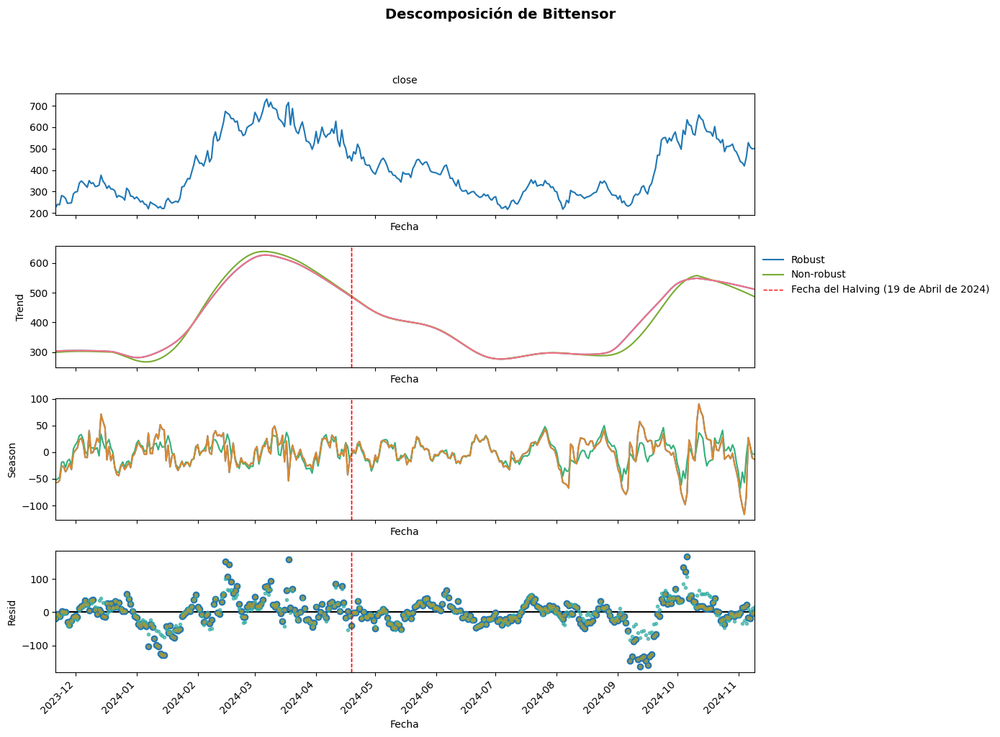

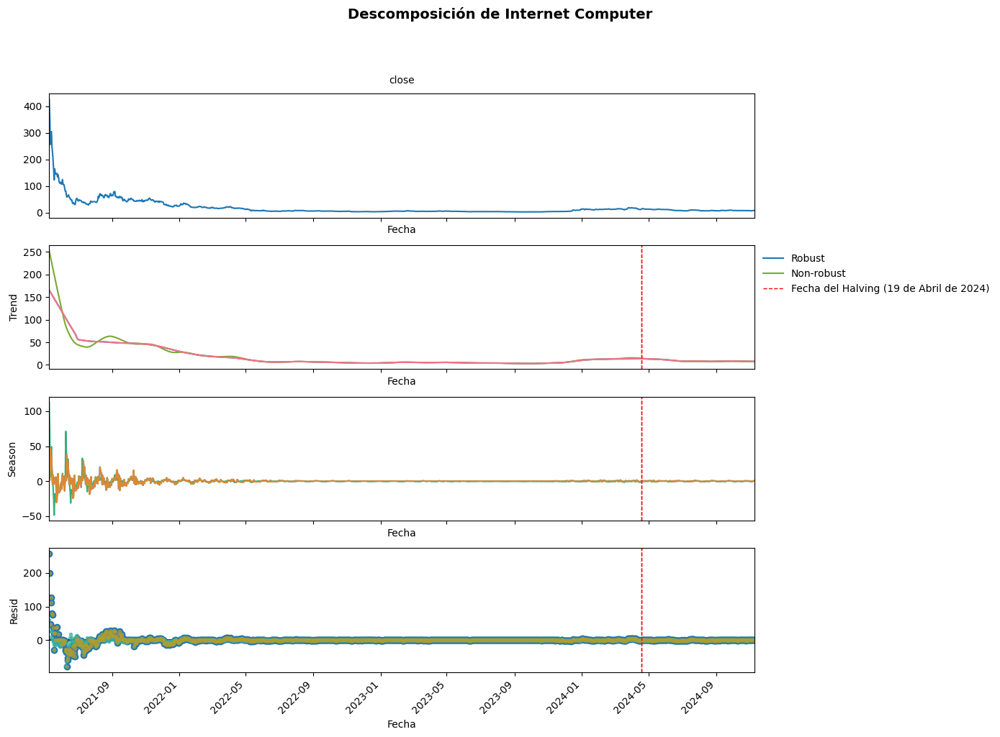

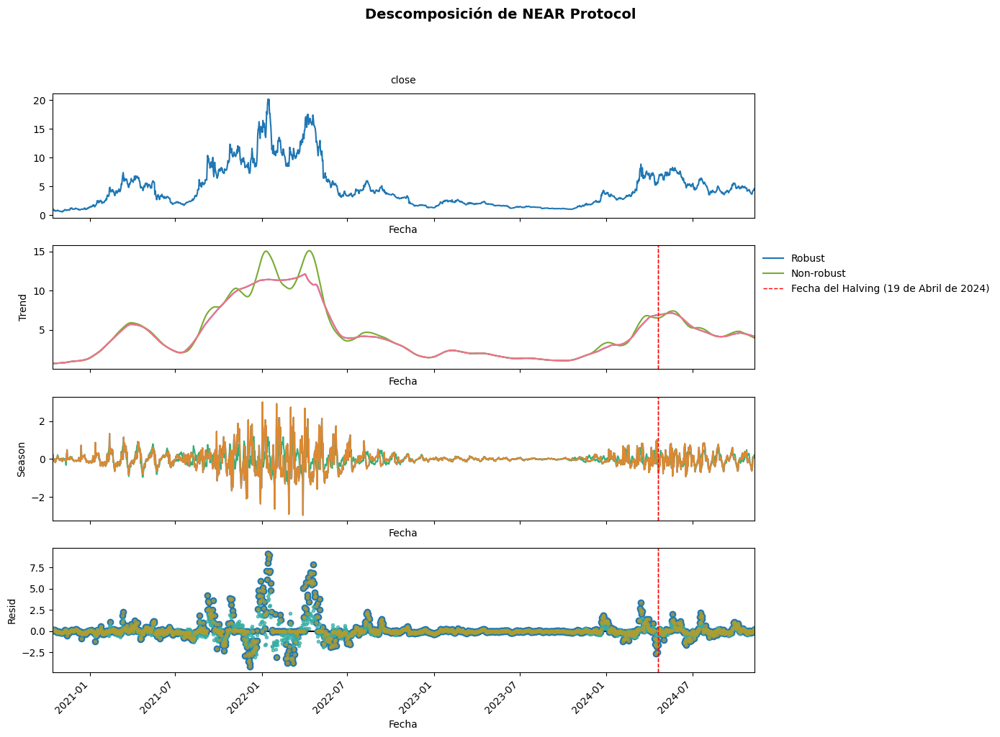

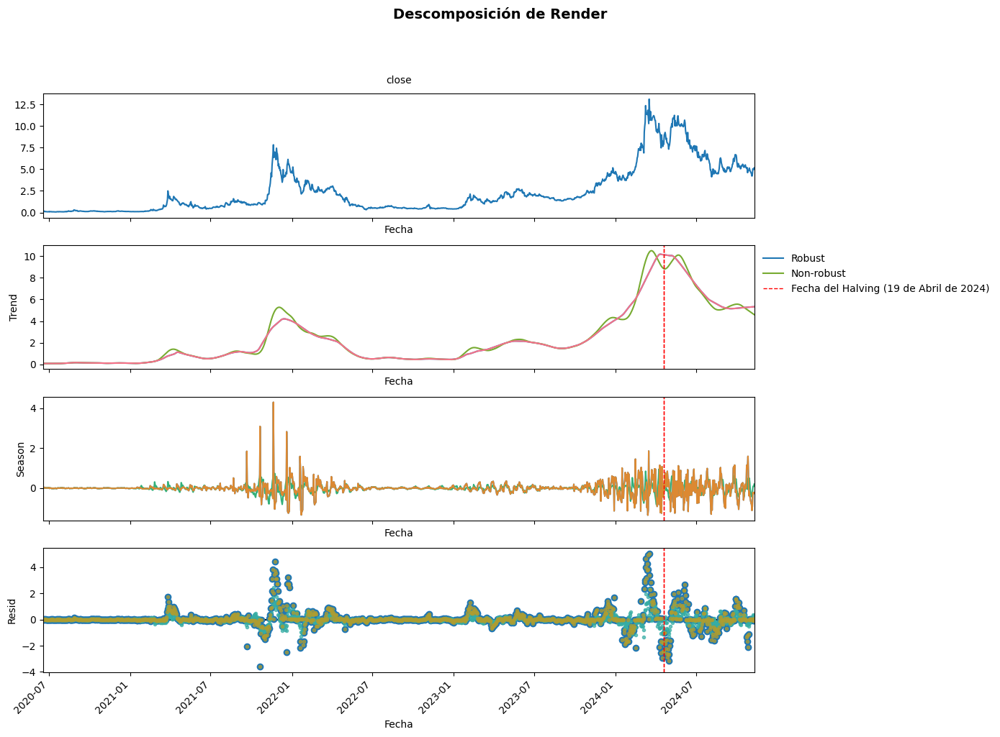

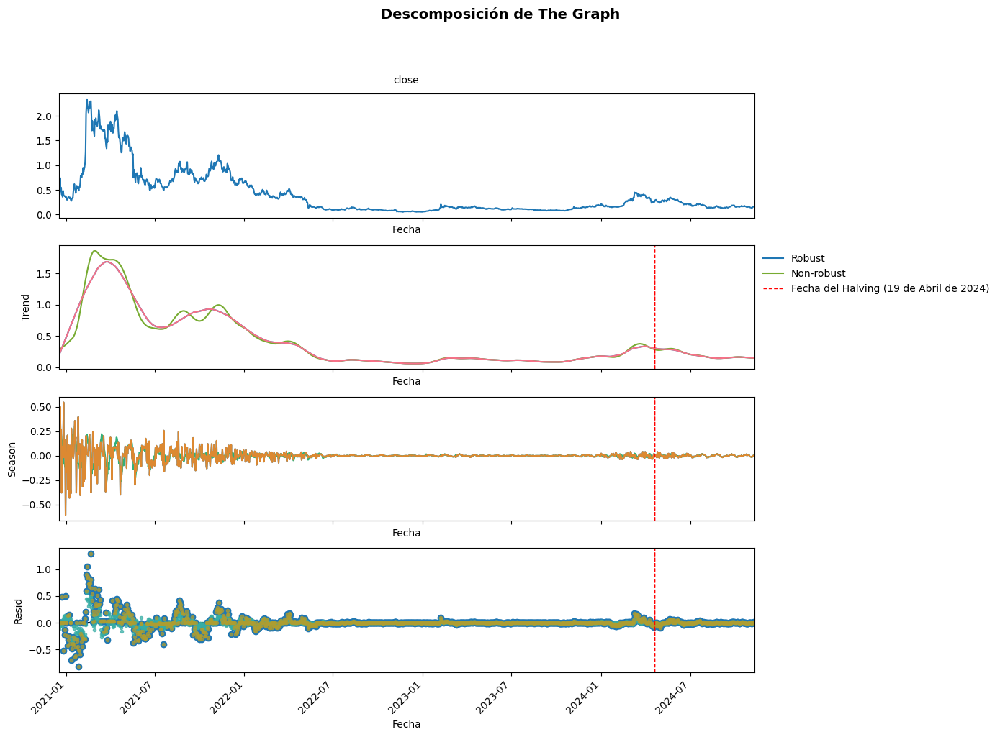

...

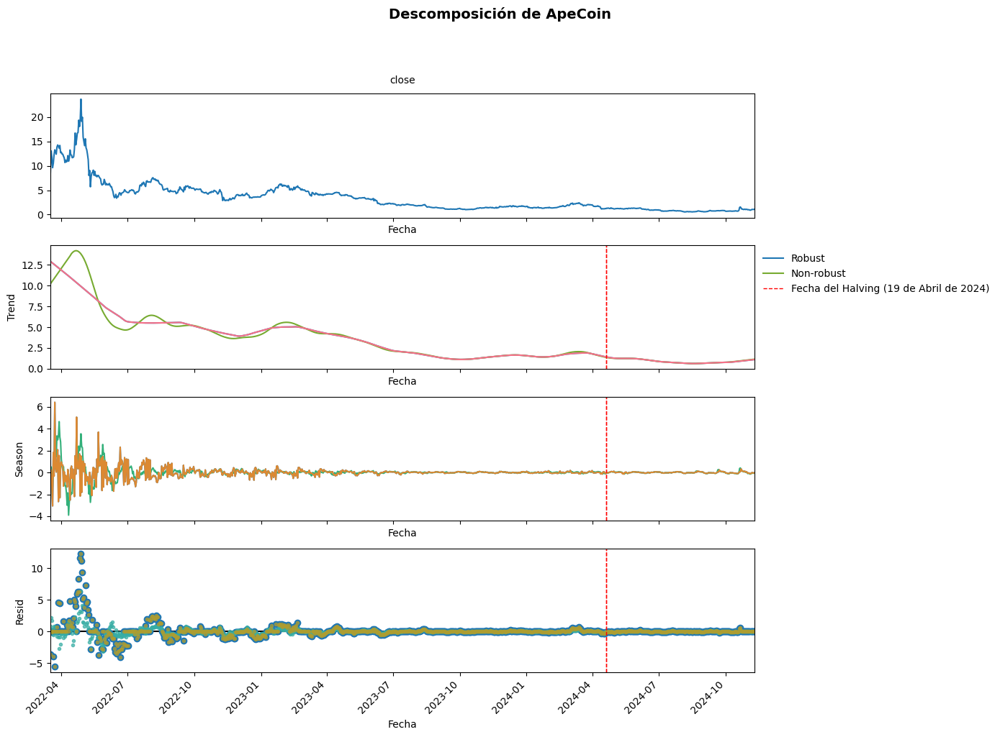

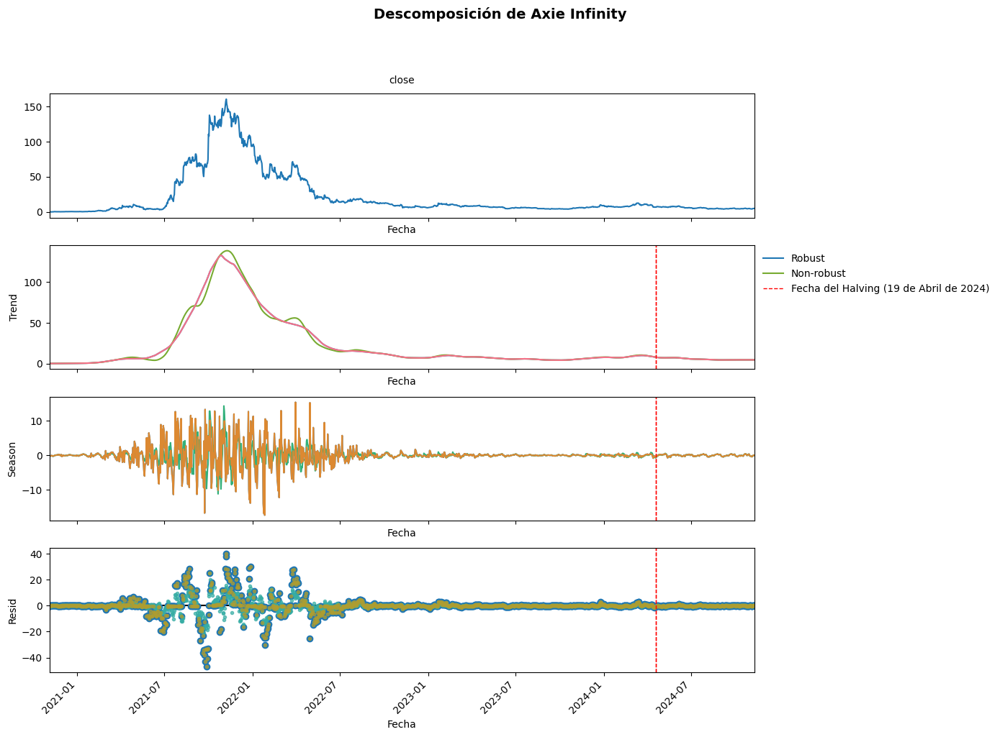

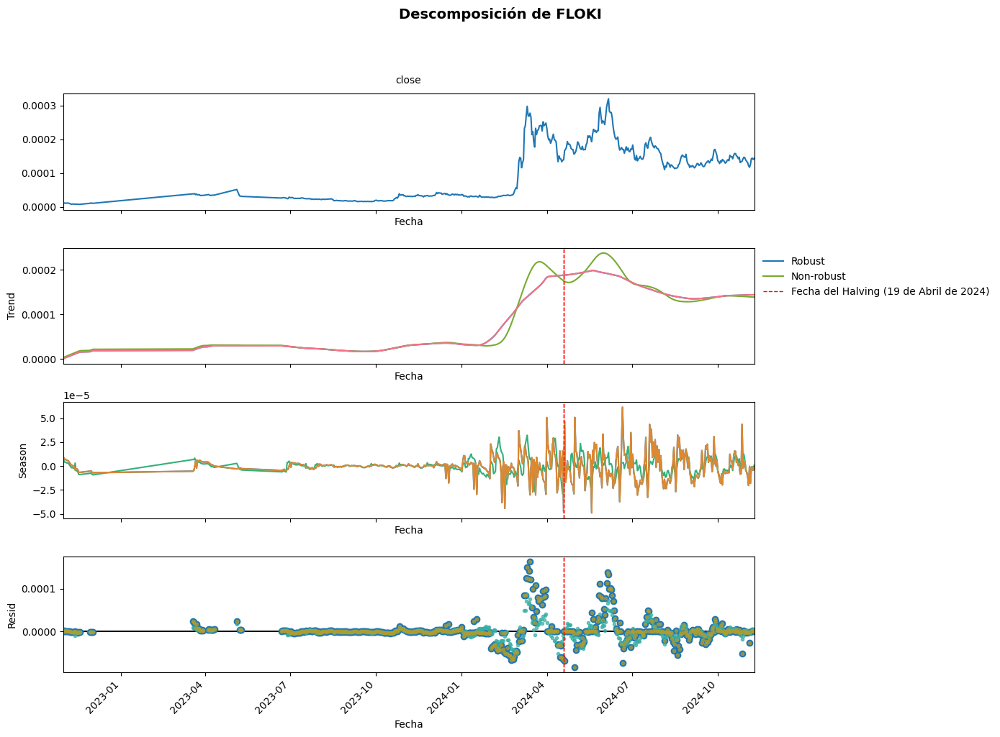

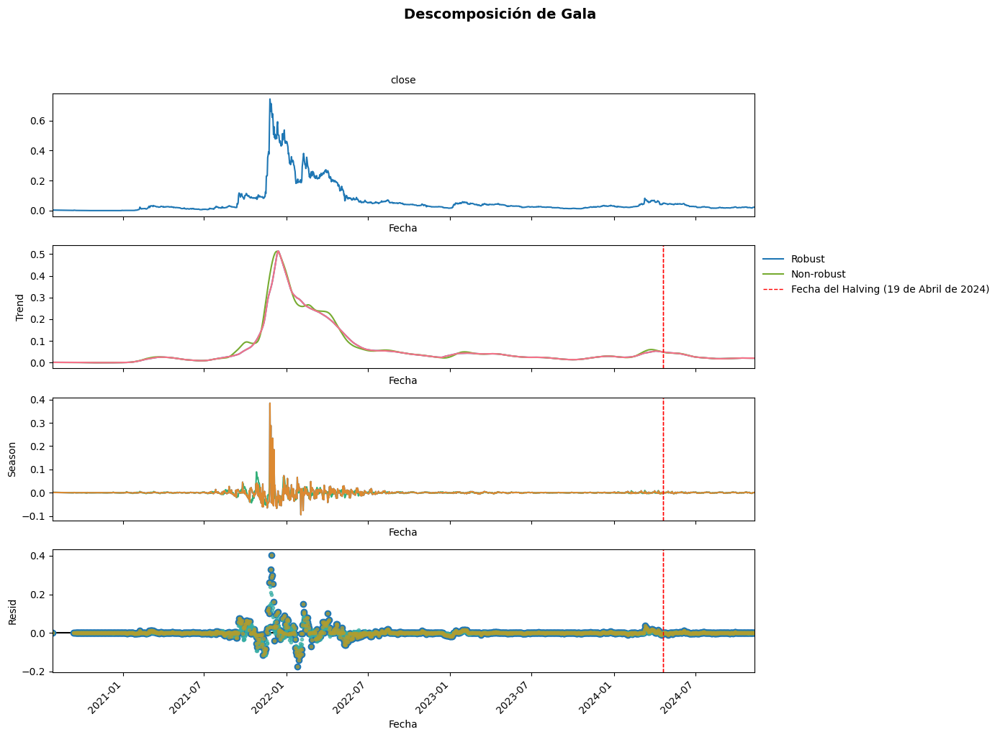

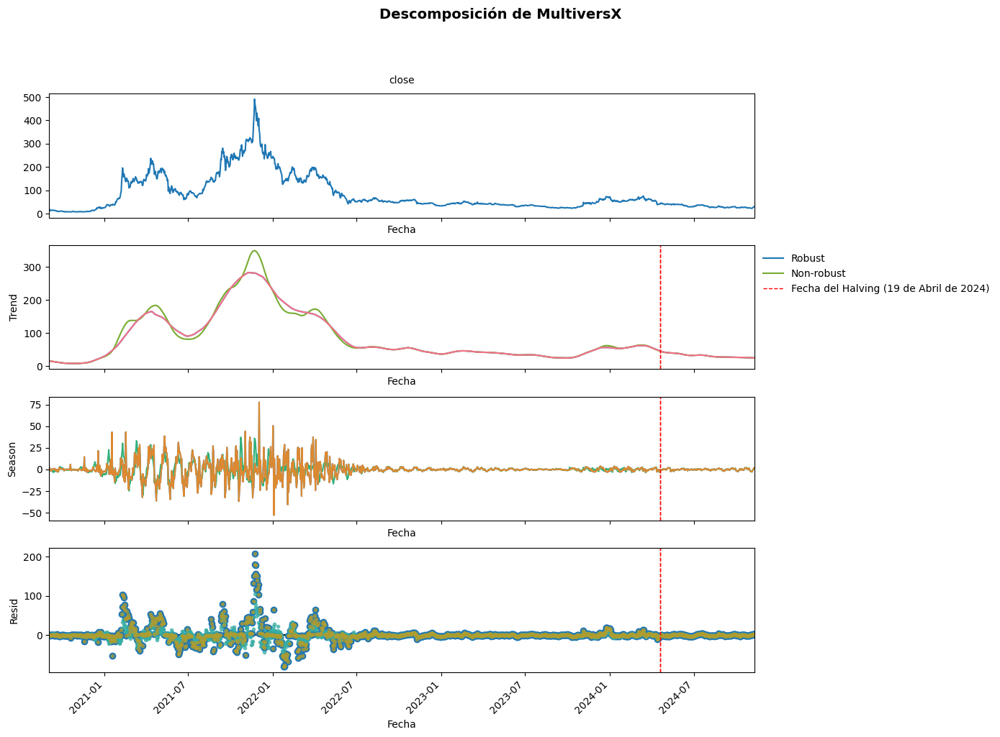

In [88]:
# Precio de Cierre de las 5 criptomonedas con mayor Market Cap en cada categoría
stl_decomposition(df_ai['top'])
stl_decomposition(df_meme['top'])
stl_decomposition(df_rwa['top'])
stl_decomposition(df_gaming['top'])

Las gráficas de descomposición STL muestran claramente los diferentes componentes de las series temporales para las criptomonedas seleccionadas en cada categoría. Se descomponen en tendencia, componente estacional y residuos, permitiendo observar patrones más claros y cómo se relacionan con eventos específicos, como el halving señalado por la línea roja.

En el caso de la tendencia, se puede observar el crecimiento, los picos y las caídas para cada criptomoneda. Por ejemplo, en Bittensor y Bonk, se evidencia un fuerte aumento en sus valores seguidos de caídas graduales, mientras que Avalanche muestra un ciclo de alzas más prolongado antes de estabilizarse. Estas tendencias permiten identificar momentos clave en el tiempo y posibles impactos de eventos como el halving.

El componente estacional refleja oscilaciones recurrentes, mostrando patrones que pueden estar vinculados a comportamientos del mercado o a ciclos externos. En Bonk y ApeCoin, se observan variaciones más marcadas en la estacionalidad, lo que sugiere que estas criptomonedas están sujetas a mayores fluctuaciones regulares.

Finalmente, los residuos destacan las irregularidades o movimientos impredecibles. La dispersión de los puntos alrededor de cero indica volatilidad residual y permite identificar periodos de alta incertidumbre. Por ejemplo, las gráficas muestran que los residuos aumentan en proximidad al halving, lo que sugiere una mayor incertidumbre o especulación en esos momentos.

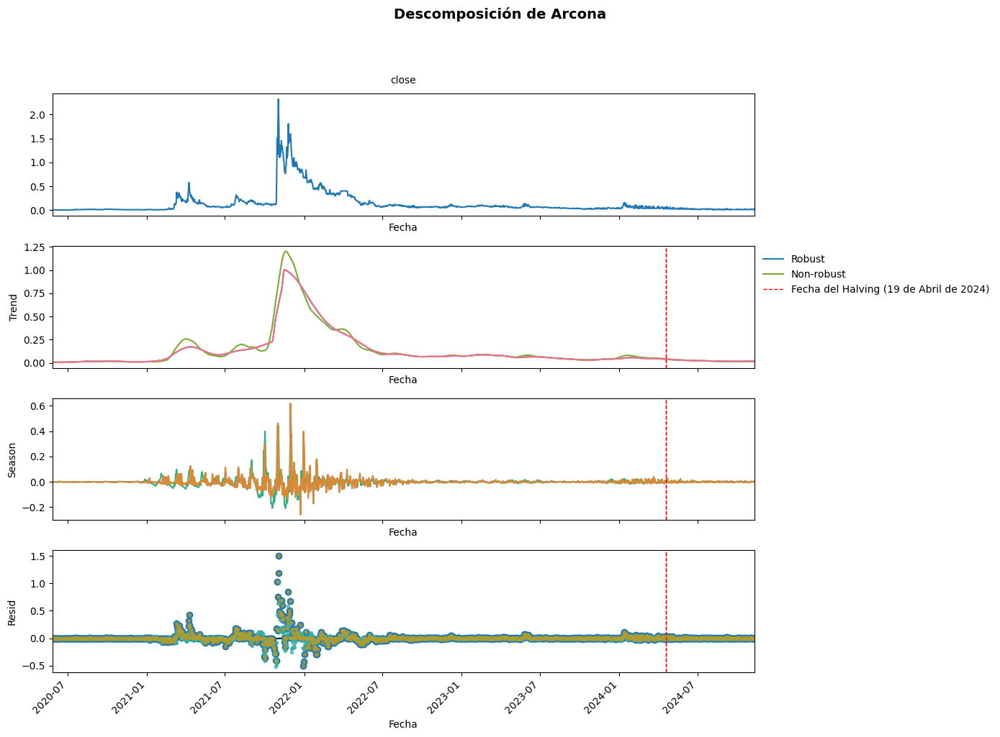

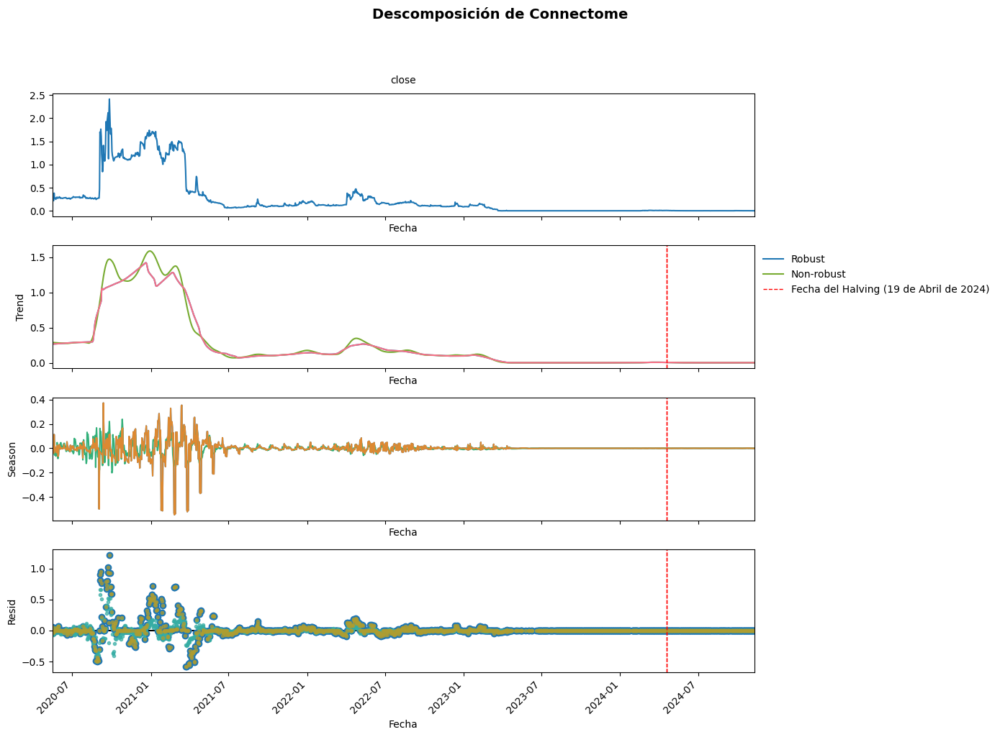

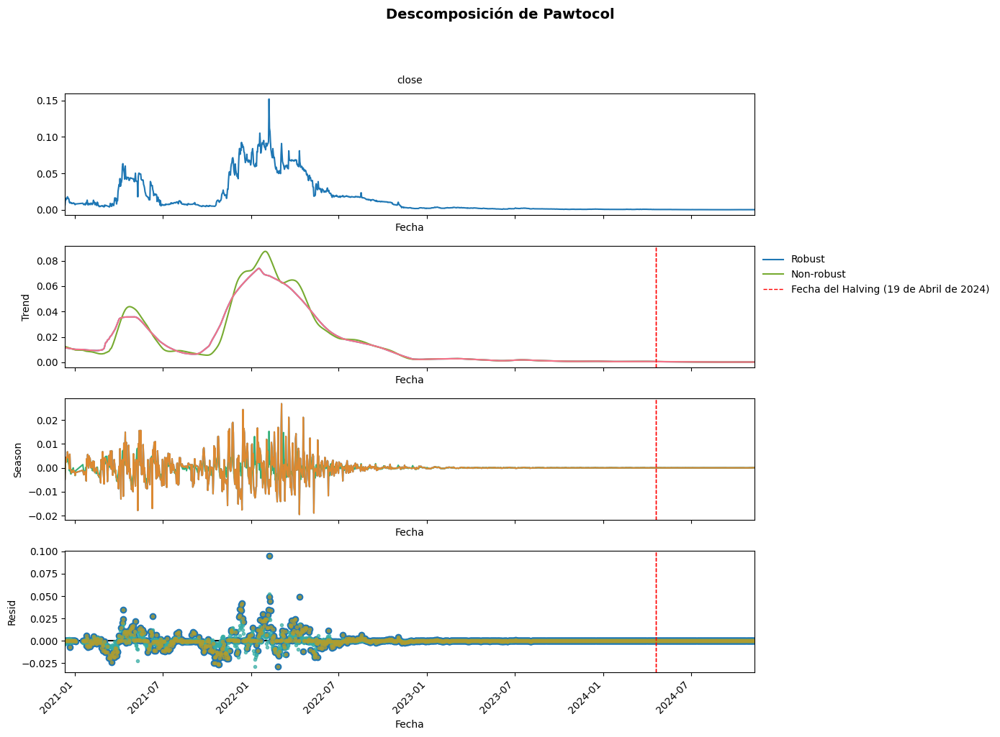

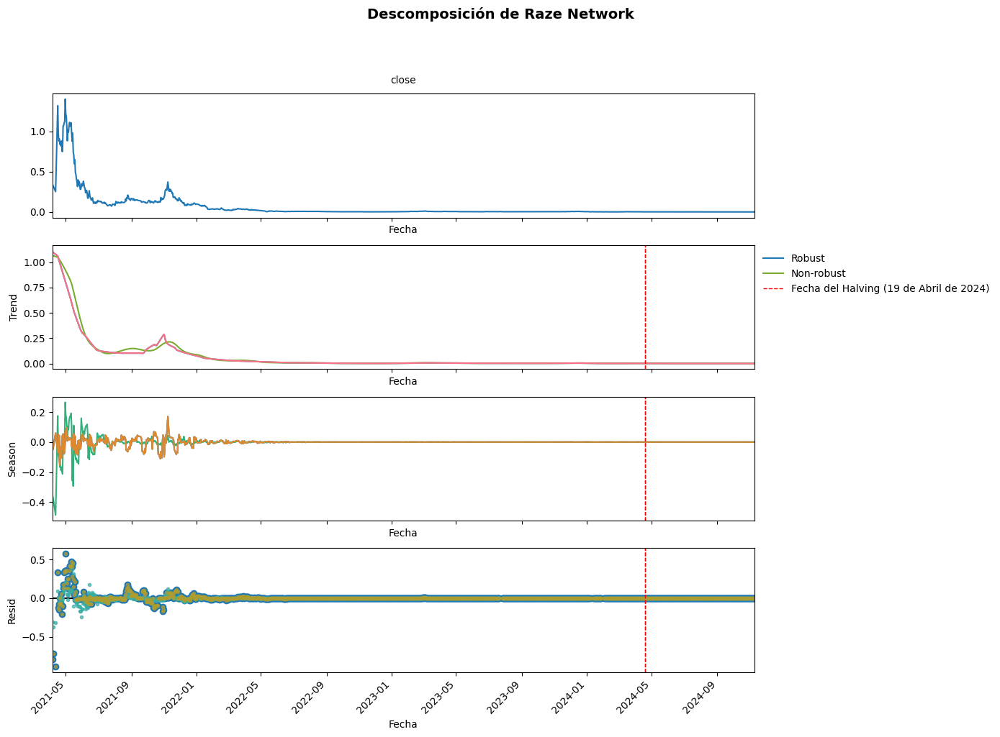

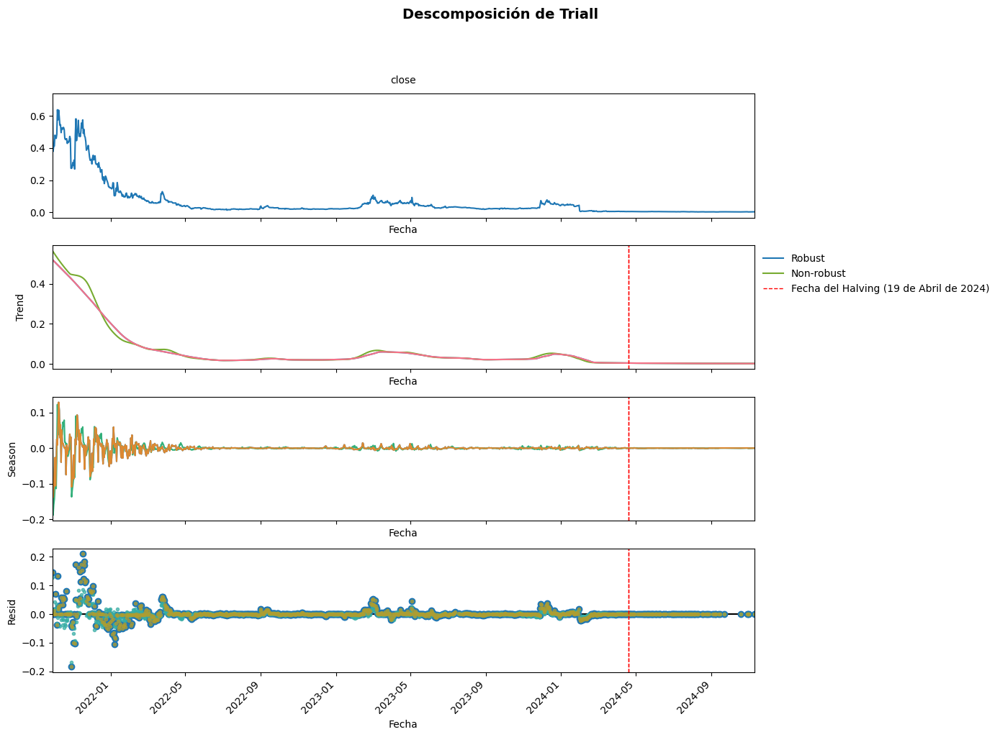

...

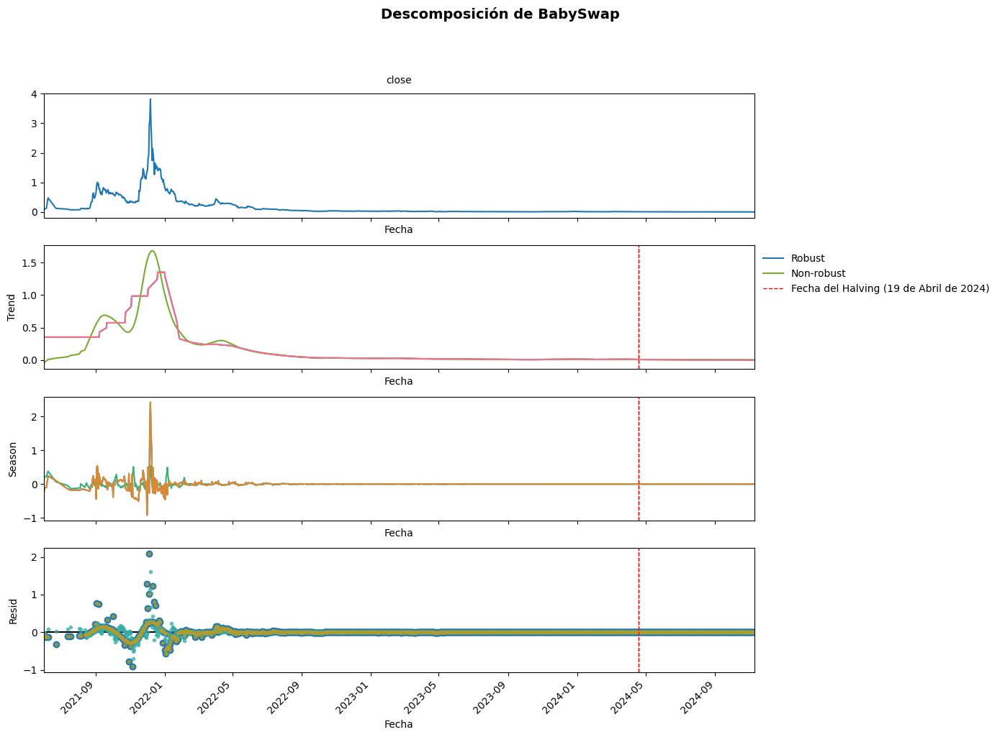

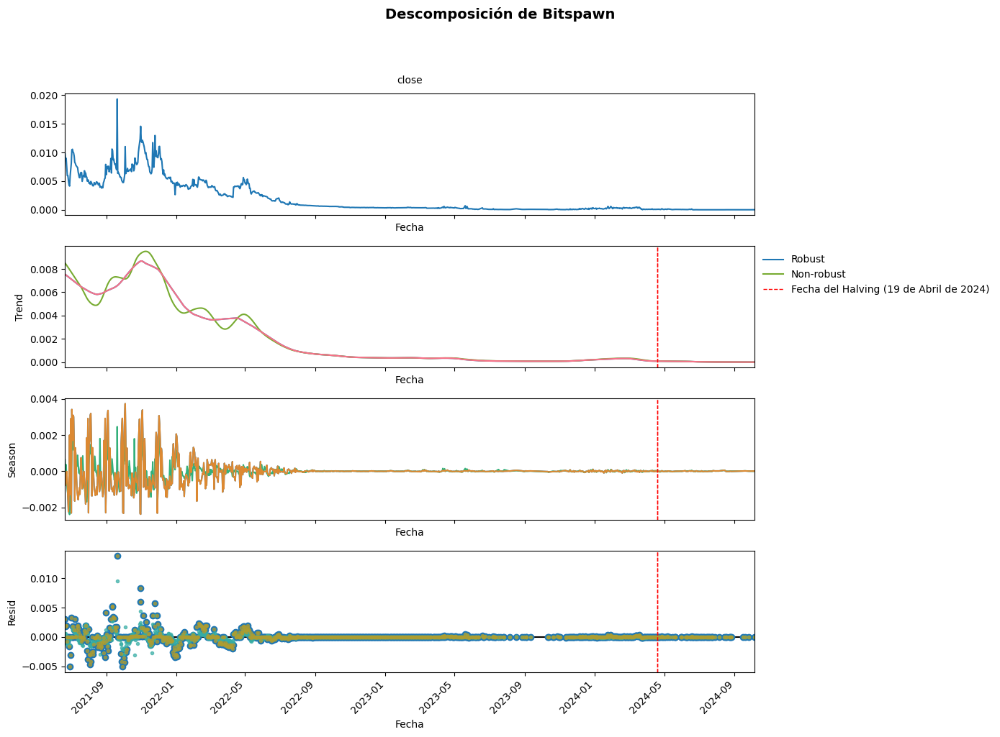

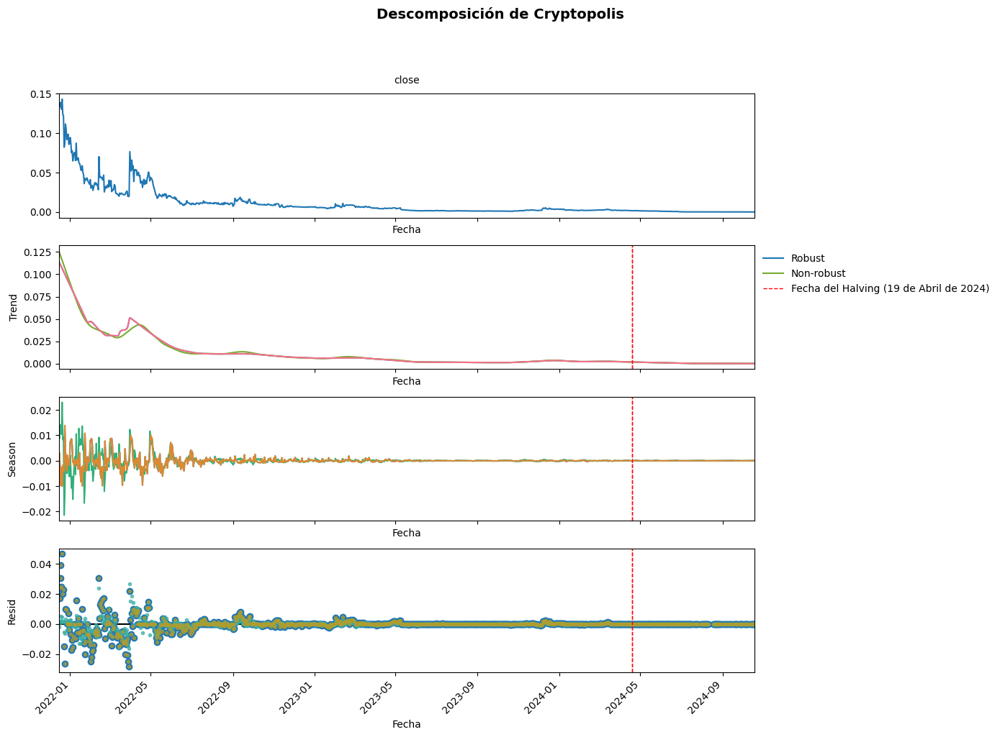

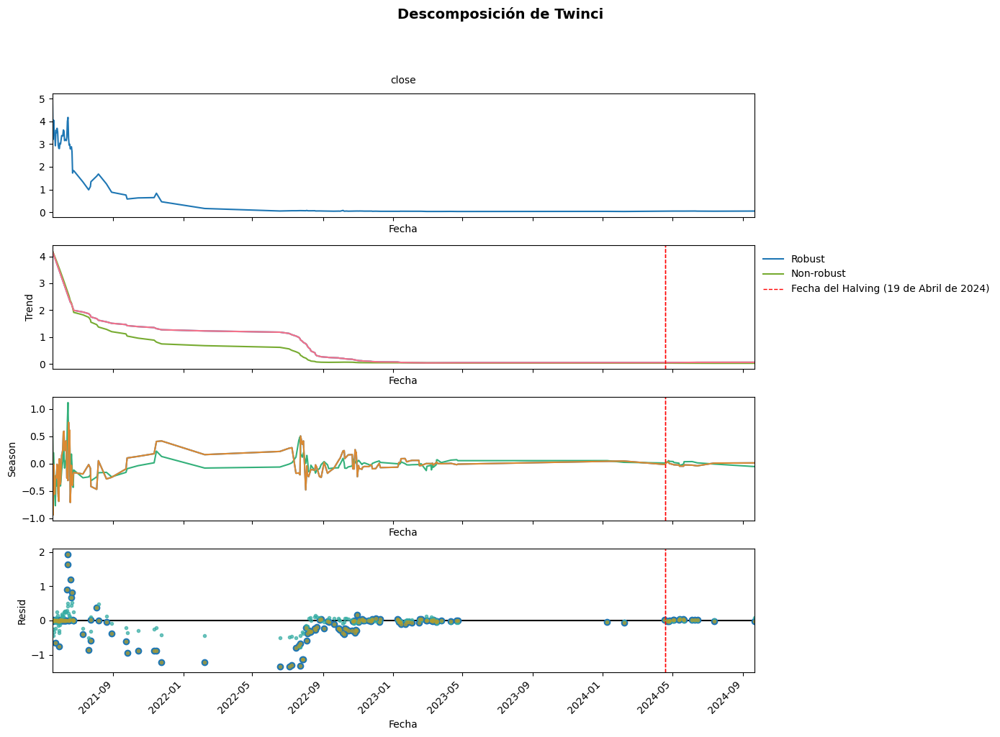

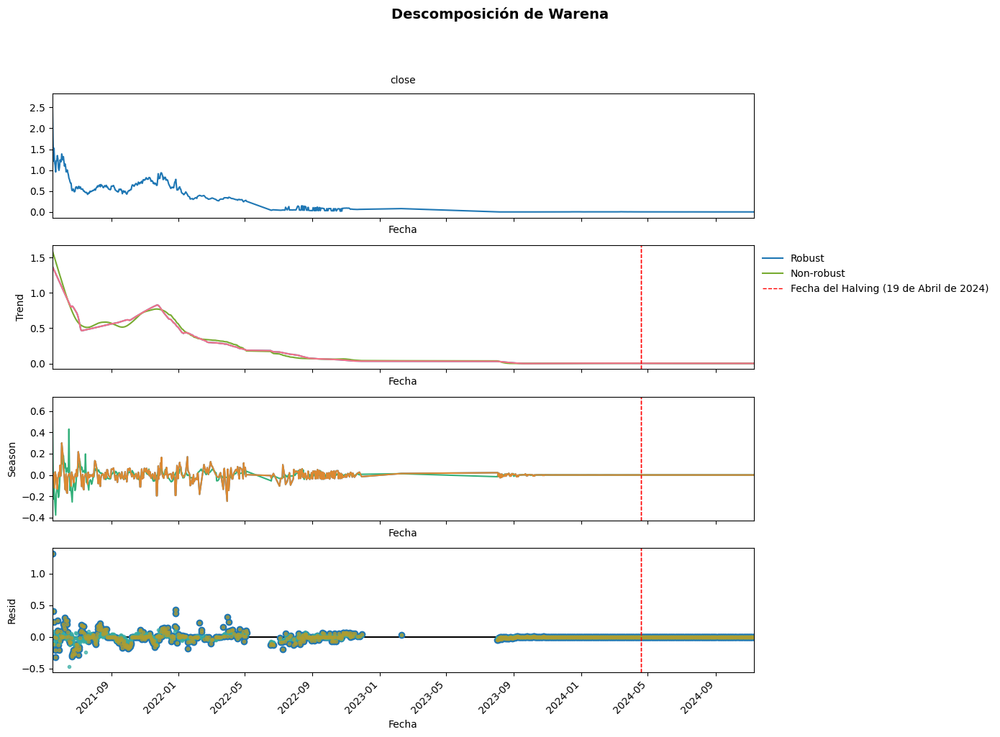

In [89]:
stl_decomposition(df_ai['bottom'])
stl_decomposition(df_meme['bottom'])
stl_decomposition(df_rwa['bottom'])
stl_decomposition(df_gaming['bottom'])

Las gráficas de descomposición STL revelan cómo los componentes del precio (tendencia, estacionalidad y residuales) contribuyen a las fluctuaciones de las criptomonedas tanto con mayor como menor capitalización de mercado en diferentes categorías. En los casos de mayor capitalización, la tendencia refleja un crecimiento sostenido, con ajustes significativos alrededor de eventos como el halving, mostrando cómo las expectativas del mercado pueden influir en la valoración general. La estacionalidad muestra patrones recurrentes en cortos periodos, mientras que los residuales sugieren impactos esporádicos y no explicados por los otros componentes, indicando una volatilidad inherente.

En las criptomonedas con menor capitalización, las tendencias suelen ser más planas o mostrar picos abruptos seguidos de periodos de estabilidad. Esto indica que estas criptomonedas son más susceptibles a especulaciones momentáneas y a una base de mercado menos estable. Los picos en las estacionalidades y residuales también son más pronunciados, subrayando una menor predictibilidad y mayor vulnerabilidad a eventos externos.

In [90]:
def find_coins_with_no_prior_records(df, timestamp_column='timestamp', previous_halving_cutoff='2020-05-11'):
    df['date'] = pd.to_datetime(df[timestamp_column], unit='s')
    df.set_index('date', inplace=True)
    previous_halving_cutoff = pd.to_datetime(previous_halving_cutoff)
    qualifying_groups = []
    for name, group in df.groupby('name'):
        min_date = group.index.min()
        if min_date > previous_halving_cutoff:
            qualifying_groups.append(group)
            print(name)
    result_df = pd.concat(qualifying_groups) if qualifying_groups else pd.DataFrame()
    return result_df

In [91]:
df_ai_h_top = find_coins_with_no_prior_records(df_ai['top'])
df_meme_h_top = find_coins_with_no_prior_records(df_meme['top'])
df_rwa_h_top = find_coins_with_no_prior_records(df_rwa['top'])
df_gaming_h_top = find_coins_with_no_prior_records(df_gaming['top'])
df_gaming_h_bottom = find_coins_with_no_prior_records(df_gaming['bottom'])
df_meme_h_bottom = find_coins_with_no_prior_records(df_meme['bottom'])
df_rwa_h_bottom = find_coins_with_no_prior_records(df_rwa['bottom'])
df_ai_h_bottom = find_coins_with_no_prior_records(df_ai['bottom'])

Bittensor
Internet Computer
NEAR Protocol
Render
The Graph
Bonk
FLOKI
Pepe
Shiba Inu
Avalanche
ApeCoin
Axie Infinity
FLOKI
Gala
MultiversX
BabySwap
Bitspawn
Cryptopolis
Twinci
Warena
Cat Token
Dingocoin
Kangal
Loser Coin
SafeMoon Inu
Carnomaly
Ekta
Everest
Landshare
Uno Re
Arcona
Connectome
Pawtocol
Raze Network
Triall


In [92]:
#Todas las monedas, en total hay como 86 monedas
df_ai_halving = find_coins_with_no_prior_records(filtered_data_ai)
df_meme_halving = find_coins_with_no_prior_records(filtered_data_meme)
df_rwa_halving = find_coins_with_no_prior_records(filtered_data_rwa)
df_gaming_halving = find_coins_with_no_prior_records(filtered_data_gaming)

AIOZ Network
AXIS Token
Akash Network
Aleph.im
Arcona
Arkham
Artificial Liquid Intelligence
B-cube.ai
Big Data Protocol
Bird.Money
Bittensor
Botto
Casper
Cere Network
ClinTex CTi
Connectome
Covalent
DeXe
Delysium
Deri Protocol
Dimitra
Echelon Prime
Flux
Forta
Hacken Token
Idena
Internet Computer
Ispolink
Kadena
Lumerin
Metaverse Face
NEAR Protocol
Nosana
Numbers Protocol
Ojamu
Only1
Oraichain
PARSIQ
Pawtocol
Phala Network
PolkaBridge
Raze Network
Render
SENATE
SingularityDAO
Swash
Synesis One
The Graph
TokenFi
Triall
Turbo
Vectorspace AI
Victoria VR
Zignaly
aiRight
dKargo
inSure DeFi
io.net
Akita Inu
Banano
Bone ShibaSwap
Bonk
Cat Token
CateCoin
Catgirl
Cheems
Coq Inu
CumRocket
Dingocoin
Doge Killer
Dogelon Mars
FLOKI
Hoge Finance
Kangal
Katana Inu
Kishu Inu
Loser Coin
Memecoin
Mog Coin
Myro
Pepe
Pitbull
SafeMoon Inu
Samoyedcoin
Shiba Inu
TORSY
TokenFi
Turbo
Vita Inu
Wen
Alkimi
Avalanche
Boson Protocol
Carnomaly
Centrifuge
Chia
Credefi
ELYSIA
Ekta
Electra Protocol
Everest
Goldfinch
Lan

In [93]:
def plot_all_historical_data_halving(df, title, halving_date='2024-04-19', palette=None):
    halving_date = datetime.strptime(halving_date, '%Y-%m-%d')
    if palette is None:
        palette = plt.cm.tab20.colors 
    plt.figure(figsize=(14, 8))
    for i, (name, group) in enumerate(df.groupby('name')):
        color = palette[i % len(palette)]
        group = group.sort_values(by='timestamp')
        before_halving = group[group['timestamp'] < halving_date]
        after_halving = group[group['timestamp'] >= halving_date]
        plt.plot(before_halving['timestamp'], before_halving['close'], label=f'{name} - Antes del Halving', 
                 color=color, alpha=0.8, linewidth=1.5)
        plt.plot(after_halving['timestamp'], after_halving['close'], linestyle='--', label=f'{name} - Después del Halving', 
                 color=color, alpha=0.8, linewidth=1.5)
    plt.axvline(x=halving_date, color='red', linestyle=':', linewidth=2, label=f'Fecha del Halving ({halving_date.strftime("%Y-%m-%d")})')
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel('Fecha', fontsize=14)
    plt.ylabel('Precio de Cierre', fontsize=14)
    plt.legend(title="Leyenda", title_fontsize='13', fontsize='10', loc='upper left', bbox_to_anchor=(1, 1))
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(fontsize=10)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()
    plt.show()

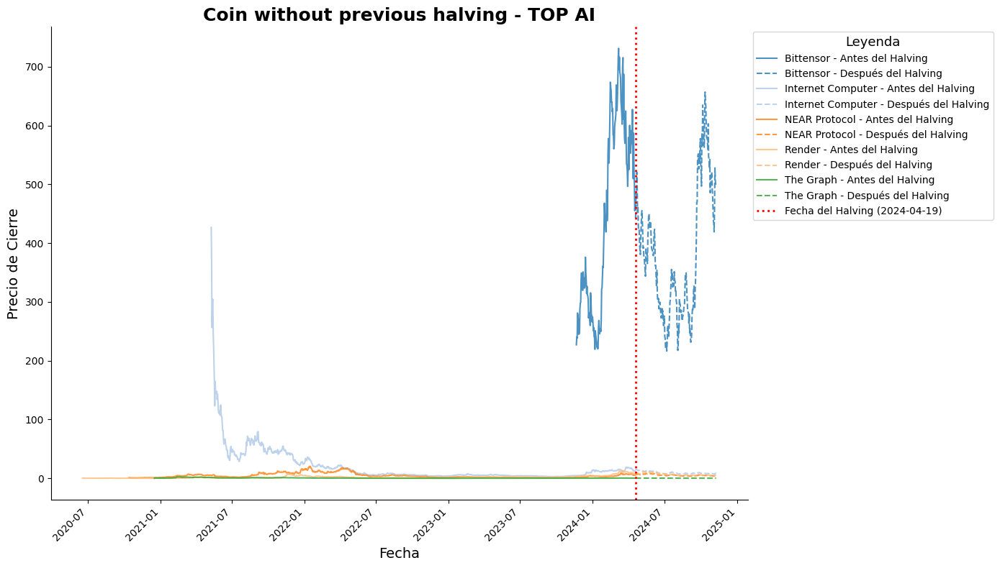

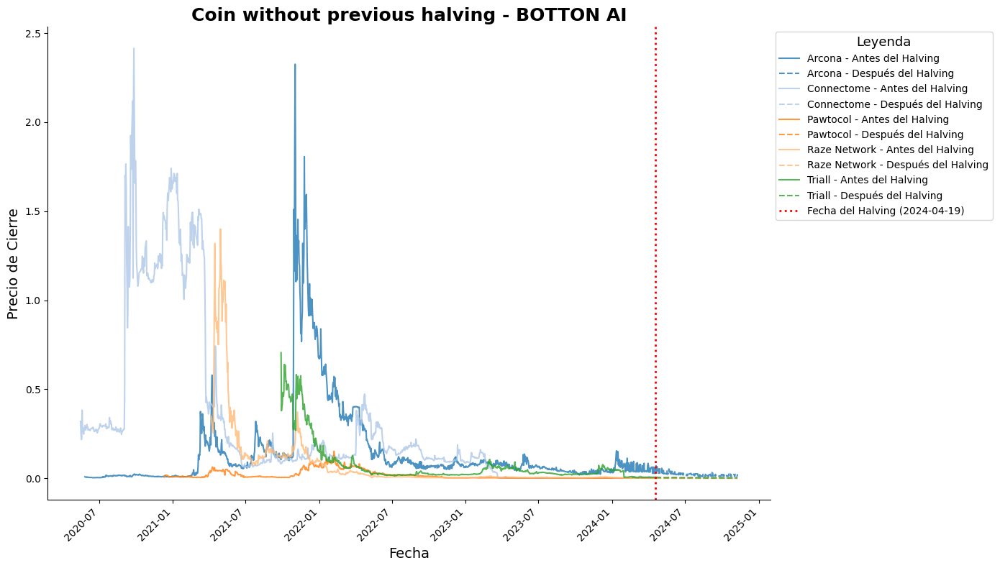

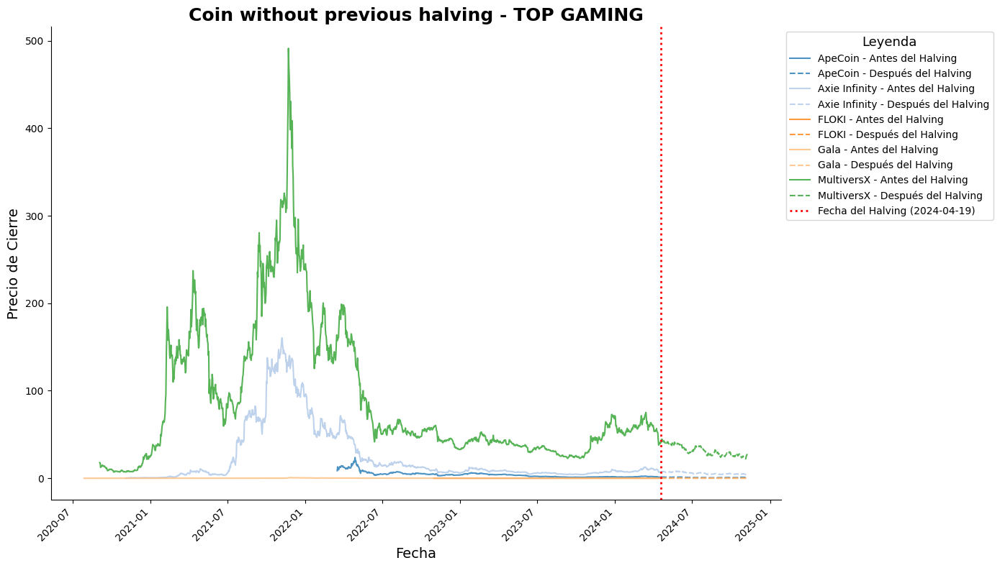

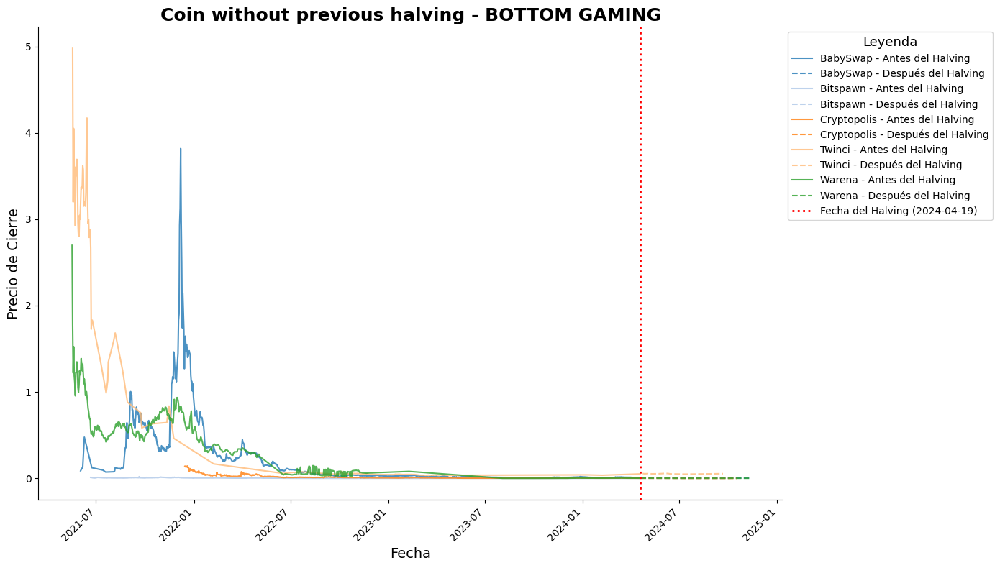

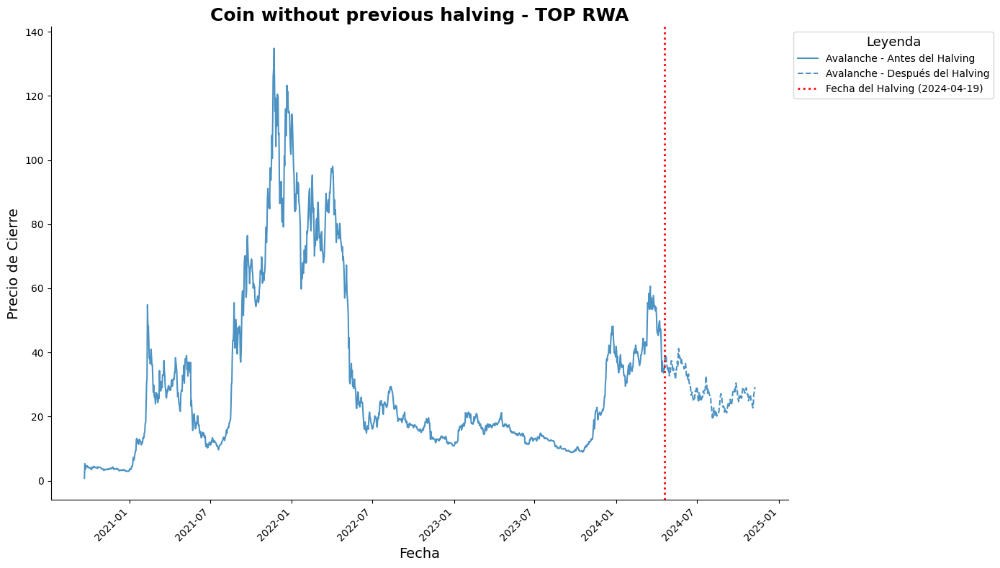

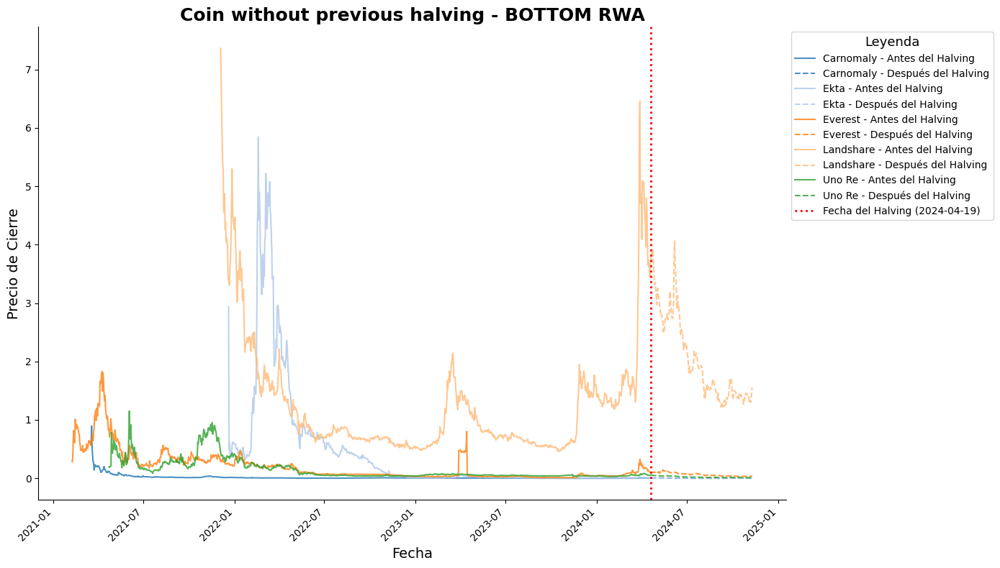

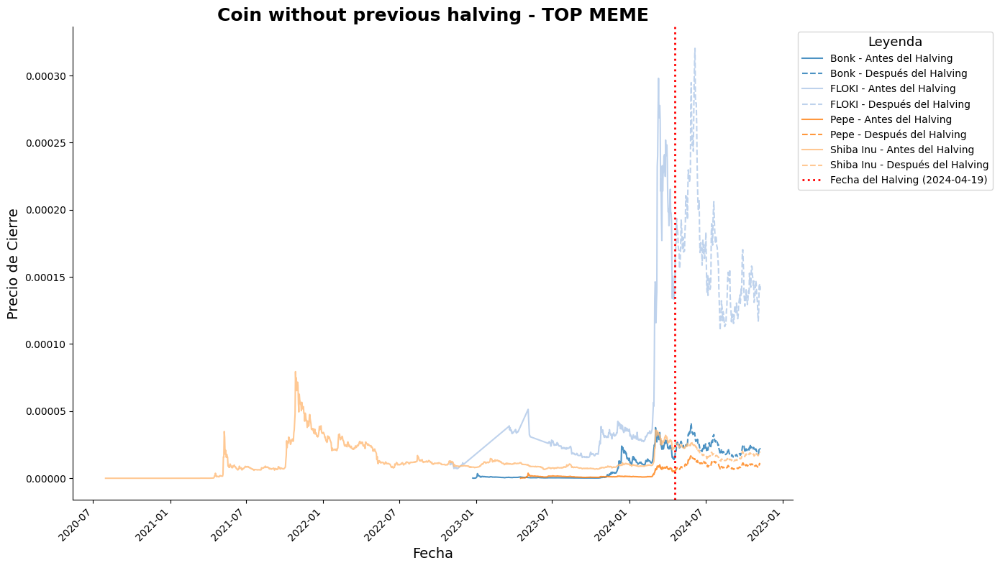

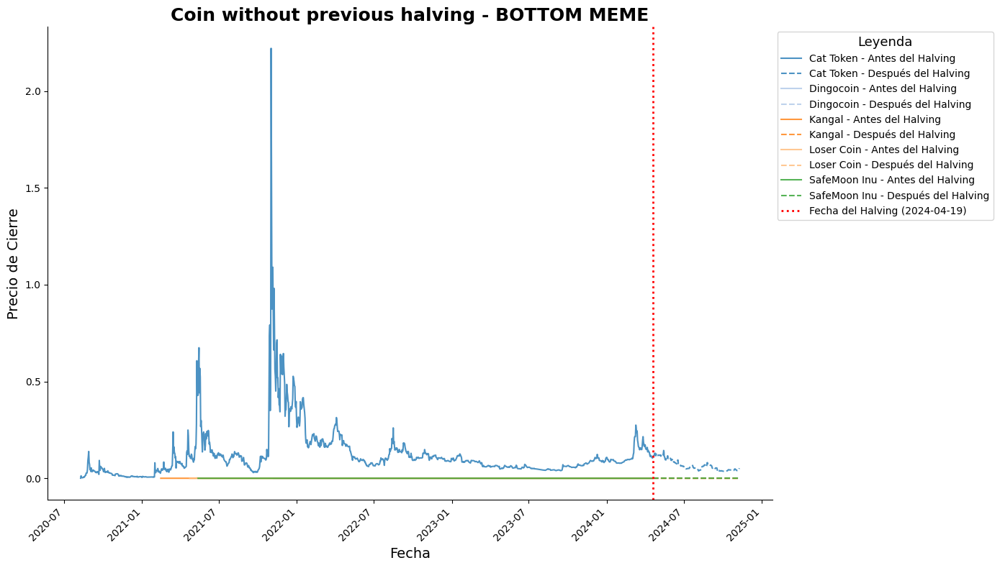

In [94]:
plot_all_historical_data_halving(df_ai_h_top, "Coin without previous halving - TOP AI")
plot_all_historical_data_halving(df_ai_h_bottom, "Coin without previous halving - BOTTON AI")
plot_all_historical_data_halving(df_gaming_h_top, "Coin without previous halving - TOP GAMING")
plot_all_historical_data_halving(df_gaming_h_bottom, "Coin without previous halving - BOTTOM GAMING")
plot_all_historical_data_halving(df_rwa_h_top, "Coin without previous halving - TOP RWA")
plot_all_historical_data_halving(df_rwa_h_bottom, "Coin without previous halving - BOTTOM RWA")
plot_all_historical_data_halving(df_meme_h_top, "Coin without previous halving - TOP MEME")
plot_all_historical_data_halving(df_meme_h_bottom, "Coin without previous halving - BOTTOM MEME")

Las gráficas presentadas reflejan cómo el precio de cierre de las criptomonedas seleccionadas se comporta antes y después del halving, lo que permite identificar patrones de impacto en distintas categorías. En el caso de las criptomonedas de inteligencia artificial (AI), las de mayor capitalización muestran un incremento notable en la volatilidad y los precios al acercarse al halving, mientras que las de menor capitalización mantienen precios más estables y con menor variación.

En la categoría gaming, las criptomonedas más relevantes presentan picos significativos antes del halving, seguidos de correcciones o estabilizaciones posteriores. Esto sugiere que los inversores tienden a especular antes del evento, generando movimientos alcistas temporales. Por otro lado, las monedas menos representativas de gaming exhiben fluctuaciones más leves, manteniéndose cerca de niveles bajos tras el halving.

Para las criptomonedas de bienes del mundo real (RWA), las más importantes muestran comportamientos similares a las de AI y gaming, con aumentos previos al halving y una leve corrección posterior. Sin embargo, las de menor relevancia mantienen precios casi planos, sin mostrar un impacto significativo asociado al evento.

Finalmente, en la categoría meme, las criptomonedas tienden a exhibir una alta volatilidad antes del halving, pero los movimientos en precios son más dispersos en comparación con las otras categorías, reflejando la naturaleza especulativa de este grupo. Las monedas menos relevantes, como Cat Token, presentan comportamientos planos, indicando poco interés del mercado en estos casos específicos.

first halving for old coins

In [95]:
def get_top_5_oldest_cryptos_with_data(df):
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    oldest_dates = df.groupby('name')['timestamp'].min().reset_index()
    oldest_dates = oldest_dates.sort_values(by='timestamp')
    top_5_oldest = oldest_dates.head(5)
    filtered_data = df[df['name'].isin(top_5_oldest['name'])]
    return filtered_data

In [96]:
df_ai_oldest_t = get_top_5_oldest_cryptos_with_data(df_ai['top'])
df_meme_oldest_t = get_top_5_oldest_cryptos_with_data(df_meme['top'])
df_rwa_oldest_t = get_top_5_oldest_cryptos_with_data(df_rwa['top'])
df_gaming_oldest_t = get_top_5_oldest_cryptos_with_data(df_gaming['top'])
df_ai_oldest_b = get_top_5_oldest_cryptos_with_data(df_ai['bottom'])
df_meme_oldest_b = get_top_5_oldest_cryptos_with_data(df_meme['bottom'])
df_rwa_oldest_b = get_top_5_oldest_cryptos_with_data(df_rwa['bottom'])
df_gaming_oldest_b = get_top_5_oldest_cryptos_with_data(df_gaming['bottom'])

In [97]:
def get_halving_date(start_date, halvings):

    for halving in halvings:
        if start_date <= halving:
            return halving
    return None

In [98]:
halving_dates = [
    pd.Timestamp('2012-11-28'),
    pd.Timestamp('2016-07-09'),
    pd.Timestamp('2020-05-11')
]

In [99]:
def filter_and_plot_first_halving(df, halvings, title):
    df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')
    df = df.dropna(subset=['timestamp', 'close'])
    oldest_dates = df.groupby('name')['timestamp'].min().reset_index()
    oldest_dates = oldest_dates[oldest_dates['timestamp'] < pd.Timestamp('2020-05-11')]
    oldest_dates['halving_date'] = oldest_dates['timestamp'].apply(lambda x: get_halving_date(x, halvings))
    valid_cryptos = oldest_dates.dropna(subset=['halving_date'])
    if len(valid_cryptos) > 1:
        global_end_date = valid_cryptos['halving_date'].max() + pd.Timedelta(days=100)
    else:
        global_end_date = valid_cryptos['halving_date'].iloc[0] + pd.Timedelta(days=100)

    print(f"Fecha límite del gráfico: {global_end_date.date()}")
    filtered_df = df[df['name'].isin(valid_cryptos['name'])]
    processed_count = 0
    relevant_halvings = valid_cryptos['halving_date'].unique()
    plt.figure(figsize=(12, 6))
    for halving_date in relevant_halvings:
        if halving_date <= global_end_date:
            plt.axvline(x=halving_date, color='red', linestyle='--', label=f'Halving: {halving_date.date()}')
    for _, row in valid_cryptos.iterrows():
        name = row['name']
        halving_date = row['halving_date']
        crypto_data = filtered_df[(filtered_df['name'] == name) & (filtered_df['timestamp'] <= global_end_date)]
        if crypto_data.empty:
            print(f"No se encontraron datos para {name} en el rango de fechas.")
            continue
        processed_count += 1
        plt.plot(crypto_data['timestamp'], crypto_data['close'], label=name)
    plt.title(title)
    plt.xlabel('Fecha')
    plt.ylabel('Precio de cierre')
    handles, labels = plt.gca().get_legend_handles_labels()
    unique_labels = dict(zip(labels, handles))
    plt.legend(unique_labels.values(), unique_labels.keys())
    plt.grid()
    plt.show()
    print(f"Total de monedas procesadas: {processed_count}/{len(valid_cryptos)}")



In [100]:
def select_top_or_bottom(df, column='marketcap', num=5, order='top'):
    if column not in df.columns:
        raise ValueError(f"La columna '{column}' no existe en el DataFrame.")
    crypto_aggregates = df.groupby('name')[column].mean().reset_index()
    if order == 'top':
        selected_cryptos = crypto_aggregates.nlargest(num, column)
    elif order == 'bottom':
        selected_cryptos = crypto_aggregates.nsmallest(num, column)
    else:
        raise ValueError("El parámetro 'order' debe ser 'top' o 'bottom'")
    filtered_df = df[df['name'].isin(selected_cryptos['name'])]
    return filtered_df
    
def get_old_cryptos(df, date_cutoff='2020-05-11'):
    df = df.copy()
    df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')
    oldest_dates = df.groupby('name')['timestamp'].min().reset_index()
    oldest_dates = oldest_dates.rename(columns={'timestamp': 'min_date'})
    filtered_oldest = oldest_dates[oldest_dates['min_date'] < pd.Timestamp(date_cutoff)]
    filtered_df = df[df['name'].isin(filtered_oldest['name'])]
    top = select_top_or_bottom(filtered_df, column='marketcap', num=5, order='top')
    botton = select_top_or_bottom(filtered_df, column='marketcap', num=5, order='bottom')
    return top, botton

In [101]:
old_ai_top, old_ai_bottom = get_old_cryptos(filtered_data_ai)
old_meme_top, old_meme_bottom = get_old_cryptos(filtered_data_meme)
old_rwa_top, old_rwa_bottom = get_old_cryptos(filtered_data_rwa)
old_gaming_top, old_gaming_bottom = get_old_cryptos(filtered_data_gaming)

Fecha límite del gráfico: 2020-08-19


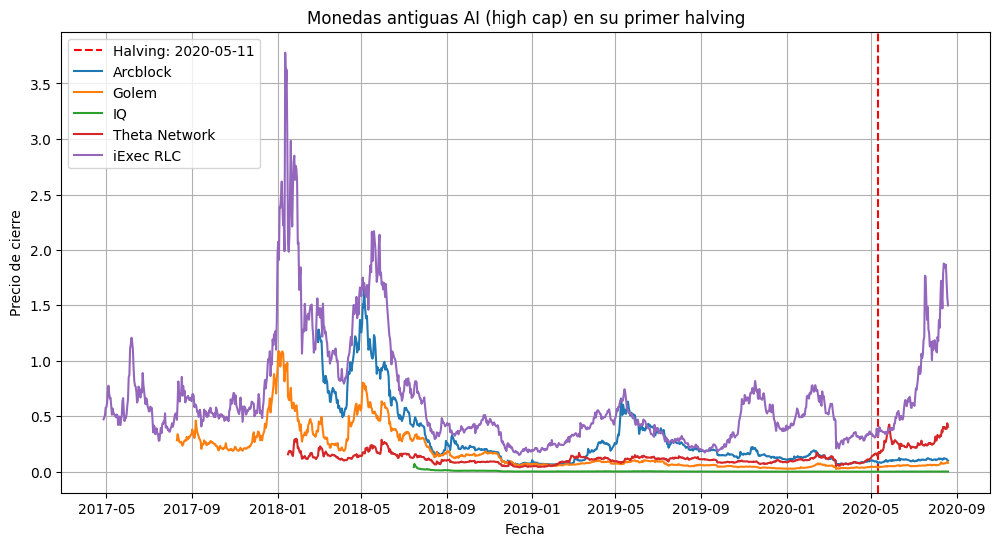

Total de monedas procesadas: 5/5
Fecha límite del gráfico: 2020-08-19


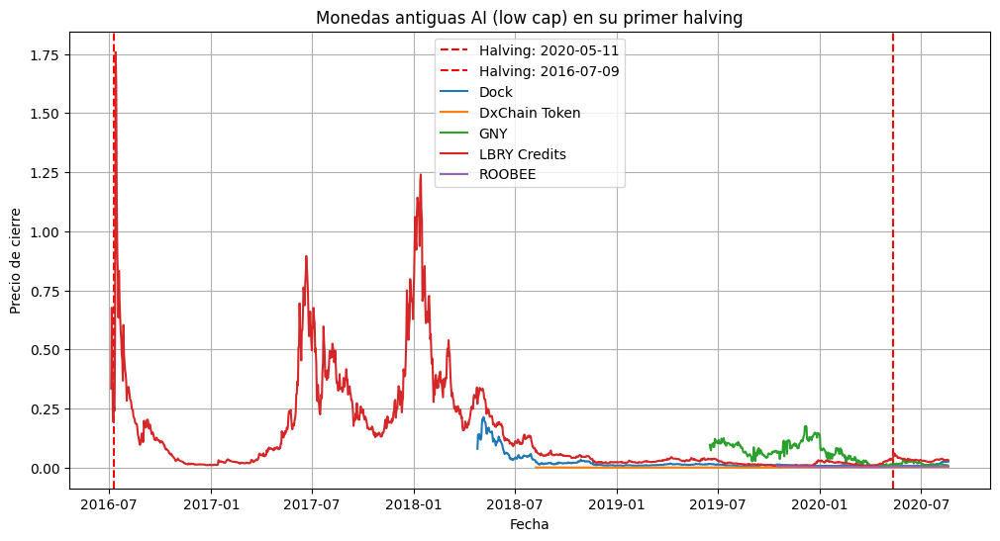

Total de monedas procesadas: 5/5
Fecha límite del gráfico: 2016-10-17


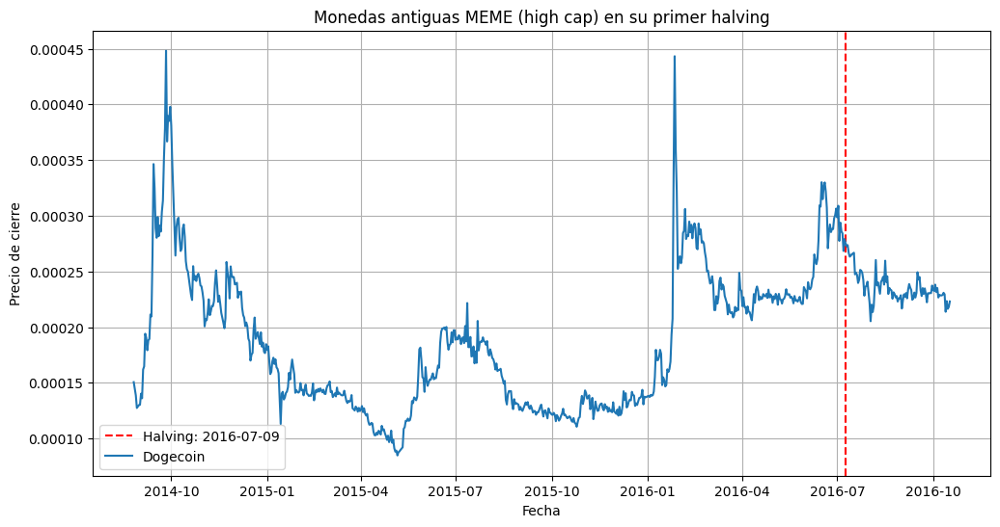

Total de monedas procesadas: 1/1
Fecha límite del gráfico: 2016-10-17


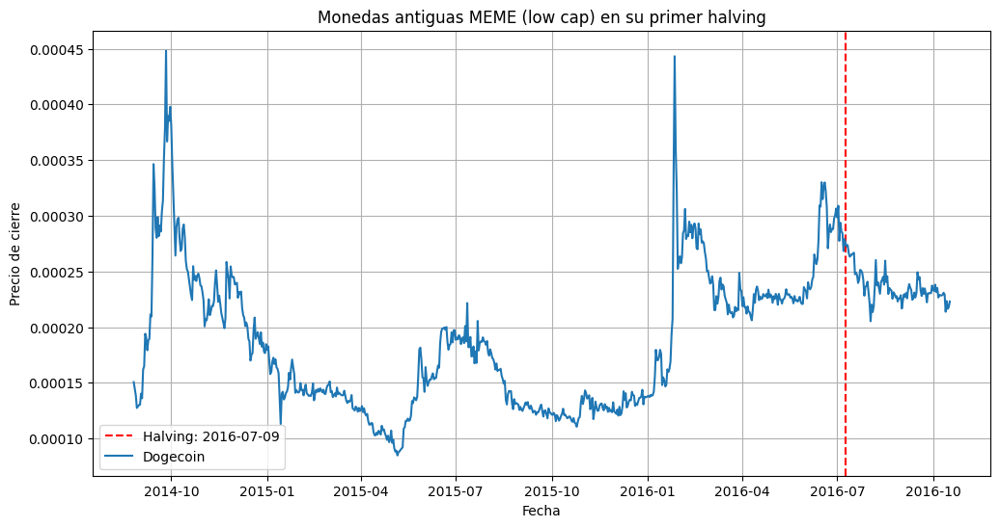

Total de monedas procesadas: 1/1
Fecha límite del gráfico: 2020-08-19


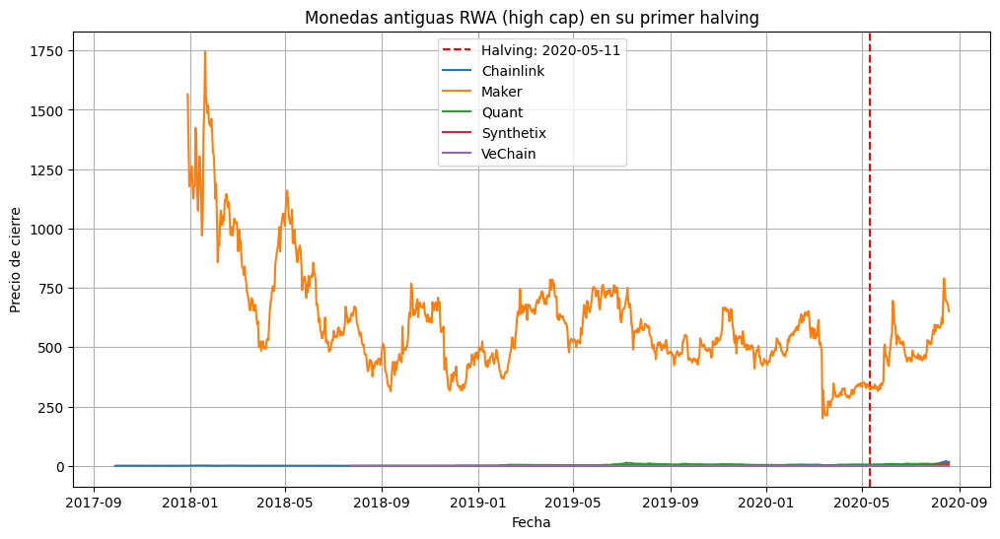

Total de monedas procesadas: 5/5
Fecha límite del gráfico: 2020-08-19


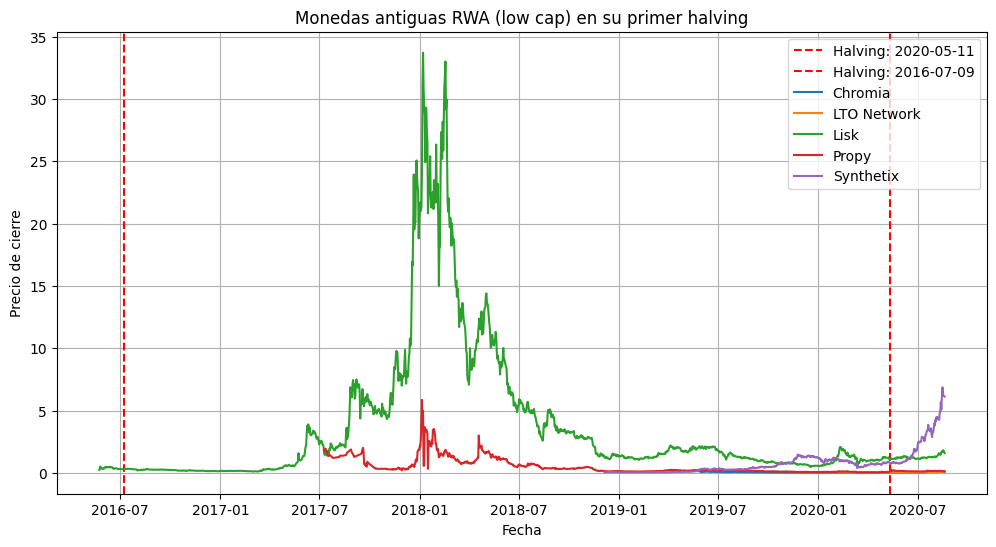

Total de monedas procesadas: 5/5
Fecha límite del gráfico: 2020-08-19


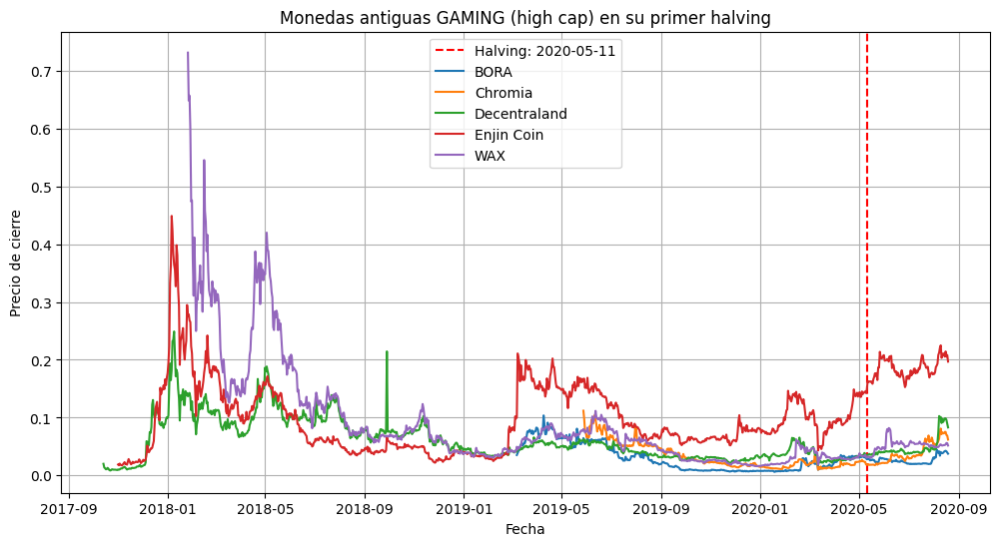

Total de monedas procesadas: 5/5
Fecha límite del gráfico: 2020-08-19


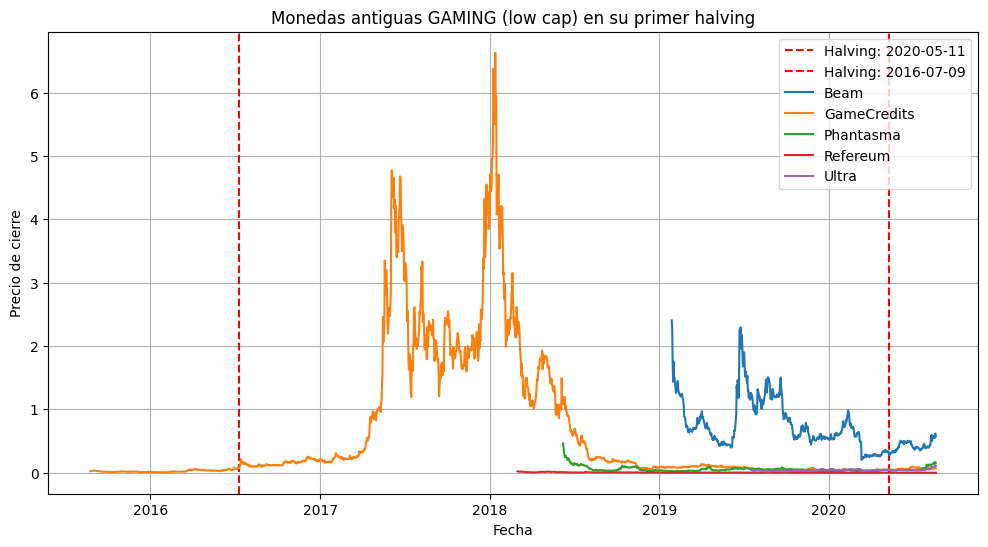

Total de monedas procesadas: 5/5


In [102]:
filter_and_plot_first_halving(old_ai_top, halving_dates, "Monedas antiguas AI (high cap) en su primer halving")
filter_and_plot_first_halving(old_ai_bottom, halving_dates, "Monedas antiguas AI (low cap) en su primer halving")
filter_and_plot_first_halving(old_meme_top, halving_dates, "Monedas antiguas MEME (high cap) en su primer halving")
filter_and_plot_first_halving(old_meme_bottom, halving_dates, "Monedas antiguas MEME (low cap) en su primer halving")
filter_and_plot_first_halving(old_rwa_top, halving_dates, "Monedas antiguas RWA (high cap) en su primer halving")
filter_and_plot_first_halving(old_rwa_bottom, halving_dates, "Monedas antiguas RWA (low cap) en su primer halving")
filter_and_plot_first_halving(old_gaming_top, halving_dates, "Monedas antiguas GAMING (high cap) en su primer halving")
filter_and_plot_first_halving(old_gaming_bottom, halving_dates, "Monedas antiguas GAMING (low cap) en su primer halving")

Las gráficas muestran cómo los precios de diversas criptomonedas han reaccionado antes y después de los eventos de halving en el tiempo. En general, se observa que el halving marca un punto crítico en la trayectoria de los precios, destacándose tanto periodos de aumento como de estabilización o disminución según la criptomoneda y su contexto.

En el caso de las monedas del sector AI, Gaming, MEME y RWA, el comportamiento varía significativamente entre las más antiguas y las más recientes. Para las criptomonedas más establecidas, como Avalanche en RWA y Dogecoin en MEME, los halvings tienden a actuar como catalizadores que preceden a incrementos importantes en su valor. Esto puede deberse al ajuste en la oferta que genera expectativas de mayor escasez, impulsando la demanda.

Por otro lado, en criptomonedas más recientes o con menor adopción, como BabySwap o Cat Token, se aprecia una respuesta más moderada al halving, con fluctuaciones en el precio pero sin una tendencia de crecimiento sostenido. Esto sugiere que factores adicionales como la liquidez, el desarrollo del ecosistema y la confianza de los inversores juegan un papel más relevante que el evento de halving en sí.

En criptomonedas históricas como Theta Network y GameCredits, que abarcan varios ciclos de halving, se evidencia una mayor madurez en los patrones de precios. Los picos suelen estar asociados no solo al halving, sino también a otros eventos externos que potencian su valor en momentos específicos. En contraste, monedas más recientes y menos consolidadas experimentan un crecimiento más errático, donde los halvings no parecen tener un impacto predecible.